# Importing Libraries

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
from sklearn.ensemble import RandomForestRegressor

from sklearn import metrics
from sklearn.metrics import r2_score
from sklearn.model_selection import train_test_split
from sklearn.metrics import auc, accuracy_score, confusion_matrix, mean_squared_error
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline
import datetime

In [ ]:
plt.rc("font", size=12)
sns.set(rc={"figure.dpi":300, 'savefig.dpi':300})
sns.set_palette("Set2")
sns.set_style("white")
sns.set_style("ticks")
pd.set_option("display.max_columns", None)

# Importing Data

In [ ]:
registration = pd.read_excel(r"/content/drive/MyDrive/Colab Notebooks/VOCPA Port/Final_Combined.xlsx","Registration")
pb_detention = pd.read_excel(r"/content/drive/MyDrive/Colab Notebooks/VOCPA Port/Final_Combined.xlsx","PB_Detention")
idle = pd.read_excel(r"/content/drive/MyDrive/Colab Notebooks/VOCPA Port/Final_Combined.xlsx","Idle_Timings")
performance = pd.read_excel(r"/content/drive/MyDrive/Colab Notebooks/VOCPA Port/Final_Combined.xlsx","Performance")
operation = pd.read_excel(r"/content/drive/MyDrive/Colab Notebooks/VOCPA Port/Final_Combined.xlsx","Operation_Handling")


In [ ]:
berth = pd.read_csv(r"/content/drive/MyDrive/Colab Notebooks/VOCPA Port/berth_specs.csv")
logfile = pd.read_excel(r"/content/drive/MyDrive/Colab Notebooks/VOCPA Port/logfile.xlsx")

In [ ]:
# logfile['EQUIP_CODE'].unique()

In [ ]:
# pivot_cranes.sort_values(['Non_HMC'],ascending=False)

In [ ]:
# #Hours completed
# def count_hours(vessel_no, date, berth):
#     # Load the data from the table into a pandas DataFrame
#     date = date.to_datetime
#     df = logfile

#     # Filter the DataFrame based on the vessel number, date, and berth
#     filtered_df = df[(df['VESSEL_NO'] == vessel_no) & (df['LOGSHEET_DATE'] == date) & (df['BERTH'] == berth)]

#     # Calculate the total number of hours completed by the vessel
#     total_hours = filtered_df['QTY_MT'].sum()
#     print(filtered_df)
#     # Return the total number of hours
#     return total_hours

In [ ]:
# count_hours('20-21/1147',4/13/2021,'11(CBW)')

In [ ]:
# def remaining_hours(vessel_no, completed_hours):


In [ ]:
# def hours_rem_per_berth(date,berth):
#   df = logfile
#   filtered_df = df[df['BERTH']==berth & df['LOGSHEET_DATE']==date]
#   print(filtered_df)

In [ ]:
# hours_rem_per_berth('4/13/2021','11(CBW)')

# Working with necessary columns

In [ ]:
registration = registration.drop(['BALLAST_CARGO_BC','CREW','PARTY_CD','MAX_CALINV_AMD_NUMBER',"ORIGIN/DESTINATION", "CALINV_VCN",'REDUCED_GRT_MT','IMO_NUMBER',"VESSEL_NAME","VESSEL_TYPE","LAST_PORT","EXPECTED_DEPARTURE_DATE","CARGO_DESC","CALL_SIGN","NEXT_PORT_CALL","ANCHORAGE_DT","VOYAGE_NUMBER","SV_AGENT","BERTHING_DATE","CAPT","IW_PLT_BOARD_DT","IW_PLT_BERTH_DT","ZONE_ID","ASSESSMENT_DT","SAILED_DT","AGENT_NAME","REG_DT","COUNTRY_CODE","COUNTRY_NAME","LINE_CODE","LINE_AGENT_NM","ANC_DIRECT_BERTH_DT","DIRECT_BERTH","PRELIM_ASST_DT","REG_PORT","PURPOSE_OF_VISIT","SV_CODE","CARGO_CD"], axis=1)

In [ ]:
registration.columns

Index(['VESSEL_NO', 'C/B/DB/DC/L', 'O/C', 'MT_MV', 'STATUS_FOREIGN_COASTAL',
       'GRT_MT', 'NRT_MT', 'DWT_MT', 'LOA_METER', 'EXPECTED_ARRIVAL_DATE',
       'CARGO_TONNAGE', 'BEAM_METER', 'VESSEL_TYPENM', 'DRAFT_FWD',
       'DRAFT_AFT', 'BERTHING_BERTH_CODE', 'ASSESSED', 'REALISED',
       'SHIP_OPERATION_TYPE', 'PRIORITY', 'REQ_BERTH_CODE'],
      dtype='object')

In [ ]:
# num_unique_values = registration["PURPOSE_OF_VISIT"].nunique()
# registration["PURPOSE_OF_VISIT"].unique()

In [ ]:
pb_detention.columns

Index(['VESSEL_NO', 'VESSEL_NAME', 'BERTH', 'ANCHORAGE_DT', 'START_TIME',
       'END_TIME', 'DETENTION_HRS', 'REASON', 'PORT_ACCOUNT_YN'],
      dtype='object')

In [ ]:
pb_detention = pb_detention.drop(["VESSEL_NAME","START_TIME"], axis=1)

In [ ]:
idle.columns

Index(['VESSEL_NO', 'VESSEL_NAME', 'LOG_DATE', 'SAILED_DT', 'SHIFT', 'BERTH',
       'IDLE_REASON', 'IDLETIME', 'IDLE_MINS', 'REASON_CODE',
       'PRE_POST_DURING'],
      dtype='object')

In [ ]:
idle = idle.drop(['VESSEL_NAME', 'SAILED_DT','IDLETIME', 'REASON_CODE','PRE_POST_DURING'],axis=1)

In [ ]:
idle['IDLE_MINS']=idle['IDLE_MINS']/60
idle = idle.rename(columns={'IDLE_MINS': 'IDLE_HRS'})

In [ ]:
idle = idle[idle['BERTH'] != 'ZBB']

In [ ]:
idle

,VESSEL_NO,LOG_DATE,SHIFT,BERTH,IDLE_REASON,IDLE_HRS
0,20-21/1060,2021-04-01,1,14(CJI),Stoppage Of Work By Agent,8.000000
1,20-21/1060,2021-04-01,2,14(CJI),Stoppage Of Work By Agent,8.000000
2,20-21/1060,2021-04-01,3,14(CJI),Stoppage Of Work By Agent,8.000000
3,20-21/1060,2021-04-02,1,14(CJI),Stoppage Of Work By Agent,8.000000
4,20-21/1060,2021-04-02,2,14(CJI),Stoppage Of Work By Agent,8.000000
...,...,...,...,...,...,...
16661,21-22/1235,2022-03-30,1,9,Preparation-Pre,0.166667
16662,21-22/1235,2022-03-31,1,9,Documentation/Survey Post,1.000000
16663,21-22/1235,2022-03-31,2,9,Documentation/Survey Post,1.000000
16664,21-22/1235,2022-03-31,2,9,Preparation For Sailing,0.416667


In [ ]:
performance.columns

Index(['VCN', 'Vessel Name', 'Sailing Time', 'Norms', 'Berthing Time',
       'Vacation Time', 'Berth', 'Cargo', 'Quantity', 'Total Berthed Hrs',
       'Idle Hrs', 'Berth Hours in particular berth',
       'Service Hours in particular berth'],
      dtype='object')

In [ ]:
performance.rename(columns = {'VCN':'VESSEL_NO'}, inplace = True)

In [ ]:
performance = performance.drop(['Vessel Name','Sailing Time'],axis=1)

In [ ]:
berth_dummies = pd.get_dummies(performance['Berth'])
performance_Berths = pd.concat([performance, berth_dummies],axis = 1)
performance_Berths = performance_Berths.drop('Berth', axis = 1)
performance_Berths =  performance_Berths.groupby('VESSEL_NO').sum().reset_index()

<ipython-input-26-9d9783902c5a>:4: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  performance_Berths =  performance_Berths.groupby('VESSEL_NO').sum().reset_index()


In [ ]:
performance_Berths = performance_Berths.drop(['Norms','Quantity',"Total Berthed Hrs","Idle Hrs",'Berth Hours in particular berth','Service Hours in particular berth'],axis=1)

In [ ]:
performance_Berths

,VESSEL_NO,1,2,3,4,5,6,7,8,9,11(CBW),13(NCBI),14(CJI),15(OJ),16(CJII),17(EARM)
0,20-21/1060,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0
1,20-21/1088,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0
2,20-21/1090,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0
3,20-21/1101,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0
4,20-21/1138,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1129,21-22/1212,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0
1130,21-22/1217,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0
1131,21-22/1220,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0
1132,21-22/1222,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0


In [ ]:
operation=operation.drop(['Vessel Name'],axis=1)

In [ ]:
operation

,Vessel No,Date,Cargo,Cargo Category,Berth,Equipment,Tonnage
0,21-22/0030,2021-04-14,COAL FOR OTHER THAN THERMAL POWER PLANTS,Dry Bulk,9,HMC-1,6623.000
1,20-21/1170,2021-04-14,Wind Mill Blade and Accessories,Dry Bulk,3,HMC-1,23.260
2,20-21/1170,2021-04-19,Wind Mill Blade,Dry Bulk,3,HMC-2,86.440
3,20-21/1170,2021-04-18,Wind Mill Blade and Accessories,Dry Bulk,3,HMC-1,17.445
4,20-21/1170,2021-04-19,Wind Mill Blade and Accessories,Dry Bulk,3,HMC-1,29.108
...,...,...,...,...,...,...,...
1121,21-22/1017,2022-01-26,COAL FOR OTHER THAN THERMAL POWER PLANTS,Dry Bulk,9,HMC-3,16805.000
1122,21-22/1177,2022-03-17,LIME STONES,Dry Bulk,9,HMC-2,4032.000
1123,21-22/1131,2022-03-05,COAL FOR OTHER THAN THERMAL POWER PLANTS,Dry Bulk,9,HMC-1,11395.000
1124,21-22/1131,2022-03-05,COAL FOR OTHER THAN THERMAL POWER PLANTS,Dry Bulk,9,HMC-3,18517.000


In [ ]:
performance

,VESSEL_NO,Norms,Berthing Time,Vacation Time,Berth,Cargo,Quantity,Total Berthed Hrs,Idle Hrs,Berth Hours in particular berth,Service Hours in particular berth
0,20-21/1060,1363,2021-03-05 12:30:00,2021-04-08 13:30:00,5,CONSTRUCTION MATERIALS-STONE ROUGH,5500.000,817.000000,41.58,101.333333,59.753333
1,20-21/1060,1363,2021-03-05 12:30:00,2021-04-08 13:30:00,11(CBW),CONSTRUCTION MATERIALS-STONE ROUGH,7000.000,817.000000,26.50,119.500000,93.000000
2,20-21/1088,3000,2021-03-07 12:42:00,2021-07-07 19:00:00,1,FURNACE OIL,7999.977,2934.300000,13.15,75.400000,62.250000
3,20-21/1090,1363,2021-03-24 08:10:00,2021-04-02 07:30:00,11(CBW),CONSTRUCTION MATERIALS-STONE ROUGH,6500.000,215.333333,105.92,215.333333,109.413333
4,20-21/1101,1363,2021-03-29 17:00:00,2021-04-02 11:30:00,5,CONSTRUCTION MATERIALS-STONE ROUGH,7350.000,90.500000,23.50,90.500000,67.000000
...,...,...,...,...,...,...,...,...,...,...,...
1355,21-22/1212,15000,2022-03-25 18:40:00,2022-03-29 07:35:00,16(CJII),COAL HANDLED THROUGH CONVEYOR,26341.000,84.916667,9.25,56.250000,47.000000
1356,21-22/1217,2500,2022-03-27 23:06:00,2022-03-28 23:24:00,8,Container,51954.010,24.300000,0.00,24.300000,24.300000
1357,21-22/1220,2500,2022-03-27 08:32:00,2022-03-29 23:55:00,13(NCBI),COAL HANDLED AT NCB,72875.000,63.383333,4.39,63.383333,58.993333
1358,21-22/1222,2500,2022-03-29 00:36:00,2022-03-29 20:55:00,8,Container,46576.700,20.316667,0.00,20.316667,20.316667


In [ ]:
# pd.set_option("display.max_columns", None)

## Changing into date and time

In [ ]:
#changing into date and time
# registration['BERTHING_DATE']= pd.to_datetime(registration['BERTHING_DATE'])
registration['EXPECTED_ARRIVAL_DATE']= pd.to_datetime(registration['EXPECTED_ARRIVAL_DATE'])
pb_detention['ANCHORAGE_DT'] = pd.to_datetime(pb_detention['ANCHORAGE_DT'])
idle['LOG_DATE'] = pd.to_datetime(idle['LOG_DATE'])
performance['Berthing Time'] = pd.to_datetime(performance['Berthing Time'])
performance['Vacation Time'] = pd.to_datetime(performance['Vacation Time'])
operation['Date']=pd.to_datetime(operation['Date'])
logfile['LOGSHEET_DATE']=pd.to_datetime(logfile['LOGSHEET_DATE'])

##Crazy Log File

In [ ]:
logfile.head()

,VCN,SAILING_TIME,CARGO_CD_DESC,CARGO_CATEGORY,QTY_MT,LOGSHEET_DATE,BERTH,SHIFT,IE,SLNO,EQUIP_CODE
0,20-21/1060,2021-04-08 13:40:00,CONSTRUCTION MATERIALS-STONE ROUGH,Dry Bulk,350.0,2021-04-03,11(CBW),2,E,1,NaN
1,20-21/1060,2021-04-08 13:40:00,CONSTRUCTION MATERIALS-STONE ROUGH,Dry Bulk,750.0,2021-04-03,11(CBW),3,E,1,NaN
2,20-21/1060,2021-04-08 13:40:00,CONSTRUCTION MATERIALS-STONE ROUGH,Dry Bulk,400.0,2021-04-04,11(CBW),1,E,1,NaN
3,20-21/1060,2021-04-08 13:40:00,CONSTRUCTION MATERIALS-STONE ROUGH,Dry Bulk,500.0,2021-04-04,11(CBW),2,E,1,NaN
4,20-21/1060,2021-04-08 13:40:00,CONSTRUCTION MATERIALS-STONE ROUGH,Dry Bulk,400.0,2021-04-04,11(CBW),3,E,1,NaN


In [ ]:
# Sort the data frame by start time
logfile2 = logfile.sort_values(by='LOGSHEET_DATE')

logfile2 = logfile2.reset_index(drop=True)

In [ ]:
pivot_qty_norms = pd.pivot_table(performance, index="VESSEL_NO",values=["Quantity",'Norms'], aggfunc={"Quantity":"sum",'Norms':'mean'})

In [ ]:
logfile2 = logfile2.rename(columns={'VCN': 'VESSEL_NO'})

In [ ]:
logfile2 = pd.merge(logfile2, pivot_qty_norms[['Quantity','Norms']], on='VESSEL_NO',how='left')

In [ ]:
# Calculate the cumulative sum of completed quantity for each VESSEL_NO
logfile2['Cumulative Completed Quantity'] = logfile2.groupby('VESSEL_NO')['QTY_MT'].cumsum()

# Calculate the fraction of cumulative completed quantity by dividing it by total quantity
logfile2['Cumulative Completed Quantity Fraction'] = logfile2['Cumulative Completed Quantity'] / logfile2['Quantity']


In [ ]:
logfile2['Cumulative_quantity_norms'] = (1-logfile2['Cumulative Completed Quantity Fraction'])*logfile2['Quantity']/logfile2['Norms']

In [ ]:
logfile2['BERTH']=logfile2['BERTH'].astype(str)

In [ ]:
registration['BERTHING_BERTH_CODE']=registration['BERTHING_BERTH_CODE'].astype(str)

In [ ]:
registration.head()

,VESSEL_NO,C/B/DB/DC/L,O/C,MT_MV,STATUS_FOREIGN_COASTAL,GRT_MT,NRT_MT,DWT_MT,LOA_METER,EXPECTED_ARRIVAL_DATE,CARGO_TONNAGE,BEAM_METER,VESSEL_TYPENM,DRAFT_FWD,DRAFT_AFT,BERTHING_BERTH_CODE,ASSESSED,REALISED,SHIP_OPERATION_TYPE,PRIORITY,REQ_BERTH_CODE
0,20-21/1170,B,O,MV,F,12802.0,3841.0,7023.2,140.55,2021-04-04 18:44:00,1616.00,24.00,BULK CARRIER,4.80,4.80,14(CJI),Yes,Yes,Export,,3
1,20-21/1171,B,O,MV,F,33057.0,19229.0,56451.1,189.99,2021-04-04 20:00:00,912.00,32.26,BREAK BULK CARGO VESSEL,6.75,8.25,6,Yes,Yes,Export,,6
2,21-22/0001,B,O,MV,F,20471.0,10630.0,27402.0,178.80,2021-04-08 08:00:00,164.37,27.20,GENERAL CARGO VESSELS,9.65,9.87,4,Yes,Yes,Import,,6
3,21-22/0002,B,O,MV,F,16794.0,10492.0,28426.0,169.03,2021-04-05 10:00:00,4657.00,27.20,BREAK BULK CARGO VESSEL,9.70,10.30,3,Yes,Yes,Import,,3
4,21-22/0006,B,O,MV,F,19495.0,10622.0,33345.0,171.60,2021-04-06 14:50:00,5554.00,27.00,BULK CARRIER,10.50,10.95,4,Yes,Yes,Import,,3


In [ ]:
def congestion_quantity_norms(Vessel_no,datea,berth):
  # datea = datea.date()
  # print(datea)
  filtered_logfile2 = logfile2[(logfile2['LOGSHEET_DATE'] == datea) & (logfile2['BERTH'] == berth)]
  # print(filtered_logfile2)
  asdf = filtered_logfile2[filtered_logfile2.duplicated(subset=['VESSEL_NO'])==False]
  # Check if the resulting dataframe is empty
  if asdf.empty:
      return 0
  else:
      return asdf['Cumulative_quantity_norms'].values[0]

In [ ]:
for i in range(1,len(registration)+1):
    Vessel_no = registration['VESSEL_NO'][i]
    datea = registration['EXPECTED_ARRIVAL_DATE'][i]
    berth = registration['BERTHING_BERTH_CODE'][i]

    # Call the congestion_quantity_norms() function and store the result in a variable
    congestion_value = congestion_quantity_norms(Vessel_no, datea, berth)

    print(congestion_value)

In [ ]:
# Create an empty list to store the congestion values
congestion_values = []
# Iterate through each row in the registration dataset
for i in range(1,len(registration)+1):
    Vessel_no = registration['VESSEL_NO'][i]
    datea = registration['EXPECTED_ARRIVAL_DATE'][i]
    berth = registration['BERTHING_BERTH_CODE'][i]

    # Call the congestion_quantity_norms() function and store the result in a variable
    congestion_value = congestion_quantity_norms(Vessel_no, datea, berth)

    # Append the congestion_value to the list of congestion values
    congestion_values.append(congestion_value)
# print(congestion_values)
# Convert the list of congestion values to a Series and append it as a new column to the registration dataset
registration['congestion_fromLog'] = pd.Series(congestion_values, index=registration.index)

In [ ]:
# registration.drop(['congestion_value'], axis=1,inplace=True)

In [ ]:
# logfile2

In [ ]:
# registration[['VESSEL_NO','EXPECTED_ARRIVAL_DATE','BERTHING_BERTH_CODE','congestion_fromLog']]

In [ ]:
# Compare the data types of the two columns
# if logfile2['LOGSHEET_DATE'].dtype == registration.EXPECTED_ARRIVAL_DATE.dtype:
#     print("The data types of column1 and column2 are the same.")
# else:
#     print("The data types of column1 and column2 are different.")

The data types of column1 and column2 are the same.


In [ ]:
# logfile['CR'] = logfile['Cranes'].apply(lambda x: 'CR' in str(x))

# pivot_cranes2 = pd.pivot_table(logfile, index = "VESSEL_NO" , values=["CR"], aggfunc={'CR':"sum"},fill_value =0)

## Combining Different Sheets

In [ ]:
# files = ['registration', 'pb_detention','idle','performance','operation']

In [ ]:
# df = []
# df.append(registration)
# df.append(pb_detention)
# df.append(idle)
# df.append(performance)
# df.append(operation)

In [ ]:
# for i in range(len(df)):
#     print(files[i])
#     print(df[i].columns)

# Pivot Tables

In [ ]:
idle.head()

,VESSEL_NO,LOG_DATE,SHIFT,BERTH,IDLE_REASON,IDLE_HRS
0,20-21/1060,2021-04-01,1,14(CJI),Stoppage Of Work By Agent,8.0
1,20-21/1060,2021-04-01,2,14(CJI),Stoppage Of Work By Agent,8.0
2,20-21/1060,2021-04-01,3,14(CJI),Stoppage Of Work By Agent,8.0
3,20-21/1060,2021-04-02,1,14(CJI),Stoppage Of Work By Agent,8.0
4,20-21/1060,2021-04-02,2,14(CJI),Stoppage Of Work By Agent,8.0


Pre-Berthing Detention

In [ ]:
# Create a  dictionary to map each equipment code to its type
equipment_types = {"CR-10-01": "CR", "CR-6-01": "CR","CR-20-G1": "CR", "CR-20-G2": "CR", "CR-20-G3": "CR", "HMC-1": "HMC", "HMC-2": "HMC", "HMC-3": "HMC"}

# Create a new column with the equipment type for each row
logfile["Cranes"] = logfile["EQUIP_CODE"].map(equipment_types)

logfile['Cranes'].fillna(0,inplace=True)

logfile = logfile.rename(columns={'VCN': 'VESSEL_NO'})

logfile['CR'] = logfile['Cranes'].apply(lambda x: 'CR' in str(x))

pivot_cranes2 = pd.pivot_table(logfile, index = "VESSEL_NO" , values=["CR"], aggfunc={'CR':"sum"},fill_value =0)

pivot_cranes2['Non_HMC'] = (pivot_cranes2['CR'] != 0).astype(int)

In [ ]:
pivot_cranes2=pivot_cranes2.reset_index(level=0)

In [ ]:
pivot_cranes2.columns

Index(['VESSEL_NO', 'CR', 'Non_HMC'], dtype='object')

In [ ]:
# Sort the data frame by start time
pb_detention = pb_detention.sort_values(by='ANCHORAGE_DT')

pb_detention = pb_detention.reset_index(drop=True)

In [ ]:
# Create an empty list to store the congestion values
congestion = []

# Loop through each row in the data frame
for i, row in pb_detention.iterrows():
    # Find all containers whose loading has not yet finished when the current container starts loading
    congested_vessels = pb_detention[(pb_detention['END_TIME'] >= row['ANCHORAGE_DT']) & (pb_detention.index < i) & (row['BERTH']==pb_detention['BERTH'])]
    # Append the count of congested containers to the congestion list
    congestion.append(len(congested_vessels))

# Add the congestion column to the data frame
pb_detention['Congestion'] = congestion

In [ ]:
pivot_pb_detention = pd.pivot_table(pb_detention, index="VESSEL_NO",values=["ANCHORAGE_DT","DETENTION_HRS",'Congestion'], aggfunc={'ANCHORAGE_DT':"min","DETENTION_HRS":"sum",'Congestion':"max"})

In [ ]:
pivot_pb_detention

,ANCHORAGE_DT,Congestion,DETENTION_HRS
VESSEL_NO,,,
20-21/1138,2021-04-12 15:15:00,1,16
20-21/1139,2021-04-12 15:15:00,0,16
20-21/1169,2021-04-02 07:30:00,0,28
20-21/1170,2021-04-05 10:30:00,0,34
20-21/1174,2021-04-03 04:42:00,0,3
...,...,...,...
21-22/1223,2022-03-28 19:12:00,0,13
21-22/1224,2022-03-26 19:00:00,0,68
21-22/1228,2022-03-31 13:35:00,1,10


Idle

In [ ]:
pivot_idle = pd.pivot_table(idle, index="VESSEL_NO",values=["LOG_DATE","IDLE_HRS"], aggfunc={'LOG_DATE':"min","IDLE_HRS":"sum"})

In [ ]:
pivot_idle

,IDLE_HRS,LOG_DATE
VESSEL_NO,,
20-21/1060,82.000000,2021-04-01
20-21/1088,34.816667,2021-05-28
20-21/1090,15.250000,2021-04-01
20-21/1101,10.500000,2021-04-01
20-21/1138,24.583333,2021-04-13
...,...,...
21-22/1212,11.700000,2022-03-25
21-22/1220,4.383333,2022-03-27
21-22/1221,52.000000,2022-03-27


Performance

In [ ]:
performance["Quantity_Norms"]=performance["Quantity"]/performance["Norms"]

In [ ]:
pivot_performance = pd.pivot_table(performance, index="VESSEL_NO",values=["Berth","Berthing Time","Quantity_Norms","Total Berthed Hrs","Idle Hrs","Berth Hours in particular berth","Service Hours in particular berth"], aggfunc={"Berth":"first","Berthing Time":"min","Quantity_Norms":"sum","Total Berthed Hrs":"mean","Idle Hrs":"sum","Berth Hours in particular berth":"sum","Service Hours in particular berth":"sum"})

#Feature Development

Expected number of Vessels

In [ ]:
#Expected number of vessels

# Get the count of vessels expected on the same date
registration['Congestion_Vessels_Expected'] = registration.groupby('EXPECTED_ARRIVAL_DATE')['VESSEL_NO'].transform('count')

In [ ]:
performance['month'] = performance['Berthing Time'].dt.month
registration['month'] = registration['EXPECTED_ARRIVAL_DATE'].dt.month

Berth Specs

In [ ]:
berth

,Berth,Berth_Quay length,Berth_Permissible,Berth_Draught,Berth_DWT
0,1,168.0,183,9.30,25000
1,2,168.0,183,9.30,40000
2,3,192.0,245,11.50,50000
3,4,192.0,245,11.50,50000
4,5,168.0,183,8.60,40000
5,6,168.0,200,9.30,40000
6,7,370.0,270,11.70,50000
7,8,345.0,310,14.20,93000
8,9,334.5,235,14.20,93000
9,11(CBW),318.0,225,13.00,65000


In [ ]:
berth.columns

Index(['Berth', 'Berth_Quay length', 'Berth_Permissible', 'Berth_Draught',
       'Berth_DWT'],
      dtype='object')

In [ ]:
# berth = berth.rename(columns={'Berth': 'REQ_BERTH_CODE'})
berth.rename(columns = {'Berth':'REQ_BERTH_CODE'}, inplace = True)

In [ ]:
# berth.set_index('Berth', inplace=True)

In [ ]:
berth.dtypes

REQ_BERTH_CODE        object
Berth_Quay length    float64
Berth_Permissible      int64
Berth_Draught        float64
Berth_DWT              int64
dtype: object

In [ ]:
berth['REQ_BERTH_CODE'] = berth['REQ_BERTH_CODE'].astype(str)

In [ ]:
registration['REQ_BERTH_CODE'] = registration['REQ_BERTH_CODE'].astype(str)

In [ ]:
registration.REQ_BERTH_CODE.dtype

dtype('O')

In [ ]:
registration = pd.merge(registration,
                     berth,
                     on ='REQ_BERTH_CODE',
                     how ='left')

In [ ]:
registration.head()

,VESSEL_NO,C/B/DB/DC/L,O/C,MT_MV,STATUS_FOREIGN_COASTAL,GRT_MT,NRT_MT,DWT_MT,LOA_METER,EXPECTED_ARRIVAL_DATE,CARGO_TONNAGE,BEAM_METER,VESSEL_TYPENM,DRAFT_FWD,DRAFT_AFT,BERTHING_BERTH_CODE,ASSESSED,REALISED,SHIP_OPERATION_TYPE,PRIORITY,REQ_BERTH_CODE,Congestion_Vessels_Expected,month,Berth_Quay length,Berth_Permissible,Berth_Draught,Berth_DWT
0,20-21/1170,B,O,MV,F,12802.0,3841.0,7023.2,140.55,2021-04-04 18:44:00,1616.00,24.00,BULK CARRIER,4.80,4.80,14(CJI),Yes,Yes,Export,,3,1.0,4.0,192.0,245.0,11.5,50000.0
1,20-21/1171,B,O,MV,F,33057.0,19229.0,56451.1,189.99,2021-04-04 20:00:00,912.00,32.26,BREAK BULK CARGO VESSEL,6.75,8.25,6,Yes,Yes,Export,,6,1.0,4.0,168.0,200.0,9.3,40000.0
2,21-22/0001,B,O,MV,F,20471.0,10630.0,27402.0,178.80,2021-04-08 08:00:00,164.37,27.20,GENERAL CARGO VESSELS,9.65,9.87,4,Yes,Yes,Import,,6,1.0,4.0,168.0,200.0,9.3,40000.0
3,21-22/0002,B,O,MV,F,16794.0,10492.0,28426.0,169.03,2021-04-05 10:00:00,4657.00,27.20,BREAK BULK CARGO VESSEL,9.70,10.30,3,Yes,Yes,Import,,3,1.0,4.0,192.0,245.0,11.5,50000.0
4,21-22/0006,B,O,MV,F,19495.0,10622.0,33345.0,171.60,2021-04-06 14:50:00,5554.00,27.00,BULK CARRIER,10.50,10.95,4,Yes,Yes,Import,,3,1.0,4.0,192.0,245.0,11.5,50000.0


Circular Month

In [ ]:


registration['month_sin'] = np.sin(2 * np.pi * registration['month']/12)
registration['month_cos'] = np.cos(2 * np.pi * registration['month']/12)

HMC Cranes

In [ ]:
operation

,Vessel No,Date,Cargo,Cargo Category,Berth,Equipment,Tonnage
0,21-22/0030,2021-04-14,COAL FOR OTHER THAN THERMAL POWER PLANTS,Dry Bulk,9,HMC-1,6623.000
1,20-21/1170,2021-04-14,Wind Mill Blade and Accessories,Dry Bulk,3,HMC-1,23.260
2,20-21/1170,2021-04-19,Wind Mill Blade,Dry Bulk,3,HMC-2,86.440
3,20-21/1170,2021-04-18,Wind Mill Blade and Accessories,Dry Bulk,3,HMC-1,17.445
4,20-21/1170,2021-04-19,Wind Mill Blade and Accessories,Dry Bulk,3,HMC-1,29.108
...,...,...,...,...,...,...,...
1121,21-22/1017,2022-01-26,COAL FOR OTHER THAN THERMAL POWER PLANTS,Dry Bulk,9,HMC-3,16805.000
1122,21-22/1177,2022-03-17,LIME STONES,Dry Bulk,9,HMC-2,4032.000
1123,21-22/1131,2022-03-05,COAL FOR OTHER THAN THERMAL POWER PLANTS,Dry Bulk,9,HMC-1,11395.000
1124,21-22/1131,2022-03-05,COAL FOR OTHER THAN THERMAL POWER PLANTS,Dry Bulk,9,HMC-3,18517.000


In [ ]:
operation_temp=operation[['Vessel No','Equipment','Tonnage']]

# Pivot the table to encode Equipment column
pivot_cranes = pd.pivot_table(operation_temp, index='Vessel No', columns='Equipment', values='Tonnage', aggfunc='count', fill_value=0)

# Rename columns
pivot_cranes.columns = [col.replace('HMC-', 'HMC_') for col in pivot_cranes.columns]

# Reset index
pivot_cranes = pivot_cranes.reset_index()

pivot_cranes = pd.DataFrame(pivot_cranes)
pivot_cranes.rename(columns = {'Vessel No':'VESSEL_NO'}, inplace = True)
pivot_cranes




,VESSEL_NO,HMC_1,HMC_2,HMC_3
0,20-21/1167,2,2,2
1,20-21/1170,8,8,0
2,21-22/0004,1,1,1
3,21-22/0015,8,8,0
4,21-22/0016,4,5,5
...,...,...,...,...
162,21-22/1177,4,3,4
163,21-22/1188,3,3,3
164,21-22/1201,2,3,3
165,21-22/1202,0,0,2


In [ ]:
# col_names_a = pivot_cranes.columns
# col_names_a['Vessel No'] = 'VESSEL_NO'
# pivot_cranes.columns = col_names_a

In [ ]:
pivot_cranes

,VESSEL_NO,HMC_1,HMC_2,HMC_3
0,20-21/1167,2,2,2
1,20-21/1170,8,8,0
2,21-22/0004,1,1,1
3,21-22/0015,8,8,0
4,21-22/0016,4,5,5
...,...,...,...,...
162,21-22/1177,4,3,4
163,21-22/1188,3,3,3
164,21-22/1201,2,3,3
165,21-22/1202,0,0,2


In [ ]:
pivot_cranes.columns

Index(['VESSEL_NO', 'HMC_1', 'HMC_2', 'HMC_3'], dtype='object')

In [ ]:
pb_detention

,VESSEL_NO,BERTH,ANCHORAGE_DT,END_TIME,DETENTION_HRS,REASON,PORT_ACCOUNT_YN,Congestion
0,20-21/1169,8,2021-04-02 07:30:00,2021-04-03 11:10:00,28,Agents Option,N,0
1,20-21/1176,5,2021-04-02 08:00:00,2021-04-02 13:25:00,5,Vessel Not Ready,N,0
2,20-21/1175,5,2021-04-02 08:00:00,2021-04-02 12:35:00,5,Vessel Not Ready,N,1
3,20-21/1174,13(NCBI),2021-04-03 04:42:00,2021-04-03 07:40:00,3,Vessel Not Ready,N,0
4,20-21/1170,14(CJI),2021-04-05 10:30:00,2021-04-06 20:02:00,34,Vessel Not Ready,N,0
...,...,...,...,...,...,...,...,...
578,21-22/1235,9,2022-03-29 14:18:00,2022-03-30 04:00:00,14,Non-Availability Of Working Berth As The Berth...,Y,0
579,21-22/1236,6,2022-03-31 13:12:00,2022-03-31 20:00:00,3,Other Vessel Movements,N,0
580,21-22/1236,6,2022-03-31 13:12:00,2022-03-31 17:05:00,4,Vessel Not Ready,N,1
581,21-22/1228,5,2022-03-31 13:35:00,2022-03-31 23:30:00,6,Non-Availability Of Working Berth As The Berth...,Y,0


# Port Limit Variables

In [ ]:
registration.sort_values(by='VESSEL_NO', ascending=True, inplace=True)
registration

,VESSEL_NO,C/B/DB/DC/L,O/C,MT_MV,STATUS_FOREIGN_COASTAL,GRT_MT,NRT_MT,DWT_MT,LOA_METER,EXPECTED_ARRIVAL_DATE,CARGO_TONNAGE,BEAM_METER,VESSEL_TYPENM,DRAFT_FWD,DRAFT_AFT,BERTHING_BERTH_CODE,ASSESSED,REALISED,SHIP_OPERATION_TYPE,PRIORITY,REQ_BERTH_CODE,Congestion_Vessels_Expected,month,Berth_Quay length,Berth_Permissible,Berth_Draught,Berth_DWT,month_sin,month_cos
944,20-21/1060,BARGE,O,MV,F,5248.0,1574.0,2258.0,111.25,2021-02-27 08:00:00,12500.0,28.04,BREAK BULK CARGO VESSEL,1.00,1.20,5,Yes,Yes,Export,,5,1.0,2.0,168.0,183.0,8.60,40000.0,0.866025,5.000000e-01
1132,20-21/1088,LB,O,MT,F,22184.0,9431.0,34671.0,171.10,2021-03-07 00:00:00,7999.0,27.40,OIL AND OTHER DERIVATIVES TANKER,8.00,8.00,1,No,Yes,Import,,6,1.0,3.0,168.0,200.0,9.30,40000.0,1.000000,6.123234e-17
945,20-21/1090,BARGE,O,MV,F,2985.0,896.0,7200.0,87.78,2021-03-20 10:00:00,7000.0,24.38,BARGE,1.00,1.20,11(CBW),Yes,Yes,Export,,11(CBW),1.0,3.0,318.0,225.0,13.00,65000.0,1.000000,6.123234e-17
946,20-21/1101,BARGE,O,MV,F,3147.0,944.0,7498.0,87.86,2021-03-29 08:00:00,7200.0,24.40,BARGE CARRIER/LASH SHIP,1.40,1.40,5,Yes,Yes,Export,,11(CBW),1.0,3.0,318.0,225.0,13.00,65000.0,1.000000,6.123234e-17
947,20-21/1138,BARGE,O,MV,F,3138.0,941.0,7200.0,87.84,2021-04-03 08:00:00,7200.0,24.40,BARGE CARRIER/LASH SHIP,1.40,1.40,11(CBW),Yes,Yes,Export,,11(CBW),1.0,4.0,318.0,225.0,13.00,65000.0,0.866025,-5.000000e-01
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
698,21-22/1212,DM,C,MV,F,30811.0,18205.0,55709.0,189.90,2022-03-25 10:00:00,52726.0,32.26,BREAK BULK CARGO VESSEL,12.30,12.30,13(NCBI),Yes,Yes,Import,,16(CJII),2.0,3.0,140.0,120.0,5.85,6000.0,1.000000,6.123234e-17
522,21-22/1217,C,O,MV,F,15929.0,9227.0,22026.0,167.95,2022-03-25 10:00:00,19000.0,26.70,CARRIER GENERAL CARGO/CONTAINER,10.50,10.00,8,Yes,Yes,Both,,8,2.0,3.0,345.0,310.0,14.20,93000.0,1.000000,6.123234e-17
699,21-22/1220,DM,C,MV,F,38938.0,24972.0,74193.0,224.89,2022-03-26 23:55:00,72875.0,32.20,BREAK BULK CARGO VESSEL,14.00,14.00,13(NCBI),Yes,Yes,Import,,13(NCBI),1.0,3.0,306.0,245.0,14.00,80000.0,1.000000,6.123234e-17
523,21-22/1222,C,O,MV,F,15095.0,6453.0,18585.0,168.80,2022-03-26 22:00:00,14000.0,27.30,FULL CONTAINER SHIP/CELLULAR VESSEL,6.00,7.00,8,No,Yes,Both,,8,1.0,3.0,345.0,310.0,14.20,93000.0,1.000000,6.123234e-17


Merging files to get all columns in a single dataframe

In [ ]:
merge1 = pd.merge(registration, pivot_performance[["Berth",'Quantity_Norms','Total Berthed Hrs', 'Idle Hrs','Service Hours in particular berth']], on='VESSEL_NO',how='left')

In [ ]:
merge1.head()

,VESSEL_NO,C/B/DB/DC/L,O/C,MT_MV,STATUS_FOREIGN_COASTAL,GRT_MT,NRT_MT,DWT_MT,LOA_METER,EXPECTED_ARRIVAL_DATE,CARGO_TONNAGE,BEAM_METER,VESSEL_TYPENM,DRAFT_FWD,DRAFT_AFT,BERTHING_BERTH_CODE,ASSESSED,REALISED,SHIP_OPERATION_TYPE,PRIORITY,REQ_BERTH_CODE,Congestion_Vessels_Expected,month,Berth_Quay length,Berth_Permissible,Berth_Draught,Berth_DWT,month_sin,month_cos,Berth,Quantity_Norms,Total Berthed Hrs,Idle Hrs,Service Hours in particular berth
0,20-21/1060,BARGE,O,MV,F,5248.0,1574.0,2258.0,111.25,2021-02-27 08:00:00,12500.0,28.04,BREAK BULK CARGO VESSEL,1.0,1.2,5,Yes,Yes,Export,,5,1.0,2.0,168.0,183.0,8.6,40000.0,0.866025,5.000000e-01,5,9.170946,817.000000,68.08,152.753333
1,20-21/1088,LB,O,MT,F,22184.0,9431.0,34671.0,171.10,2021-03-07 00:00:00,7999.0,27.40,OIL AND OTHER DERIVATIVES TANKER,8.0,8.0,1,No,Yes,Import,,6,1.0,3.0,168.0,200.0,9.3,40000.0,1.000000,6.123234e-17,1,2.666659,2934.300000,13.15,62.250000
2,20-21/1090,BARGE,O,MV,F,2985.0,896.0,7200.0,87.78,2021-03-20 10:00:00,7000.0,24.38,BARGE,1.0,1.2,11(CBW),Yes,Yes,Export,,11(CBW),1.0,3.0,318.0,225.0,13.0,65000.0,1.000000,6.123234e-17,11(CBW),4.768892,215.333333,105.92,109.413333
3,20-21/1101,BARGE,O,MV,F,3147.0,944.0,7498.0,87.86,2021-03-29 08:00:00,7200.0,24.40,BARGE CARRIER/LASH SHIP,1.4,1.4,5,Yes,Yes,Export,,11(CBW),1.0,3.0,318.0,225.0,13.0,65000.0,1.000000,6.123234e-17,5,5.392517,90.500000,23.50,67.000000
4,20-21/1138,BARGE,O,MV,F,3138.0,941.0,7200.0,87.84,2021-04-03 08:00:00,7200.0,24.40,BARGE CARRIER/LASH SHIP,1.4,1.4,11(CBW),Yes,Yes,Export,,11(CBW),1.0,4.0,318.0,225.0,13.0,65000.0,0.866025,-5.000000e-01,11(CBW),5.282465,99.083333,24.58,74.503333


In [ ]:
merge2=pd.merge(merge1,pivot_pb_detention[['DETENTION_HRS','Congestion']],on='VESSEL_NO',how='left')

In [ ]:
merge2.head()

,VESSEL_NO,C/B/DB/DC/L,O/C,MT_MV,STATUS_FOREIGN_COASTAL,GRT_MT,NRT_MT,DWT_MT,LOA_METER,EXPECTED_ARRIVAL_DATE,CARGO_TONNAGE,BEAM_METER,VESSEL_TYPENM,DRAFT_FWD,DRAFT_AFT,BERTHING_BERTH_CODE,ASSESSED,REALISED,SHIP_OPERATION_TYPE,PRIORITY,REQ_BERTH_CODE,Congestion_Vessels_Expected,month,Berth_Quay length,Berth_Permissible,Berth_Draught,Berth_DWT,month_sin,month_cos,Berth,Quantity_Norms,Total Berthed Hrs,Idle Hrs,Service Hours in particular berth,DETENTION_HRS,Congestion
0,20-21/1060,BARGE,O,MV,F,5248.0,1574.0,2258.0,111.25,2021-02-27 08:00:00,12500.0,28.04,BREAK BULK CARGO VESSEL,1.0,1.2,5,Yes,Yes,Export,,5,1.0,2.0,168.0,183.0,8.6,40000.0,0.866025,5.000000e-01,5,9.170946,817.000000,68.08,152.753333,NaN,NaN
1,20-21/1088,LB,O,MT,F,22184.0,9431.0,34671.0,171.10,2021-03-07 00:00:00,7999.0,27.40,OIL AND OTHER DERIVATIVES TANKER,8.0,8.0,1,No,Yes,Import,,6,1.0,3.0,168.0,200.0,9.3,40000.0,1.000000,6.123234e-17,1,2.666659,2934.300000,13.15,62.250000,NaN,NaN
2,20-21/1090,BARGE,O,MV,F,2985.0,896.0,7200.0,87.78,2021-03-20 10:00:00,7000.0,24.38,BARGE,1.0,1.2,11(CBW),Yes,Yes,Export,,11(CBW),1.0,3.0,318.0,225.0,13.0,65000.0,1.000000,6.123234e-17,11(CBW),4.768892,215.333333,105.92,109.413333,NaN,NaN
3,20-21/1101,BARGE,O,MV,F,3147.0,944.0,7498.0,87.86,2021-03-29 08:00:00,7200.0,24.40,BARGE CARRIER/LASH SHIP,1.4,1.4,5,Yes,Yes,Export,,11(CBW),1.0,3.0,318.0,225.0,13.0,65000.0,1.000000,6.123234e-17,5,5.392517,90.500000,23.50,67.000000,NaN,NaN
4,20-21/1138,BARGE,O,MV,F,3138.0,941.0,7200.0,87.84,2021-04-03 08:00:00,7200.0,24.40,BARGE CARRIER/LASH SHIP,1.4,1.4,11(CBW),Yes,Yes,Export,,11(CBW),1.0,4.0,318.0,225.0,13.0,65000.0,0.866025,-5.000000e-01,11(CBW),5.282465,99.083333,24.58,74.503333,16.0,1.0


In [ ]:
merge3=pd.merge(merge2,pivot_idle['IDLE_HRS'],on='VESSEL_NO',how='left')

In [ ]:
merge3.head()

,VESSEL_NO,C/B/DB/DC/L,O/C,MT_MV,STATUS_FOREIGN_COASTAL,GRT_MT,NRT_MT,DWT_MT,LOA_METER,EXPECTED_ARRIVAL_DATE,CARGO_TONNAGE,BEAM_METER,VESSEL_TYPENM,DRAFT_FWD,DRAFT_AFT,BERTHING_BERTH_CODE,ASSESSED,REALISED,SHIP_OPERATION_TYPE,PRIORITY,REQ_BERTH_CODE,Congestion_Vessels_Expected,month,Berth_Quay length,Berth_Permissible,Berth_Draught,Berth_DWT,month_sin,month_cos,Berth,Quantity_Norms,Total Berthed Hrs,Idle Hrs,Service Hours in particular berth,DETENTION_HRS,Congestion,IDLE_HRS
0,20-21/1060,BARGE,O,MV,F,5248.0,1574.0,2258.0,111.25,2021-02-27 08:00:00,12500.0,28.04,BREAK BULK CARGO VESSEL,1.0,1.2,5,Yes,Yes,Export,,5,1.0,2.0,168.0,183.0,8.6,40000.0,0.866025,5.000000e-01,5,9.170946,817.000000,68.08,152.753333,NaN,NaN,82.000000
1,20-21/1088,LB,O,MT,F,22184.0,9431.0,34671.0,171.10,2021-03-07 00:00:00,7999.0,27.40,OIL AND OTHER DERIVATIVES TANKER,8.0,8.0,1,No,Yes,Import,,6,1.0,3.0,168.0,200.0,9.3,40000.0,1.000000,6.123234e-17,1,2.666659,2934.300000,13.15,62.250000,NaN,NaN,34.816667
2,20-21/1090,BARGE,O,MV,F,2985.0,896.0,7200.0,87.78,2021-03-20 10:00:00,7000.0,24.38,BARGE,1.0,1.2,11(CBW),Yes,Yes,Export,,11(CBW),1.0,3.0,318.0,225.0,13.0,65000.0,1.000000,6.123234e-17,11(CBW),4.768892,215.333333,105.92,109.413333,NaN,NaN,15.250000
3,20-21/1101,BARGE,O,MV,F,3147.0,944.0,7498.0,87.86,2021-03-29 08:00:00,7200.0,24.40,BARGE CARRIER/LASH SHIP,1.4,1.4,5,Yes,Yes,Export,,11(CBW),1.0,3.0,318.0,225.0,13.0,65000.0,1.000000,6.123234e-17,5,5.392517,90.500000,23.50,67.000000,NaN,NaN,10.500000
4,20-21/1138,BARGE,O,MV,F,3138.0,941.0,7200.0,87.84,2021-04-03 08:00:00,7200.0,24.40,BARGE CARRIER/LASH SHIP,1.4,1.4,11(CBW),Yes,Yes,Export,,11(CBW),1.0,4.0,318.0,225.0,13.0,65000.0,0.866025,-5.000000e-01,11(CBW),5.282465,99.083333,24.58,74.503333,16.0,1.0,24.583333


In [ ]:
merge4=pd.merge(merge3, pivot_cranes, left_on = 'VESSEL_NO', right_on = 'VESSEL_NO', how = 'left')

In [ ]:
merge4.head()

,VESSEL_NO,C/B/DB/DC/L,O/C,MT_MV,STATUS_FOREIGN_COASTAL,GRT_MT,NRT_MT,DWT_MT,LOA_METER,EXPECTED_ARRIVAL_DATE,CARGO_TONNAGE,BEAM_METER,VESSEL_TYPENM,DRAFT_FWD,DRAFT_AFT,BERTHING_BERTH_CODE,ASSESSED,REALISED,SHIP_OPERATION_TYPE,PRIORITY,REQ_BERTH_CODE,Congestion_Vessels_Expected,month,Berth_Quay length,Berth_Permissible,Berth_Draught,Berth_DWT,month_sin,month_cos,Berth,Quantity_Norms,Total Berthed Hrs,Idle Hrs,Service Hours in particular berth,DETENTION_HRS,Congestion,IDLE_HRS,HMC_1,HMC_2,HMC_3
0,20-21/1060,BARGE,O,MV,F,5248.0,1574.0,2258.0,111.25,2021-02-27 08:00:00,12500.0,28.04,BREAK BULK CARGO VESSEL,1.0,1.2,5,Yes,Yes,Export,,5,1.0,2.0,168.0,183.0,8.6,40000.0,0.866025,5.000000e-01,5,9.170946,817.000000,68.08,152.753333,NaN,NaN,82.000000,NaN,NaN,NaN
1,20-21/1088,LB,O,MT,F,22184.0,9431.0,34671.0,171.10,2021-03-07 00:00:00,7999.0,27.40,OIL AND OTHER DERIVATIVES TANKER,8.0,8.0,1,No,Yes,Import,,6,1.0,3.0,168.0,200.0,9.3,40000.0,1.000000,6.123234e-17,1,2.666659,2934.300000,13.15,62.250000,NaN,NaN,34.816667,NaN,NaN,NaN
2,20-21/1090,BARGE,O,MV,F,2985.0,896.0,7200.0,87.78,2021-03-20 10:00:00,7000.0,24.38,BARGE,1.0,1.2,11(CBW),Yes,Yes,Export,,11(CBW),1.0,3.0,318.0,225.0,13.0,65000.0,1.000000,6.123234e-17,11(CBW),4.768892,215.333333,105.92,109.413333,NaN,NaN,15.250000,NaN,NaN,NaN
3,20-21/1101,BARGE,O,MV,F,3147.0,944.0,7498.0,87.86,2021-03-29 08:00:00,7200.0,24.40,BARGE CARRIER/LASH SHIP,1.4,1.4,5,Yes,Yes,Export,,11(CBW),1.0,3.0,318.0,225.0,13.0,65000.0,1.000000,6.123234e-17,5,5.392517,90.500000,23.50,67.000000,NaN,NaN,10.500000,NaN,NaN,NaN
4,20-21/1138,BARGE,O,MV,F,3138.0,941.0,7200.0,87.84,2021-04-03 08:00:00,7200.0,24.40,BARGE CARRIER/LASH SHIP,1.4,1.4,11(CBW),Yes,Yes,Export,,11(CBW),1.0,4.0,318.0,225.0,13.0,65000.0,0.866025,-5.000000e-01,11(CBW),5.282465,99.083333,24.58,74.503333,16.0,1.0,24.583333,NaN,NaN,NaN


In [ ]:
merge4=pd.merge(merge4, pivot_cranes2[['VESSEL_NO','Non_HMC']], left_on = 'VESSEL_NO', right_on = 'VESSEL_NO', how = 'left')

In [ ]:
# merge4=pd.merge(merge3, pivot_cranes[['HMC_1','HMC_2','HMC_3']],on='VESSEL_NO',how='left')

In [ ]:
# Columns = merge3.columns

In [ ]:
merge4.columns

Index(['VESSEL_NO', 'C/B/DB/DC/L', 'O/C', 'MT_MV', 'STATUS_FOREIGN_COASTAL',
       'GRT_MT', 'NRT_MT', 'DWT_MT', 'LOA_METER', 'EXPECTED_ARRIVAL_DATE',
       'CARGO_TONNAGE', 'BEAM_METER', 'VESSEL_TYPENM', 'DRAFT_FWD',
       'DRAFT_AFT', 'BERTHING_BERTH_CODE', 'ASSESSED', 'REALISED',
       'SHIP_OPERATION_TYPE', 'PRIORITY', 'REQ_BERTH_CODE',
       'Congestion_Vessels_Expected', 'month', 'Berth_Quay length',
       'Berth_Permissible', 'Berth_Draught', 'Berth_DWT', 'month_sin',
       'month_cos', 'Berth', 'Quantity_Norms', 'Total Berthed Hrs', 'Idle Hrs',
       'Service Hours in particular berth', 'DETENTION_HRS', 'Congestion',
       'IDLE_HRS', 'HMC_1', 'HMC_2', 'HMC_3', 'Non_HMC'],
      dtype='object')

In [ ]:
merge4[merge4[['VESSEL_NO', 'C/B/DB/DC/L', 'O/C', 'MT_MV', 'STATUS_FOREIGN_COASTAL',
       'GRT_MT', 'NRT_MT', 'DWT_MT', 'LOA_METER', 'EXPECTED_ARRIVAL_DATE',
       'CARGO_TONNAGE', 'BEAM_METER', 'VESSEL_TYPENM', 'DRAFT_FWD',
       'DRAFT_AFT', 'BERTHING_BERTH_CODE', 'ASSESSED', 'REALISED',
       'SHIP_OPERATION_TYPE', 'PRIORITY', 'REQ_BERTH_CODE',
       'Congestion_Vessels_Expected', 'month', 'Berth_Quay length',
       'Berth_Permissible', 'Berth_Draught', 'Berth_DWT', 'month_sin',
       'month_cos', 'Berth', 'Quantity_Norms', 'Total Berthed Hrs', 'Idle Hrs',
       'Service Hours in particular berth', 'DETENTION_HRS', 'IDLE_HRS',
       'HMC_1', 'HMC_2', 'HMC_3','Non_HMC','Congestion']].isnull().any(axis=1)]

,VESSEL_NO,C/B/DB/DC/L,O/C,MT_MV,STATUS_FOREIGN_COASTAL,GRT_MT,NRT_MT,DWT_MT,LOA_METER,EXPECTED_ARRIVAL_DATE,CARGO_TONNAGE,BEAM_METER,VESSEL_TYPENM,DRAFT_FWD,DRAFT_AFT,BERTHING_BERTH_CODE,ASSESSED,REALISED,SHIP_OPERATION_TYPE,PRIORITY,REQ_BERTH_CODE,Congestion_Vessels_Expected,month,Berth_Quay length,Berth_Permissible,Berth_Draught,Berth_DWT,month_sin,month_cos,Berth,Quantity_Norms,Total Berthed Hrs,Idle Hrs,Service Hours in particular berth,DETENTION_HRS,Congestion,IDLE_HRS,HMC_1,HMC_2,HMC_3,Non_HMC
0,20-21/1060,BARGE,O,MV,F,5248.0,1574.0,2258.0,111.25,2021-02-27 08:00:00,12500.0,28.04,BREAK BULK CARGO VESSEL,1.0,1.2,5,Yes,Yes,Export,,5,1.0,2.0,168.0,183.0,8.60,40000.0,0.866025,5.000000e-01,5,9.170946,817.000000,68.08,152.753333,NaN,NaN,82.000000,NaN,NaN,NaN,0.0
1,20-21/1088,LB,O,MT,F,22184.0,9431.0,34671.0,171.10,2021-03-07 00:00:00,7999.0,27.40,OIL AND OTHER DERIVATIVES TANKER,8.0,8.0,1,No,Yes,Import,,6,1.0,3.0,168.0,200.0,9.30,40000.0,1.000000,6.123234e-17,1,2.666659,2934.300000,13.15,62.250000,NaN,NaN,34.816667,NaN,NaN,NaN,NaN
2,20-21/1090,BARGE,O,MV,F,2985.0,896.0,7200.0,87.78,2021-03-20 10:00:00,7000.0,24.38,BARGE,1.0,1.2,11(CBW),Yes,Yes,Export,,11(CBW),1.0,3.0,318.0,225.0,13.00,65000.0,1.000000,6.123234e-17,11(CBW),4.768892,215.333333,105.92,109.413333,NaN,NaN,15.250000,NaN,NaN,NaN,0.0
3,20-21/1101,BARGE,O,MV,F,3147.0,944.0,7498.0,87.86,2021-03-29 08:00:00,7200.0,24.40,BARGE CARRIER/LASH SHIP,1.4,1.4,5,Yes,Yes,Export,,11(CBW),1.0,3.0,318.0,225.0,13.00,65000.0,1.000000,6.123234e-17,5,5.392517,90.500000,23.50,67.000000,NaN,NaN,10.500000,NaN,NaN,NaN,0.0
4,20-21/1138,BARGE,O,MV,F,3138.0,941.0,7200.0,87.84,2021-04-03 08:00:00,7200.0,24.40,BARGE CARRIER/LASH SHIP,1.4,1.4,11(CBW),Yes,Yes,Export,,11(CBW),1.0,4.0,318.0,225.0,13.00,65000.0,0.866025,-5.000000e-01,11(CBW),5.282465,99.083333,24.58,74.503333,16.0,1.0,24.583333,NaN,NaN,NaN,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1128,21-22/1210,C,O,MV,F,15095.0,6453.0,18585.0,168.80,2022-03-23 22:00:00,14000.0,27.30,FULL CONTAINER SHIP/CELLULAR VESSEL,6.0,7.0,8,Yes,Yes,Both,,8,1.0,3.0,345.0,310.0,14.20,93000.0,1.000000,6.123234e-17,8,18.398796,18.916667,0.00,18.916667,NaN,NaN,NaN,NaN,NaN,NaN,0.0
1129,21-22/1212,DM,C,MV,F,30811.0,18205.0,55709.0,189.90,2022-03-25 10:00:00,52726.0,32.26,BREAK BULK CARGO VESSEL,12.3,12.3,13(NCBI),Yes,Yes,Import,,16(CJII),2.0,3.0,140.0,120.0,5.85,6000.0,1.000000,6.123234e-17,13(NCBI),12.310067,84.916667,12.44,71.926667,NaN,NaN,11.700000,NaN,NaN,NaN,0.0
1130,21-22/1217,C,O,MV,F,15929.0,9227.0,22026.0,167.95,2022-03-25 10:00:00,19000.0,26.70,CARRIER GENERAL CARGO/CONTAINER,10.5,10.0,8,Yes,Yes,Both,,8,2.0,3.0,345.0,310.0,14.20,93000.0,1.000000,6.123234e-17,8,20.781604,24.300000,0.00,24.300000,NaN,NaN,NaN,NaN,NaN,NaN,0.0
1131,21-22/1220,DM,C,MV,F,38938.0,24972.0,74193.0,224.89,2022-03-26 23:55:00,72875.0,32.20,BREAK BULK CARGO VESSEL,14.0,14.0,13(NCBI),Yes,Yes,Import,,13(NCBI),1.0,3.0,306.0,245.0,14.00,80000.0,1.000000,6.123234e-17,13(NCBI),29.150000,63.383333,4.39,58.993333,5.0,0.0,4.383333,NaN,NaN,NaN,0.0


In [ ]:
merge4.loc[800]

VESSEL_NO                                         21-22/0844
C/B/DB/DC/L                                               DC
O/C                                                        O
MT_MV                                                     MV
STATUS_FOREIGN_COASTAL                                     F
GRT_MT                                               36087.0
NRT_MT                                               21296.0
DWT_MT                                               64640.0
LOA_METER                                             199.95
EXPECTED_ARRIVAL_DATE                    2021-12-03 02:00:00
CARGO_TONNAGE                                        60460.0
BEAM_METER                                             32.26
VESSEL_TYPENM                        BREAK BULK CARGO VESSEL
DRAFT_FWD                                              12.92
DRAFT_AFT                                              13.47
BERTHING_BERTH_CODE                                        9
ASSESSED                

In [ ]:
merge4.dropna(subset=['VESSEL_NO', 'C/B/DB/DC/L', 'O/C', 'MT_MV', 'STATUS_FOREIGN_COASTAL',
       'GRT_MT', 'NRT_MT', 'DWT_MT', 'LOA_METER', 'EXPECTED_ARRIVAL_DATE',
       'CARGO_TONNAGE', 'BEAM_METER', 'VESSEL_TYPENM', 'DRAFT_FWD',
       'DRAFT_AFT', 'BERTHING_BERTH_CODE',"Berth", 'ASSESSED', 'REALISED',
       'SHIP_OPERATION_TYPE', 'PRIORITY', 'REQ_BERTH_CODE',
       'Congestion_Vessels_Expected', 'month', 'Berth_Quay length',
       'Berth_Permissible', 'Berth_Draught', 'Berth_DWT', 'month_sin',
       'month_cos', 'Quantity_Norms'], inplace=True)

In [ ]:
merge4

,VESSEL_NO,C/B/DB/DC/L,O/C,MT_MV,STATUS_FOREIGN_COASTAL,GRT_MT,NRT_MT,DWT_MT,LOA_METER,EXPECTED_ARRIVAL_DATE,CARGO_TONNAGE,BEAM_METER,VESSEL_TYPENM,DRAFT_FWD,DRAFT_AFT,BERTHING_BERTH_CODE,ASSESSED,REALISED,SHIP_OPERATION_TYPE,PRIORITY,REQ_BERTH_CODE,Congestion_Vessels_Expected,month,Berth_Quay length,Berth_Permissible,Berth_Draught,Berth_DWT,month_sin,month_cos,Berth,Quantity_Norms,Total Berthed Hrs,Idle Hrs,Service Hours in particular berth,DETENTION_HRS,Congestion,IDLE_HRS,HMC_1,HMC_2,HMC_3,Non_HMC
0,20-21/1060,BARGE,O,MV,F,5248.0,1574.0,2258.0,111.25,2021-02-27 08:00:00,12500.0,28.04,BREAK BULK CARGO VESSEL,1.00,1.20,5,Yes,Yes,Export,,5,1.0,2.0,168.0,183.0,8.60,40000.0,0.866025,5.000000e-01,5,9.170946,817.000000,68.08,152.753333,NaN,NaN,82.000000,NaN,NaN,NaN,0.0
1,20-21/1088,LB,O,MT,F,22184.0,9431.0,34671.0,171.10,2021-03-07 00:00:00,7999.0,27.40,OIL AND OTHER DERIVATIVES TANKER,8.00,8.00,1,No,Yes,Import,,6,1.0,3.0,168.0,200.0,9.30,40000.0,1.000000,6.123234e-17,1,2.666659,2934.300000,13.15,62.250000,NaN,NaN,34.816667,NaN,NaN,NaN,NaN
2,20-21/1090,BARGE,O,MV,F,2985.0,896.0,7200.0,87.78,2021-03-20 10:00:00,7000.0,24.38,BARGE,1.00,1.20,11(CBW),Yes,Yes,Export,,11(CBW),1.0,3.0,318.0,225.0,13.00,65000.0,1.000000,6.123234e-17,11(CBW),4.768892,215.333333,105.92,109.413333,NaN,NaN,15.250000,NaN,NaN,NaN,0.0
3,20-21/1101,BARGE,O,MV,F,3147.0,944.0,7498.0,87.86,2021-03-29 08:00:00,7200.0,24.40,BARGE CARRIER/LASH SHIP,1.40,1.40,5,Yes,Yes,Export,,11(CBW),1.0,3.0,318.0,225.0,13.00,65000.0,1.000000,6.123234e-17,5,5.392517,90.500000,23.50,67.000000,NaN,NaN,10.500000,NaN,NaN,NaN,0.0
4,20-21/1138,BARGE,O,MV,F,3138.0,941.0,7200.0,87.84,2021-04-03 08:00:00,7200.0,24.40,BARGE CARRIER/LASH SHIP,1.40,1.40,11(CBW),Yes,Yes,Export,,11(CBW),1.0,4.0,318.0,225.0,13.00,65000.0,0.866025,-5.000000e-01,11(CBW),5.282465,99.083333,24.58,74.503333,16.0,1.0,24.583333,NaN,NaN,NaN,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1129,21-22/1212,DM,C,MV,F,30811.0,18205.0,55709.0,189.90,2022-03-25 10:00:00,52726.0,32.26,BREAK BULK CARGO VESSEL,12.30,12.30,13(NCBI),Yes,Yes,Import,,16(CJII),2.0,3.0,140.0,120.0,5.85,6000.0,1.000000,6.123234e-17,13(NCBI),12.310067,84.916667,12.44,71.926667,NaN,NaN,11.700000,NaN,NaN,NaN,0.0
1130,21-22/1217,C,O,MV,F,15929.0,9227.0,22026.0,167.95,2022-03-25 10:00:00,19000.0,26.70,CARRIER GENERAL CARGO/CONTAINER,10.50,10.00,8,Yes,Yes,Both,,8,2.0,3.0,345.0,310.0,14.20,93000.0,1.000000,6.123234e-17,8,20.781604,24.300000,0.00,24.300000,NaN,NaN,NaN,NaN,NaN,NaN,0.0
1131,21-22/1220,DM,C,MV,F,38938.0,24972.0,74193.0,224.89,2022-03-26 23:55:00,72875.0,32.20,BREAK BULK CARGO VESSEL,14.00,14.00,13(NCBI),Yes,Yes,Import,,13(NCBI),1.0,3.0,306.0,245.0,14.00,80000.0,1.000000,6.123234e-17,13(NCBI),29.150000,63.383333,4.39,58.993333,5.0,0.0,4.383333,NaN,NaN,NaN,0.0
1132,21-22/1222,C,O,MV,F,15095.0,6453.0,18585.0,168.80,2022-03-26 22:00:00,14000.0,27.30,FULL CONTAINER SHIP/CELLULAR VESSEL,6.00,7.00,8,No,Yes,Both,,8,1.0,3.0,345.0,310.0,14.20,93000.0,1.000000,6.123234e-17,8,18.630680,20.316667,0.00,20.316667,8.0,0.0,NaN,NaN,NaN,NaN,0.0


In [ ]:
for col in merge4.columns:
  print(col)
  print(merge4[col].isnull().sum())

VESSEL_NO
0
C/B/DB/DC/L
0
O/C
0
MT_MV
0
STATUS_FOREIGN_COASTAL
0
GRT_MT
0
NRT_MT
0
DWT_MT
0
LOA_METER
0
EXPECTED_ARRIVAL_DATE
0
CARGO_TONNAGE
0
BEAM_METER
0
VESSEL_TYPENM
0
DRAFT_FWD
0
DRAFT_AFT
0
BERTHING_BERTH_CODE
0
ASSESSED
0
REALISED
0
SHIP_OPERATION_TYPE
0
PRIORITY
0
REQ_BERTH_CODE
0
Congestion_Vessels_Expected
0
month
0
Berth_Quay length
0
Berth_Permissible
0
Berth_Draught
0
Berth_DWT
0
month_sin
0
month_cos
0
Berth
0
Quantity_Norms
0
Total Berthed Hrs
0
Idle Hrs
0
Service Hours in particular berth
0
DETENTION_HRS
652
Congestion
652
IDLE_HRS
431
HMC_1
964
HMC_2
964
HMC_3
964
Non_HMC
3


All continuous Variables

In [ ]:
df1_continuous = merge4[['VESSEL_NO','Quantity_Norms','GRT_MT', 'NRT_MT', 'DWT_MT',
       'LOA_METER', 'BEAM_METER', 'DRAFT_FWD', 'DRAFT_AFT',
       'Berth_Quay length', 'Berth_Permissible', 'Berth_Draught', 'Berth_DWT','Congestion_Vessels_Expected','month_sin', 'month_cos', 'DETENTION_HRS',
       'Idle Hrs','Service Hours in particular berth','Total Berthed Hrs','HMC_1', 'HMC_2', 'HMC_3','Congestion']].copy()

In [ ]:
df1_continuous.describe()

,Quantity_Norms,GRT_MT,NRT_MT,DWT_MT,LOA_METER,BEAM_METER,DRAFT_FWD,DRAFT_AFT,Berth_Quay length,Berth_Permissible,Berth_Draught,Berth_DWT,Congestion_Vessels_Expected,month_sin,month_cos,DETENTION_HRS,Idle Hrs,Service Hours in particular berth,Total Berthed Hrs,HMC_1,HMC_2,HMC_3,Congestion
count,1131.000000,1131.000000,1131.000000,1131.000000,1131.000000,1131.000000,1131.000000,1131.000000,1131.000000,1131.000000,1131.000000,1131.000000,1131.000000,1.131000e+03,1.131000e+03,479.000000,1131.000000,1131.000000,1131.000000,167.000000,167.000000,167.000000,479.000000
mean,8.175745,21211.924845,11471.366048,32912.479685,170.127038,26.762989,8.671202,9.024403,276.627321,241.016799,11.873121,61399.646331,1.187445,-3.064567e-02,-1.744655e-02,30.081420,17.169469,46.460283,62.322679,2.377246,2.329341,2.035928,0.294363
std,7.974324,13121.555566,8050.366267,23487.371916,47.181843,6.147587,3.391416,3.121244,84.809519,55.601861,2.500894,28946.141013,0.447472,7.194749e-01,6.942595e-01,38.035268,38.937904,57.967270,112.228431,2.132979,1.662641,1.536277,0.602461
min,0.014074,259.000000,83.000000,4.900000,37.500000,7.300000,0.800000,0.800000,140.000000,100.000000,5.850000,6000.000000,1.000000,-1.000000e+00,-1.000000e+00,2.000000,0.000000,4.100000,4.100000,0.000000,0.000000,0.000000,0.000000
25%,1.768056,11796.000000,5208.000000,17123.500000,149.990000,24.400000,7.000000,7.575000,185.000000,200.000000,9.300000,40000.000000,1.000000,-8.660254e-01,-5.000000e-01,9.000000,0.000000,19.863333,20.666667,1.000000,1.000000,1.000000,0.000000
50%,4.456800,17019.000000,9227.000000,23407.000000,181.700000,27.300000,9.000000,9.300000,318.000000,245.000000,11.700000,50000.000000,1.000000,-2.449294e-16,-1.836970e-16,18.000000,6.470000,31.400000,38.700000,2.000000,2.000000,2.000000,0.000000
75%,14.371200,31104.000000,18477.000000,52653.000000,193.030000,32.250000,10.500000,10.500000,345.000000,310.000000,14.200000,93000.000000,1.000000,8.660254e-01,5.000000e-01,36.000000,17.705000,60.501667,79.033333,3.000000,3.000000,3.000000,0.000000
max,31.016000,66500.000000,40344.000000,121513.000000,277.280000,43.000000,14.200000,14.200000,370.000000,310.000000,14.200000,93000.000000,4.000000,1.000000e+00,1.000000e+00,342.000000,617.950000,956.320000,2934.300000,12.000000,8.000000,7.000000,3.000000


In [ ]:
df1_continuous

,VESSEL_NO,Quantity_Norms,GRT_MT,NRT_MT,DWT_MT,LOA_METER,BEAM_METER,DRAFT_FWD,DRAFT_AFT,Berth_Quay length,Berth_Permissible,Berth_Draught,Berth_DWT,Congestion_Vessels_Expected,month_sin,month_cos,DETENTION_HRS,Idle Hrs,Service Hours in particular berth,Total Berthed Hrs,HMC_1,HMC_2,HMC_3,Congestion
0,20-21/1060,9.170946,5248.0,1574.0,2258.0,111.25,28.04,1.00,1.20,168.0,183.0,8.60,40000.0,1.0,0.866025,5.000000e-01,NaN,68.08,152.753333,817.000000,NaN,NaN,NaN,NaN
1,20-21/1088,2.666659,22184.0,9431.0,34671.0,171.10,27.40,8.00,8.00,168.0,200.0,9.30,40000.0,1.0,1.000000,6.123234e-17,NaN,13.15,62.250000,2934.300000,NaN,NaN,NaN,NaN
2,20-21/1090,4.768892,2985.0,896.0,7200.0,87.78,24.38,1.00,1.20,318.0,225.0,13.00,65000.0,1.0,1.000000,6.123234e-17,NaN,105.92,109.413333,215.333333,NaN,NaN,NaN,NaN
3,20-21/1101,5.392517,3147.0,944.0,7498.0,87.86,24.40,1.40,1.40,318.0,225.0,13.00,65000.0,1.0,1.000000,6.123234e-17,NaN,23.50,67.000000,90.500000,NaN,NaN,NaN,NaN
4,20-21/1138,5.282465,3138.0,941.0,7200.0,87.84,24.40,1.40,1.40,318.0,225.0,13.00,65000.0,1.0,0.866025,-5.000000e-01,16.0,24.58,74.503333,99.083333,NaN,NaN,NaN,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1129,21-22/1212,12.310067,30811.0,18205.0,55709.0,189.90,32.26,12.30,12.30,140.0,120.0,5.85,6000.0,2.0,1.000000,6.123234e-17,NaN,12.44,71.926667,84.916667,NaN,NaN,NaN,NaN
1130,21-22/1217,20.781604,15929.0,9227.0,22026.0,167.95,26.70,10.50,10.00,345.0,310.0,14.20,93000.0,2.0,1.000000,6.123234e-17,NaN,0.00,24.300000,24.300000,NaN,NaN,NaN,NaN
1131,21-22/1220,29.150000,38938.0,24972.0,74193.0,224.89,32.20,14.00,14.00,306.0,245.0,14.00,80000.0,1.0,1.000000,6.123234e-17,5.0,4.39,58.993333,63.383333,NaN,NaN,NaN,0.0
1132,21-22/1222,18.630680,15095.0,6453.0,18585.0,168.80,27.30,6.00,7.00,345.0,310.0,14.20,93000.0,1.0,1.000000,6.123234e-17,8.0,0.00,20.316667,20.316667,NaN,NaN,NaN,0.0


In [ ]:
df1_continuous.fillna(0, inplace=True)

### Z Normalization

In [ ]:
selected_cols = df1_continuous.columns.difference(['VESSEL_NO','month_cos','month_sin','DETENTION_HRS',
       'Idle Hrs','Service Hours in particular berth','Total Berthed Hrs'])
# Z-normalize each column
df_z1 = (df1_continuous[selected_cols] - df1_continuous[selected_cols].mean()) / df1_continuous[selected_cols].std()

# Verify that the mean of each column is now close to 0
print(df_z1.mean())

# Verify that the standard deviation of each column is now close to 1
print(df_z1.std())

BEAM_METER                    -2.701445e-16
Berth_DWT                     -7.538915e-17
Berth_Draught                 -4.083579e-16
Berth_Permissible             -2.355911e-16
Berth_Quay length              3.266863e-16
Congestion                    -2.984154e-17
Congestion_Vessels_Expected   -1.759080e-16
DRAFT_AFT                      5.025943e-16
DRAFT_FWD                     -3.141215e-17
DWT_MT                        -6.282429e-18
GRT_MT                        -8.795401e-17
HMC_1                         -2.512972e-17
HMC_2                         -3.455336e-17
HMC_3                         -3.926518e-17
LOA_METER                     -9.423644e-17
NRT_MT                         5.025943e-17
Quantity_Norms                 1.790492e-16
dtype: float64
BEAM_METER                     1.0
Berth_DWT                      1.0
Berth_Draught                  1.0
Berth_Permissible              1.0
Berth_Quay length              1.0
Congestion                     1.0
Congestion_Vessels_Expected

In [ ]:
df_z1

,BEAM_METER,Berth_DWT,Berth_Draught,Berth_Permissible,Berth_Quay length,Congestion,Congestion_Vessels_Expected,DRAFT_AFT,DRAFT_FWD,DWT_MT,GRT_MT,HMC_1,HMC_2,HMC_3,LOA_METER,NRT_MT,Quantity_Norms
0,0.207726,-0.739292,-1.308780,-1.043433,-1.280839,-0.298262,-0.418897,-2.506822,-2.261947,-1.305147,-1.216618,-0.298782,-0.329504,-0.322512,-1.247875,-1.229431,0.124801
1,0.103620,-0.739292,-1.028880,-0.737688,-1.280839,-0.298262,-0.418897,-0.328203,-0.197912,0.074871,0.074082,-0.298782,-0.329504,-0.322512,0.020622,-0.253450,-0.690853
2,-0.387630,0.124381,0.450590,-0.288062,0.487831,-0.298262,-0.418897,-2.506822,-2.261947,-1.094736,-1.389083,-0.298782,-0.329504,-0.322512,-1.745312,-1.313650,-0.427228
3,-0.384377,0.124381,0.450590,-0.288062,0.487831,-0.298262,-0.418897,-2.442745,-2.144002,-1.082049,-1.376737,-0.298782,-0.329504,-0.322512,-1.743616,-1.307688,-0.349024
4,-0.384377,0.124381,0.450590,-0.288062,0.487831,2.094181,-0.418897,-2.442745,-2.144002,-1.094736,-1.377422,-0.298782,-0.329504,-0.322512,-1.744040,-1.308060,-0.362825
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1129,0.894174,-1.913887,-2.408387,-2.176488,-1.610990,-0.298262,1.815878,1.049452,1.069995,0.970586,0.731550,-0.298782,-0.329504,-0.322512,0.419080,0.836438,0.518454
1130,-0.010246,1.091695,0.930419,1.240664,0.806191,-0.298262,1.815878,0.312567,0.539243,-0.463504,-0.402614,-0.298782,-0.329504,-0.322512,-0.046141,-0.278791,1.580806
1131,0.884414,0.642585,0.850447,0.071638,0.346337,-0.298262,-0.418897,1.594107,1.571260,1.757562,1.350913,-0.298782,-0.329504,-0.322512,1.160679,1.677021,2.630224
1132,0.087353,1.091695,0.930419,1.240664,0.806191,-0.298262,-0.418897,-0.648589,-0.787636,-0.610008,-0.466174,-0.298782,-0.329504,-0.322512,-0.028126,-0.623371,1.311075


In [ ]:
df1_continuous = pd.concat([df_z1, df1_continuous[['VESSEL_NO','month_cos','month_sin','DETENTION_HRS',
       'Idle Hrs','Service Hours in particular berth','Total Berthed Hrs']]], axis=1)

In [ ]:
df1_continuous

,BEAM_METER,Berth_DWT,Berth_Draught,Berth_Permissible,Berth_Quay length,Congestion,Congestion_Vessels_Expected,DRAFT_AFT,DRAFT_FWD,DWT_MT,GRT_MT,HMC_1,HMC_2,HMC_3,LOA_METER,NRT_MT,Quantity_Norms,VESSEL_NO,month_cos,month_sin,DETENTION_HRS,Idle Hrs,Service Hours in particular berth,Total Berthed Hrs
0,0.207726,-0.739292,-1.308780,-1.043433,-1.280839,-0.298262,-0.418897,-2.506822,-2.261947,-1.305147,-1.216618,-0.298782,-0.329504,-0.322512,-1.247875,-1.229431,0.124801,20-21/1060,5.000000e-01,0.866025,0.0,68.08,152.753333,817.000000
1,0.103620,-0.739292,-1.028880,-0.737688,-1.280839,-0.298262,-0.418897,-0.328203,-0.197912,0.074871,0.074082,-0.298782,-0.329504,-0.322512,0.020622,-0.253450,-0.690853,20-21/1088,6.123234e-17,1.000000,0.0,13.15,62.250000,2934.300000
2,-0.387630,0.124381,0.450590,-0.288062,0.487831,-0.298262,-0.418897,-2.506822,-2.261947,-1.094736,-1.389083,-0.298782,-0.329504,-0.322512,-1.745312,-1.313650,-0.427228,20-21/1090,6.123234e-17,1.000000,0.0,105.92,109.413333,215.333333
3,-0.384377,0.124381,0.450590,-0.288062,0.487831,-0.298262,-0.418897,-2.442745,-2.144002,-1.082049,-1.376737,-0.298782,-0.329504,-0.322512,-1.743616,-1.307688,-0.349024,20-21/1101,6.123234e-17,1.000000,0.0,23.50,67.000000,90.500000
4,-0.384377,0.124381,0.450590,-0.288062,0.487831,2.094181,-0.418897,-2.442745,-2.144002,-1.094736,-1.377422,-0.298782,-0.329504,-0.322512,-1.744040,-1.308060,-0.362825,20-21/1138,-5.000000e-01,0.866025,16.0,24.58,74.503333,99.083333
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1129,0.894174,-1.913887,-2.408387,-2.176488,-1.610990,-0.298262,1.815878,1.049452,1.069995,0.970586,0.731550,-0.298782,-0.329504,-0.322512,0.419080,0.836438,0.518454,21-22/1212,6.123234e-17,1.000000,0.0,12.44,71.926667,84.916667
1130,-0.010246,1.091695,0.930419,1.240664,0.806191,-0.298262,1.815878,0.312567,0.539243,-0.463504,-0.402614,-0.298782,-0.329504,-0.322512,-0.046141,-0.278791,1.580806,21-22/1217,6.123234e-17,1.000000,0.0,0.00,24.300000,24.300000
1131,0.884414,0.642585,0.850447,0.071638,0.346337,-0.298262,-0.418897,1.594107,1.571260,1.757562,1.350913,-0.298782,-0.329504,-0.322512,1.160679,1.677021,2.630224,21-22/1220,6.123234e-17,1.000000,5.0,4.39,58.993333,63.383333
1132,0.087353,1.091695,0.930419,1.240664,0.806191,-0.298262,-0.418897,-0.648589,-0.787636,-0.610008,-0.466174,-0.298782,-0.329504,-0.322512,-0.028126,-0.623371,1.311075,21-22/1222,6.123234e-17,1.000000,8.0,0.00,20.316667,20.316667


### Removing Outliers using Z score

In [ ]:
from scipy import stats
selected_cols = df1_continuous.columns.difference(['VESSEL_NO'])
z = np.abs(stats.zscore(df1_continuous[selected_cols]))
df1_continuous_ = df1_continuous[selected_cols][(z < 2.5).all(axis=1)]
df1_continuous = pd.concat([df1_continuous_, df1_continuous[['VESSEL_NO']]], axis=1)

In [ ]:
df1_continuous

,BEAM_METER,Berth_DWT,Berth_Draught,Berth_Permissible,Berth_Quay length,Congestion,Congestion_Vessels_Expected,DETENTION_HRS,DRAFT_AFT,DRAFT_FWD,DWT_MT,GRT_MT,HMC_1,HMC_2,HMC_3,Idle Hrs,LOA_METER,NRT_MT,Quantity_Norms,Service Hours in particular berth,Total Berthed Hrs,month_cos,month_sin,VESSEL_NO
3,-0.384377,0.124381,0.450590,-0.288062,0.487831,-0.298262,-0.418897,0.0,-2.442745,-2.144002,-1.082049,-1.376737,-0.298782,-0.329504,-0.322512,23.50,-1.743616,-1.307688,-0.349024,67.000000,90.500000,6.123234e-17,1.000000,20-21/1101
4,-0.384377,0.124381,0.450590,-0.288062,0.487831,2.094181,-0.418897,16.0,-2.442745,-2.144002,-1.094736,-1.377422,-0.298782,-0.329504,-0.322512,24.58,-1.744040,-1.308060,-0.362825,74.503333,99.083333,-5.000000e-01,0.866025,20-21/1138
5,0.106873,-1.602965,-1.148838,-1.457088,-1.080390,-0.298262,-0.418897,0.0,0.376644,0.450784,0.130177,0.188246,-0.298782,-0.329504,-0.322512,16.80,0.272837,-0.327608,0.171021,115.000000,131.800000,6.123234e-17,1.000000,20-21/1147
6,-1.295303,0.124381,0.450590,-0.288062,0.487831,-0.298262,-0.418897,0.0,-0.552473,-0.610719,-0.960835,-1.137893,-0.298782,-0.329504,-0.322512,5.27,-0.651247,-1.073413,-0.740258,51.996667,57.266667,6.123234e-17,1.000000,20-21/1154
7,-1.148904,-0.393823,-0.069224,0.521263,1.100969,-0.298262,-0.418897,0.0,-1.289359,-1.672223,-1.074938,-1.209759,-0.298782,-0.329504,-0.322512,42.74,-1.126006,-1.138130,-0.532929,93.260000,136.500000,6.123234e-17,1.000000,20-21/1159
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1114,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,21-22/1195
1117,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,21-22/1198
1120,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,21-22/1201
1123,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,21-22/1204


In [ ]:
# sns.pairplot(df1_continuous)

In [ ]:
df1_categorical = merge4[['VESSEL_NO','C/B/DB/DC/L','Non_HMC','REQ_BERTH_CODE','O/C','MT_MV','STATUS_FOREIGN_COASTAL','ASSESSED', 'REALISED', 'SHIP_OPERATION_TYPE', 'PRIORITY','VESSEL_TYPENM']]

All Categorical Variables

In [ ]:
for column in df1_categorical.columns:
    print(column, df1_categorical[column].value_counts())

VESSEL_NO 20-21/1060    1
21-22/0794    1
21-22/0800    1
21-22/0799    1
21-22/0798    1
             ..
21-22/0393    1
21-22/0394    1
21-22/0395    1
21-22/0396    1
21-22/1235    1
Name: VESSEL_NO, Length: 1131, dtype: int64
C/B/DB/DC/L C             415
DC            162
DM            161
B             109
LB             97
LOJ            55
BARGE          47
HYBRID         43
(ZONE-A(B)     42
Name: C/B/DB/DC/L, dtype: int64
Non_HMC 0.0    1030
1.0      98
Name: Non_HMC, dtype: int64
REQ_BERTH_CODE 8           293
7           146
9           123
3            80
11(CBW)      74
16(CJII)     68
1            62
6            59
13(NCBI)     56
15(OJ)       55
5            46
4            37
2            27
14(CJI)       3
17(EARM)      2
Name: REQ_BERTH_CODE, dtype: int64
O/C O    893
C    238
Name: O/C, dtype: int64
MT_MV MV    979
MT    152
Name: MT_MV, dtype: int64
STATUS_FOREIGN_COASTAL F    949
C    182
Name: STATUS_FOREIGN_COASTAL, dtype: int64
ASSESSED Yes    1089
No       42

In [ ]:
# column_index = 9
# df1_categorical.iloc[df1_categorical['PRIORITY'] != 'Priority Berthing', column_index] = "No"

In [ ]:
df1_categorical['Non_HMC'].fillna(0,inplace = True)

<ipython-input-97-40e79662f633>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1_categorical['Non_HMC'].fillna(0,inplace = True)


In [ ]:
df1_categorical['Non_HMC']

0       0.0
1       0.0
2       0.0
3       0.0
4       0.0
       ... 
1129    0.0
1130    0.0
1131    0.0
1132    0.0
1133    0.0
Name: Non_HMC, Length: 1131, dtype: float64

In [ ]:
df1_categorical['PRIORITY'] = np.where(df1_categorical['PRIORITY'] == 'Priority Berthing', 'Yes', 'No')

<ipython-input-99-533281d9474d>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1_categorical['PRIORITY'] = np.where(df1_categorical['PRIORITY'] == 'Priority Berthing', 'Yes', 'No')


In [ ]:
df1_categorical['STATUS_FOREIGN_COASTAL'] = np.where(df1_categorical['STATUS_FOREIGN_COASTAL'] == 'C', 'C', 'F')

<ipython-input-100-f411d7a7abaf>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1_categorical['STATUS_FOREIGN_COASTAL'] = np.where(df1_categorical['STATUS_FOREIGN_COASTAL'] == 'C', 'C', 'F')


In [ ]:
df1_categorical

,VESSEL_NO,C/B/DB/DC/L,Non_HMC,REQ_BERTH_CODE,O/C,MT_MV,STATUS_FOREIGN_COASTAL,ASSESSED,REALISED,SHIP_OPERATION_TYPE,PRIORITY,VESSEL_TYPENM
0,20-21/1060,BARGE,0.0,5,O,MV,F,Yes,Yes,Export,No,BREAK BULK CARGO VESSEL
1,20-21/1088,LB,0.0,6,O,MT,F,No,Yes,Import,No,OIL AND OTHER DERIVATIVES TANKER
2,20-21/1090,BARGE,0.0,11(CBW),O,MV,F,Yes,Yes,Export,No,BARGE
3,20-21/1101,BARGE,0.0,11(CBW),O,MV,F,Yes,Yes,Export,No,BARGE CARRIER/LASH SHIP
4,20-21/1138,BARGE,0.0,11(CBW),O,MV,F,Yes,Yes,Export,No,BARGE CARRIER/LASH SHIP
...,...,...,...,...,...,...,...,...,...,...,...,...
1129,21-22/1212,DM,0.0,16(CJII),C,MV,F,Yes,Yes,Import,No,BREAK BULK CARGO VESSEL
1130,21-22/1217,C,0.0,8,O,MV,F,Yes,Yes,Both,No,CARRIER GENERAL CARGO/CONTAINER
1131,21-22/1220,DM,0.0,13(NCBI),C,MV,F,Yes,Yes,Import,No,BREAK BULK CARGO VESSEL
1132,21-22/1222,C,0.0,8,O,MV,F,No,Yes,Both,No,FULL CONTAINER SHIP/CELLULAR VESSEL


Encoded Variables

In [ ]:
df1_encoded = pd.get_dummies(df1_categorical, columns = ['C/B/DB/DC/L','REQ_BERTH_CODE','O/C','MT_MV','STATUS_FOREIGN_COASTAL','ASSESSED', 'REALISED', 'SHIP_OPERATION_TYPE', 'PRIORITY','VESSEL_TYPENM'])

In [ ]:
df1_encoded

,VESSEL_NO,Non_HMC,C/B/DB/DC/L_(ZONE-A(B),C/B/DB/DC/L_B,C/B/DB/DC/L_BARGE,C/B/DB/DC/L_C,C/B/DB/DC/L_DC,C/B/DB/DC/L_DM,C/B/DB/DC/L_HYBRID,C/B/DB/DC/L_LB,C/B/DB/DC/L_LOJ,REQ_BERTH_CODE_1,REQ_BERTH_CODE_11(CBW),REQ_BERTH_CODE_13(NCBI),REQ_BERTH_CODE_14(CJI),REQ_BERTH_CODE_15(OJ),REQ_BERTH_CODE_16(CJII),REQ_BERTH_CODE_17(EARM),REQ_BERTH_CODE_2,REQ_BERTH_CODE_3,REQ_BERTH_CODE_4,REQ_BERTH_CODE_5,REQ_BERTH_CODE_6,REQ_BERTH_CODE_7,REQ_BERTH_CODE_8,REQ_BERTH_CODE_9,O/C_C,O/C_O,MT_MV_MT,MT_MV_MV,STATUS_FOREIGN_COASTAL_C,STATUS_FOREIGN_COASTAL_F,ASSESSED_No,ASSESSED_Yes,REALISED_Yes,SHIP_OPERATION_TYPE_Both,SHIP_OPERATION_TYPE_Export,SHIP_OPERATION_TYPE_Import,PRIORITY_No,PRIORITY_Yes,VESSEL_TYPENM_BARGE,VESSEL_TYPENM_BARGE CARRIER/LASH SHIP,VESSEL_TYPENM_BREAK BULK CARGO VESSEL,VESSEL_TYPENM_BULK CARRIER,VESSEL_TYPENM_CARRIER GENERAL CARGO/CONTAINER,VESSEL_TYPENM_CHEMICAL CARRIER,VESSEL_TYPENM_DRY BULK CARGO VESSEL,VESSEL_TYPENM_FULL CONTAINER SHIP/CELLULAR VESSEL,VESSEL_TYPENM_GENERAL CARGO VESSELS,VESSEL_TYPENM_HEAVY CARGO VESSEL,VESSEL_TYPENM_LIQUEFIED GAS TANKER,VESSEL_TYPENM_LIQUEFIED PETROLEUM GAS (LPG) TANKE,VESSEL_TYPENM_LIQUID BULK CARGO VESSEL,VESSEL_TYPENM_MAINLINE CONTAINER VESSELS,VESSEL_TYPENM_OIL AND OTHER DERIVATIVES TANKER,VESSEL_TYPENM_RORO VESSEL,VESSEL_TYPENM_TANKER,VESSEL_TYPENM_WOOD CHIPS VESSEL
0,20-21/1060,0.0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,1,0,1,0,1,1,0,1,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
1,20-21/1088,0.0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,1,1,0,0,1,1,0,1,0,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0
2,20-21/1090,0.0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,1,0,1,1,0,1,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
3,20-21/1101,0.0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,1,0,1,1,0,1,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
4,20-21/1138,0.0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,1,0,1,1,0,1,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1129,21-22/1212,0.0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,1,0,1,0,1,1,0,0,1,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
1130,21-22/1217,0.0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,1,0,1,0,1,1,1,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0
1131,21-22/1220,0.0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,1,0,1,1,0,0,1,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
1132,21-22/1222,0.0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,1,0,1,1,0,1,1,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0


In [ ]:
df1_merged = pd.merge(df1_continuous, df1_encoded, on='VESSEL_NO',how='left')

In [ ]:
df1_merged.columns

Index(['BEAM_METER', 'Berth_DWT', 'Berth_Draught', 'Berth_Permissible',
       'Berth_Quay length', 'Congestion', 'Congestion_Vessels_Expected',
       'DETENTION_HRS', 'DRAFT_AFT', 'DRAFT_FWD', 'DWT_MT', 'GRT_MT', 'HMC_1',
       'HMC_2', 'HMC_3', 'Idle Hrs', 'LOA_METER', 'NRT_MT', 'Quantity_Norms',
       'Service Hours in particular berth', 'Total Berthed Hrs', 'month_cos',
       'month_sin', 'VESSEL_NO', 'Non_HMC', 'C/B/DB/DC/L_(ZONE-A(B)',
       'C/B/DB/DC/L_B', 'C/B/DB/DC/L_BARGE', 'C/B/DB/DC/L_C', 'C/B/DB/DC/L_DC',
       'C/B/DB/DC/L_DM', 'C/B/DB/DC/L_HYBRID', 'C/B/DB/DC/L_LB',
       'C/B/DB/DC/L_LOJ', 'REQ_BERTH_CODE_1', 'REQ_BERTH_CODE_11(CBW)',
       'REQ_BERTH_CODE_13(NCBI)', 'REQ_BERTH_CODE_14(CJI)',
       'REQ_BERTH_CODE_15(OJ)', 'REQ_BERTH_CODE_16(CJII)',
       'REQ_BERTH_CODE_17(EARM)', 'REQ_BERTH_CODE_2', 'REQ_BERTH_CODE_3',
       'REQ_BERTH_CODE_4', 'REQ_BERTH_CODE_5', 'REQ_BERTH_CODE_6',
       'REQ_BERTH_CODE_7', 'REQ_BERTH_CODE_8', 'REQ_BERTH_CODE_9', 'O/C_C

In [ ]:
df1_merged=df1_merged.set_index('VESSEL_NO')

Removing Null values

In [ ]:
df1_merged[df1_merged.isnull().any(axis=1)]

,BEAM_METER,Berth_DWT,Berth_Draught,Berth_Permissible,Berth_Quay length,Congestion,Congestion_Vessels_Expected,DETENTION_HRS,DRAFT_AFT,DRAFT_FWD,DWT_MT,GRT_MT,HMC_1,HMC_2,HMC_3,Idle Hrs,LOA_METER,NRT_MT,Quantity_Norms,Service Hours in particular berth,Total Berthed Hrs,month_cos,month_sin,Non_HMC,C/B/DB/DC/L_(ZONE-A(B),C/B/DB/DC/L_B,C/B/DB/DC/L_BARGE,C/B/DB/DC/L_C,C/B/DB/DC/L_DC,C/B/DB/DC/L_DM,C/B/DB/DC/L_HYBRID,C/B/DB/DC/L_LB,C/B/DB/DC/L_LOJ,REQ_BERTH_CODE_1,REQ_BERTH_CODE_11(CBW),REQ_BERTH_CODE_13(NCBI),REQ_BERTH_CODE_14(CJI),REQ_BERTH_CODE_15(OJ),REQ_BERTH_CODE_16(CJII),REQ_BERTH_CODE_17(EARM),REQ_BERTH_CODE_2,REQ_BERTH_CODE_3,REQ_BERTH_CODE_4,REQ_BERTH_CODE_5,REQ_BERTH_CODE_6,REQ_BERTH_CODE_7,REQ_BERTH_CODE_8,REQ_BERTH_CODE_9,O/C_C,O/C_O,MT_MV_MT,MT_MV_MV,STATUS_FOREIGN_COASTAL_C,STATUS_FOREIGN_COASTAL_F,ASSESSED_No,ASSESSED_Yes,REALISED_Yes,SHIP_OPERATION_TYPE_Both,SHIP_OPERATION_TYPE_Export,SHIP_OPERATION_TYPE_Import,PRIORITY_No,PRIORITY_Yes,VESSEL_TYPENM_BARGE,VESSEL_TYPENM_BARGE CARRIER/LASH SHIP,VESSEL_TYPENM_BREAK BULK CARGO VESSEL,VESSEL_TYPENM_BULK CARRIER,VESSEL_TYPENM_CARRIER GENERAL CARGO/CONTAINER,VESSEL_TYPENM_CHEMICAL CARRIER,VESSEL_TYPENM_DRY BULK CARGO VESSEL,VESSEL_TYPENM_FULL CONTAINER SHIP/CELLULAR VESSEL,VESSEL_TYPENM_GENERAL CARGO VESSELS,VESSEL_TYPENM_HEAVY CARGO VESSEL,VESSEL_TYPENM_LIQUEFIED GAS TANKER,VESSEL_TYPENM_LIQUEFIED PETROLEUM GAS (LPG) TANKE,VESSEL_TYPENM_LIQUID BULK CARGO VESSEL,VESSEL_TYPENM_MAINLINE CONTAINER VESSELS,VESSEL_TYPENM_OIL AND OTHER DERIVATIVES TANKER,VESSEL_TYPENM_RORO VESSEL,VESSEL_TYPENM_TANKER,VESSEL_TYPENM_WOOD CHIPS VESSEL
VESSEL_NO,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
20-21/1060,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,1,0,1,0,1,1,0,1,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
20-21/1088,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,1,1,0,0,1,1,0,1,0,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0
20-21/1090,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,1,0,1,1,0,1,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
20-21/1163,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,1,0,1,1,0,0,1,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
20-21/1170,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1,0,1,0,1,0,1,1,0,1,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
21-22/1195,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,1,0,1,0,1,1,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0
21-22/1198,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,1,0,1,1,0,1,0,1,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0
21-22/1201,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,1,0,1,0,1,1,0,0,1,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


In [ ]:
df1_merged=df1_merged.dropna()

In [ ]:
df1_merged

,BEAM_METER,Berth_DWT,Berth_Draught,Berth_Permissible,Berth_Quay length,Congestion,Congestion_Vessels_Expected,DETENTION_HRS,DRAFT_AFT,DRAFT_FWD,DWT_MT,GRT_MT,HMC_1,HMC_2,HMC_3,Idle Hrs,LOA_METER,NRT_MT,Quantity_Norms,Service Hours in particular berth,Total Berthed Hrs,month_cos,month_sin,Non_HMC,C/B/DB/DC/L_(ZONE-A(B),C/B/DB/DC/L_B,C/B/DB/DC/L_BARGE,C/B/DB/DC/L_C,C/B/DB/DC/L_DC,C/B/DB/DC/L_DM,C/B/DB/DC/L_HYBRID,C/B/DB/DC/L_LB,C/B/DB/DC/L_LOJ,REQ_BERTH_CODE_1,REQ_BERTH_CODE_11(CBW),REQ_BERTH_CODE_13(NCBI),REQ_BERTH_CODE_14(CJI),REQ_BERTH_CODE_15(OJ),REQ_BERTH_CODE_16(CJII),REQ_BERTH_CODE_17(EARM),REQ_BERTH_CODE_2,REQ_BERTH_CODE_3,REQ_BERTH_CODE_4,REQ_BERTH_CODE_5,REQ_BERTH_CODE_6,REQ_BERTH_CODE_7,REQ_BERTH_CODE_8,REQ_BERTH_CODE_9,O/C_C,O/C_O,MT_MV_MT,MT_MV_MV,STATUS_FOREIGN_COASTAL_C,STATUS_FOREIGN_COASTAL_F,ASSESSED_No,ASSESSED_Yes,REALISED_Yes,SHIP_OPERATION_TYPE_Both,SHIP_OPERATION_TYPE_Export,SHIP_OPERATION_TYPE_Import,PRIORITY_No,PRIORITY_Yes,VESSEL_TYPENM_BARGE,VESSEL_TYPENM_BARGE CARRIER/LASH SHIP,VESSEL_TYPENM_BREAK BULK CARGO VESSEL,VESSEL_TYPENM_BULK CARRIER,VESSEL_TYPENM_CARRIER GENERAL CARGO/CONTAINER,VESSEL_TYPENM_CHEMICAL CARRIER,VESSEL_TYPENM_DRY BULK CARGO VESSEL,VESSEL_TYPENM_FULL CONTAINER SHIP/CELLULAR VESSEL,VESSEL_TYPENM_GENERAL CARGO VESSELS,VESSEL_TYPENM_HEAVY CARGO VESSEL,VESSEL_TYPENM_LIQUEFIED GAS TANKER,VESSEL_TYPENM_LIQUEFIED PETROLEUM GAS (LPG) TANKE,VESSEL_TYPENM_LIQUID BULK CARGO VESSEL,VESSEL_TYPENM_MAINLINE CONTAINER VESSELS,VESSEL_TYPENM_OIL AND OTHER DERIVATIVES TANKER,VESSEL_TYPENM_RORO VESSEL,VESSEL_TYPENM_TANKER,VESSEL_TYPENM_WOOD CHIPS VESSEL
VESSEL_NO,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
20-21/1101,-0.384377,0.124381,0.450590,-0.288062,0.487831,-0.298262,-0.418897,0.0,-2.442745,-2.144002,-1.082049,-1.376737,-0.298782,-0.329504,-0.322512,23.50,-1.743616,-1.307688,-0.349024,67.000000,90.500000,6.123234e-17,1.000000,0.0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,1,0,1,1,0,1,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
20-21/1138,-0.384377,0.124381,0.450590,-0.288062,0.487831,2.094181,-0.418897,16.0,-2.442745,-2.144002,-1.094736,-1.377422,-0.298782,-0.329504,-0.322512,24.58,-1.744040,-1.308060,-0.362825,74.503333,99.083333,-5.000000e-01,0.866025,0.0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,1,0,1,1,0,1,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
20-21/1147,0.106873,-1.602965,-1.148838,-1.457088,-1.080390,-0.298262,-0.418897,0.0,0.376644,0.450784,0.130177,0.188246,-0.298782,-0.329504,-0.322512,16.80,0.272837,-0.327608,0.171021,115.000000,131.800000,6.123234e-17,1.000000,0.0,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,1,0,0,1,0,1,1,0,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0
20-21/1154,-1.295303,0.124381,0.450590,-0.288062,0.487831,-0.298262,-0.418897,0.0,-0.552473,-0.610719,-0.960835,-1.137893,-0.298782,-0.329504,-0.322512,5.27,-0.651247,-1.073413,-0.740258,51.996667,57.266667,6.123234e-17,1.000000,0.0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,0,0,1,0,1,1,0,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0
20-21/1159,-1.148904,-0.393823,-0.069224,0.521263,1.100969,-0.298262,-0.418897,0.0,-1.289359,-1.672223,-1.074938,-1.209759,-0.298782,-0.329504,-0.322512,42.74,-1.126006,-1.138130,-0.532929,93.260000,136.500000,6.123234e-17,1.000000,0.0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,1,0,1,0,1,1,1,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
21-22/1210,0.087353,1.091695,0.930419,1.240664,0.806191,-0.298262,-0.418897,0.0,-0.648589,-0.787636,-0.610008,-0.466174,-0.298782,-0.329504,-0.322512,0.00,-0.028126,-0.623371,1.281996,18.916667,18.916667,6.123234e-17,1.000000,0.0,0,0,0,1,0,0,0,0,0,

## Model 1: Pre Berthing Detention at Port limit

In [ ]:
X1 = df1_merged.drop(['DETENTION_HRS', 'Idle Hrs', 'Service Hours in particular berth',
       'Total Berthed Hrs'],axis=1)
y1 = df1_merged[['DETENTION_HRS']]

## Model 2: Idle Time at Port limit

In [ ]:
X2 = df1_merged.drop(['DETENTION_HRS', 'Idle Hrs', 'Service Hours in particular berth',
       'Total Berthed Hrs'],axis=1)
y2 = df1_merged[['Idle Hrs']]

## Model 3: Service Hrs at Port limit

In [ ]:
X3 = df1_merged.drop(['DETENTION_HRS', 'Idle Hrs', 'Service Hours in particular berth',
       'Total Berthed Hrs'],axis=1)
y3 = df1_merged[['Service Hours in particular berth']]

# Variables After Berth Allocation

Berth Specs

In [ ]:
performance_Berths

,VESSEL_NO,1,2,3,4,5,6,7,8,9,11(CBW),13(NCBI),14(CJI),15(OJ),16(CJII),17(EARM)
0,20-21/1060,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0
1,20-21/1088,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0
2,20-21/1090,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0
3,20-21/1101,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0
4,20-21/1138,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1129,21-22/1212,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0
1130,21-22/1217,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0
1131,21-22/1220,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0
1132,21-22/1222,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0


In [ ]:
# berth.columns

In [ ]:
# berth.rename(columns = {'REQ_BERTH_CODE':'Berth'}, inplace = True)

In [ ]:
# berth.dtypes

In [ ]:
# berth['Berth'] = berth['Berth'].astype(str)

In [ ]:
df2_continuous = merge4[['VESSEL_NO','Quantity_Norms','GRT_MT', 'NRT_MT', 'DWT_MT',
       'LOA_METER', 'BEAM_METER', 'DRAFT_FWD', 'DRAFT_AFT',
       'Congestion_Vessels_Expected','month_sin', 'month_cos','HMC_1', 'HMC_2', 'HMC_3', 'DETENTION_HRS',
       'Idle Hrs','Service Hours in particular berth','Total Berthed Hrs','Congestion']].copy()

In [ ]:
# df2_continuous['Berth'] = df2_continuous['Berth'].astype(str)

In [ ]:
# df2_continuous = pd.merge(df2_continuous,
#                      berth,
#                      on ='Berth',
#                      how ='left')

In [ ]:
# df2_continuous = df2_continuous.drop(['Berth'],axis=1)

In [ ]:
df2_continuous.describe()

,Quantity_Norms,GRT_MT,NRT_MT,DWT_MT,LOA_METER,BEAM_METER,DRAFT_FWD,DRAFT_AFT,Congestion_Vessels_Expected,month_sin,month_cos,HMC_1,HMC_2,HMC_3,DETENTION_HRS,Idle Hrs,Service Hours in particular berth,Total Berthed Hrs,Congestion
count,1131.000000,1131.000000,1131.000000,1131.000000,1131.000000,1131.000000,1131.000000,1131.000000,1131.000000,1.131000e+03,1.131000e+03,167.000000,167.000000,167.000000,479.000000,1131.000000,1131.000000,1131.000000,479.000000
mean,8.175745,21211.924845,11471.366048,32912.479685,170.127038,26.762989,8.671202,9.024403,1.187445,-3.064567e-02,-1.744655e-02,2.377246,2.329341,2.035928,30.081420,17.169469,46.460283,62.322679,0.294363
std,7.974324,13121.555566,8050.366267,23487.371916,47.181843,6.147587,3.391416,3.121244,0.447472,7.194749e-01,6.942595e-01,2.132979,1.662641,1.536277,38.035268,38.937904,57.967270,112.228431,0.602461
min,0.014074,259.000000,83.000000,4.900000,37.500000,7.300000,0.800000,0.800000,1.000000,-1.000000e+00,-1.000000e+00,0.000000,0.000000,0.000000,2.000000,0.000000,4.100000,4.100000,0.000000
25%,1.768056,11796.000000,5208.000000,17123.500000,149.990000,24.400000,7.000000,7.575000,1.000000,-8.660254e-01,-5.000000e-01,1.000000,1.000000,1.000000,9.000000,0.000000,19.863333,20.666667,0.000000
50%,4.456800,17019.000000,9227.000000,23407.000000,181.700000,27.300000,9.000000,9.300000,1.000000,-2.449294e-16,-1.836970e-16,2.000000,2.000000,2.000000,18.000000,6.470000,31.400000,38.700000,0.000000
75%,14.371200,31104.000000,18477.000000,52653.000000,193.030000,32.250000,10.500000,10.500000,1.000000,8.660254e-01,5.000000e-01,3.000000,3.000000,3.000000,36.000000,17.705000,60.501667,79.033333,0.000000
max,31.016000,66500.000000,40344.000000,121513.000000,277.280000,43.000000,14.200000,14.200000,4.000000,1.000000e+00,1.000000e+00,12.000000,8.000000,7.000000,342.000000,617.950000,956.320000,2934.300000,3.000000


### Z Normalization

In [ ]:
selected_cols = df2_continuous.columns.difference(['VESSEL_NO','month_cos','month_sin','DETENTION_HRS',
       'Idle Hrs','Service Hours in particular berth','Total Berthed Hrs'])
# Z-normalize each column
df_z2 = (df2_continuous[selected_cols] - df2_continuous[selected_cols].mean()) / df2_continuous[selected_cols].std()

# Verify that the mean of each column is now close to 0
print(df_z2.mean())

# Verify that the standard deviation of each column is now close to 1
print(df_z2.std())

BEAM_METER                    -2.701445e-16
Congestion                     2.781352e-17
Congestion_Vessels_Expected   -1.759080e-16
DRAFT_AFT                      5.025943e-16
DRAFT_FWD                     -3.141215e-17
DWT_MT                        -6.282429e-18
GRT_MT                        -8.795401e-17
HMC_1                          1.595530e-17
HMC_2                         -4.254747e-17
HMC_3                         -1.063687e-17
LOA_METER                     -9.423644e-17
NRT_MT                         5.025943e-17
Quantity_Norms                 1.790492e-16
dtype: float64
BEAM_METER                     1.0
Congestion                     1.0
Congestion_Vessels_Expected    1.0
DRAFT_AFT                      1.0
DRAFT_FWD                      1.0
DWT_MT                         1.0
GRT_MT                         1.0
HMC_1                          1.0
HMC_2                          1.0
HMC_3                          1.0
LOA_METER                      1.0
NRT_MT                      

In [ ]:
# df_z2[df_z2.isnull().any(axis=1)]

In [ ]:
df2_continuous = pd.concat([df_z2, df2_continuous[['VESSEL_NO','month_cos','month_sin','DETENTION_HRS',
       'Idle Hrs','Service Hours in particular berth','Total Berthed Hrs']]], axis=1)

In [ ]:
df2_continuous.columns

Index(['BEAM_METER', 'Congestion', 'Congestion_Vessels_Expected', 'DRAFT_AFT',
       'DRAFT_FWD', 'DWT_MT', 'GRT_MT', 'HMC_1', 'HMC_2', 'HMC_3', 'LOA_METER',
       'NRT_MT', 'Quantity_Norms', 'VESSEL_NO', 'month_cos', 'month_sin',
       'DETENTION_HRS', 'Idle Hrs', 'Service Hours in particular berth',
       'Total Berthed Hrs'],
      dtype='object')

In [ ]:
df2_continuous

,BEAM_METER,Congestion,Congestion_Vessels_Expected,DRAFT_AFT,DRAFT_FWD,DWT_MT,GRT_MT,HMC_1,HMC_2,HMC_3,LOA_METER,NRT_MT,Quantity_Norms,VESSEL_NO,month_cos,month_sin,DETENTION_HRS,Idle Hrs,Service Hours in particular berth,Total Berthed Hrs
0,0.207726,NaN,-0.418897,-2.506822,-2.261947,-1.305147,-1.216618,NaN,NaN,NaN,-1.247875,-1.229431,0.124801,20-21/1060,5.000000e-01,0.866025,NaN,68.08,152.753333,817.000000
1,0.103620,NaN,-0.418897,-0.328203,-0.197912,0.074871,0.074082,NaN,NaN,NaN,0.020622,-0.253450,-0.690853,20-21/1088,6.123234e-17,1.000000,NaN,13.15,62.250000,2934.300000
2,-0.387630,NaN,-0.418897,-2.506822,-2.261947,-1.094736,-1.389083,NaN,NaN,NaN,-1.745312,-1.313650,-0.427228,20-21/1090,6.123234e-17,1.000000,NaN,105.92,109.413333,215.333333
3,-0.384377,NaN,-0.418897,-2.442745,-2.144002,-1.082049,-1.376737,NaN,NaN,NaN,-1.743616,-1.307688,-0.349024,20-21/1101,6.123234e-17,1.000000,NaN,23.50,67.000000,90.500000
4,-0.384377,1.171256,-0.418897,-2.442745,-2.144002,-1.094736,-1.377422,NaN,NaN,NaN,-1.744040,-1.308060,-0.362825,20-21/1138,-5.000000e-01,0.866025,16.0,24.58,74.503333,99.083333
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1129,0.894174,NaN,1.815878,1.049452,1.069995,0.970586,0.731550,NaN,NaN,NaN,0.419080,0.836438,0.518454,21-22/1212,6.123234e-17,1.000000,NaN,12.44,71.926667,84.916667
1130,-0.010246,NaN,1.815878,0.312567,0.539243,-0.463504,-0.402614,NaN,NaN,NaN,-0.046141,-0.278791,1.580806,21-22/1217,6.123234e-17,1.000000,NaN,0.00,24.300000,24.300000
1131,0.884414,-0.488601,-0.418897,1.594107,1.571260,1.757562,1.350913,NaN,NaN,NaN,1.160679,1.677021,2.630224,21-22/1220,6.123234e-17,1.000000,5.0,4.39,58.993333,63.383333
1132,0.087353,-0.488601,-0.418897,-0.648589,-0.787636,-0.610008,-0.466174,NaN,NaN,NaN,-0.028126,-0.623371,1.311075,21-22/1222,6.123234e-17,1.000000,8.0,0.00,20.316667,20.316667


In [ ]:
df2_continuous[df2_continuous[['BEAM_METER', 'Congestion_Vessels_Expected', 'DRAFT_AFT', 'DRAFT_FWD',
       'DWT_MT', 'GRT_MT', 'HMC_1', 'HMC_2', 'HMC_3', 'LOA_METER', 'NRT_MT',
       'Quantity_Norms', 'VESSEL_NO', 'month_cos', 'month_sin',
       'DETENTION_HRS', 'Idle Hrs', 'Service Hours in particular berth',
       'Total Berthed Hrs','Congestion']
       ].isnull().any(axis=1)]

,BEAM_METER,Congestion,Congestion_Vessels_Expected,DRAFT_AFT,DRAFT_FWD,DWT_MT,GRT_MT,HMC_1,HMC_2,HMC_3,LOA_METER,NRT_MT,Quantity_Norms,VESSEL_NO,month_cos,month_sin,DETENTION_HRS,Idle Hrs,Service Hours in particular berth,Total Berthed Hrs
0,0.207726,NaN,-0.418897,-2.506822,-2.261947,-1.305147,-1.216618,NaN,NaN,NaN,-1.247875,-1.229431,0.124801,20-21/1060,5.000000e-01,0.866025,NaN,68.08,152.753333,817.000000
1,0.103620,NaN,-0.418897,-0.328203,-0.197912,0.074871,0.074082,NaN,NaN,NaN,0.020622,-0.253450,-0.690853,20-21/1088,6.123234e-17,1.000000,NaN,13.15,62.250000,2934.300000
2,-0.387630,NaN,-0.418897,-2.506822,-2.261947,-1.094736,-1.389083,NaN,NaN,NaN,-1.745312,-1.313650,-0.427228,20-21/1090,6.123234e-17,1.000000,NaN,105.92,109.413333,215.333333
3,-0.384377,NaN,-0.418897,-2.442745,-2.144002,-1.082049,-1.376737,NaN,NaN,NaN,-1.743616,-1.307688,-0.349024,20-21/1101,6.123234e-17,1.000000,NaN,23.50,67.000000,90.500000
4,-0.384377,1.171256,-0.418897,-2.442745,-2.144002,-1.094736,-1.377422,NaN,NaN,NaN,-1.744040,-1.308060,-0.362825,20-21/1138,-5.000000e-01,0.866025,16.0,24.58,74.503333,99.083333
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1128,0.087353,NaN,-0.418897,-0.648589,-0.787636,-0.610008,-0.466174,NaN,NaN,NaN,-0.028126,-0.623371,1.281996,21-22/1210,6.123234e-17,1.000000,NaN,0.00,18.916667,18.916667
1129,0.894174,NaN,1.815878,1.049452,1.069995,0.970586,0.731550,NaN,NaN,NaN,0.419080,0.836438,0.518454,21-22/1212,6.123234e-17,1.000000,NaN,12.44,71.926667,84.916667
1130,-0.010246,NaN,1.815878,0.312567,0.539243,-0.463504,-0.402614,NaN,NaN,NaN,-0.046141,-0.278791,1.580806,21-22/1217,6.123234e-17,1.000000,NaN,0.00,24.300000,24.300000
1131,0.884414,-0.488601,-0.418897,1.594107,1.571260,1.757562,1.350913,NaN,NaN,NaN,1.160679,1.677021,2.630224,21-22/1220,6.123234e-17,1.000000,5.0,4.39,58.993333,63.383333


In [ ]:
df2_continuous.fillna(0, inplace=True)

In [ ]:
df2_continuous.describe()

,BEAM_METER,Congestion,Congestion_Vessels_Expected,DRAFT_AFT,DRAFT_FWD,DWT_MT,GRT_MT,HMC_1,HMC_2,HMC_3,LOA_METER,NRT_MT,Quantity_Norms,month_cos,month_sin,DETENTION_HRS,Idle Hrs,Service Hours in particular berth,Total Berthed Hrs
count,1.131000e+03,1.131000e+03,1.131000e+03,1.131000e+03,1.131000e+03,1.131000e+03,1.131000e+03,1.131000e+03,1.131000e+03,1.131000e+03,1.131000e+03,1.131000e+03,1.131000e+03,1.131000e+03,1.131000e+03,1131.000000,1131.000000,1131.000000,1131.000000
mean,-2.701445e-16,1.177955e-17,-1.759080e-16,5.025943e-16,-3.141215e-17,-6.282429e-18,-8.795401e-17,2.355911e-18,-6.282429e-18,-1.570607e-18,-9.423644e-17,5.025943e-17,1.790492e-16,-1.744655e-02,-3.064567e-02,12.740053,17.169469,46.460283,62.322679
std,1.000000e+00,6.503913e-01,1.000000e+00,1.000000e+00,1.000000e+00,1.000000e+00,1.000000e+00,3.832788e-01,3.832788e-01,3.832788e-01,1.000000e+00,1.000000e+00,1.000000e+00,6.942595e-01,7.194749e-01,28.863205,38.937904,57.967270,112.228431
min,-3.165956e+00,-4.886010e-01,-4.188967e-01,-2.634976e+00,-2.320919e+00,-1.401075e+00,-1.596832e+00,-1.114519e+00,-1.400989e+00,-1.325235e+00,-2.810976e+00,-1.414639e+00,-1.023494e+00,-1.000000e+00,-1.000000e+00,0.000000,0.000000,4.100000,4.100000
25%,-3.843766e-01,-4.886010e-01,-4.188967e-01,-4.643671e-01,-4.927743e-01,-6.722327e-01,-7.175921e-01,0.000000e+00,0.000000e+00,0.000000e+00,-4.267963e-01,-7.780225e-01,-8.035401e-01,-5.000000e-01,-8.660254e-01,0.000000,0.000000,19.863333,20.666667
50%,8.735321e-02,0.000000e+00,-4.188967e-01,8.829710e-02,9.694992e-02,-4.047060e-01,-3.195448e-01,0.000000e+00,0.000000e+00,0.000000e+00,2.452842e-01,-2.787906e-01,-4.663650e-01,-1.836970e-16,-2.449294e-16,0.000000,6.470000,31.400000,38.700000
75%,8.925472e-01,0.000000e+00,-4.188967e-01,4.727592e-01,5.392431e-01,8.404738e-01,7.538798e-01,0.000000e+00,0.000000e+00,0.000000e+00,4.854190e-01,8.702255e-01,7.769254e-01,5.000000e-01,8.660254e-01,15.000000,17.705000,60.501667,79.033333
max,2.641201e+00,4.490971e+00,6.285426e+00,1.658184e+00,1.630233e+00,3.772262e+00,3.451426e+00,4.511415e+00,3.410633e+00,3.231235e+00,2.271064e+00,3.586499e+00,2.864225e+00,1.000000e+00,1.000000e+00,342.000000,617.950000,956.320000,2934.300000


### Removing Outliers using Z score

In [ ]:
from scipy import stats
selected_cols = df2_continuous.columns.difference(['VESSEL_NO'])
z = np.abs(stats.zscore(df2_continuous[selected_cols]))
df2_continuous_ = df2_continuous[selected_cols][(z < 2.5).all(axis=1)]
df2_continuous = pd.concat([df2_continuous_, df2_continuous[['VESSEL_NO']]], axis=1)
# mask = (z < 3).all(axis=1)
# df2_continuous_ = df2_continuous[selected_cols][mask]
# df2_continuous = pd.concat([df2_continuous_, df2_continuous[['VESSEL_NO']]], axis=1)

In [ ]:
df2_continuous

,BEAM_METER,Congestion,Congestion_Vessels_Expected,DETENTION_HRS,DRAFT_AFT,DRAFT_FWD,DWT_MT,GRT_MT,HMC_1,HMC_2,HMC_3,Idle Hrs,LOA_METER,NRT_MT,Quantity_Norms,Service Hours in particular berth,Total Berthed Hrs,month_cos,month_sin,VESSEL_NO
3,-0.384377,0.000000,-0.418897,0.0,-2.442745,-2.144002,-1.082049,-1.376737,0.0,0.0,0.0,23.50,-1.743616,-1.307688,-0.349024,67.000000,90.500000,6.123234e-17,1.000000,20-21/1101
4,-0.384377,1.171256,-0.418897,16.0,-2.442745,-2.144002,-1.094736,-1.377422,0.0,0.0,0.0,24.58,-1.744040,-1.308060,-0.362825,74.503333,99.083333,-5.000000e-01,0.866025,20-21/1138
5,0.106873,0.000000,-0.418897,0.0,0.376644,0.450784,0.130177,0.188246,0.0,0.0,0.0,16.80,0.272837,-0.327608,0.171021,115.000000,131.800000,6.123234e-17,1.000000,20-21/1147
6,-1.295303,0.000000,-0.418897,0.0,-0.552473,-0.610719,-0.960835,-1.137893,0.0,0.0,0.0,5.27,-0.651247,-1.073413,-0.740258,51.996667,57.266667,6.123234e-17,1.000000,20-21/1154
7,-1.148904,0.000000,-0.418897,0.0,-1.289359,-1.672223,-1.074938,-1.209759,0.0,0.0,0.0,42.74,-1.126006,-1.138130,-0.532929,93.260000,136.500000,6.123234e-17,1.000000,20-21/1159
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1114,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,21-22/1195
1117,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,21-22/1198
1121,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,21-22/1202
1123,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,21-22/1204


In [ ]:
df2_continuous[df2_continuous.isnull().any(axis=1)]

,BEAM_METER,Congestion,Congestion_Vessels_Expected,DETENTION_HRS,DRAFT_AFT,DRAFT_FWD,DWT_MT,GRT_MT,HMC_1,HMC_2,HMC_3,Idle Hrs,LOA_METER,NRT_MT,Quantity_Norms,Service Hours in particular berth,Total Berthed Hrs,month_cos,month_sin,VESSEL_NO
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,20-21/1060
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,20-21/1088
2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,20-21/1090
10,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,20-21/1163
15,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,20-21/1170
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1114,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,21-22/1195
1117,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,21-22/1198
1121,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,21-22/1202
1123,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,21-22/1204


Categorical Variables

In [ ]:
def mae(y_true, predictions):
    y_true, predictions = np.array(y_true), np.array(predictions)
    return np.mean(np.abs(y_true - predictions))

In [ ]:
mae(merge4['Service Hours in particular berth'].values,46.46)

29.873203654578685

In [ ]:
mae(merge4['Idle Hrs'].values,17.169469)

19.124038389920425

In [ ]:
mae(df2_merged['DETENTION_HRS'].values,30.081420)

25.303039908256878

In [ ]:
merge4.describe()

,GRT_MT,NRT_MT,DWT_MT,LOA_METER,CARGO_TONNAGE,BEAM_METER,DRAFT_FWD,DRAFT_AFT,Congestion_Vessels_Expected,month,Berth_Quay length,Berth_Permissible,Berth_Draught,Berth_DWT,month_sin,month_cos,Quantity_Norms,Total Berthed Hrs,Idle Hrs,Service Hours in particular berth,DETENTION_HRS,Congestion,IDLE_HRS,HMC_1,HMC_2,HMC_3,Non_HMC
count,1131.000000,1131.000000,1131.000000,1131.000000,1131.000000,1131.000000,1131.000000,1131.000000,1131.000000,1131.000000,1131.000000,1131.000000,1131.000000,1131.000000,1.131000e+03,1.131000e+03,1131.000000,1131.000000,1131.000000,1131.000000,479.000000,479.000000,700.000000,167.000000,167.000000,167.000000,1128.000000
mean,21211.924845,11471.366048,32912.479685,170.127038,21173.589965,26.762989,8.671202,9.024403,1.187445,6.596817,276.627321,241.016799,11.873121,61399.646331,-3.064567e-02,-1.744655e-02,8.175745,62.322679,17.169469,46.460283,30.081420,0.294363,25.139119,2.377246,2.329341,2.035928,0.086879
std,13121.555566,8050.366267,23487.371916,47.181843,22176.976577,6.147587,3.391416,3.121244,0.447472,3.382693,84.809519,55.601861,2.500894,28946.141013,7.194749e-01,6.942595e-01,7.974324,112.228431,38.937904,57.967270,38.035268,0.602461,35.652349,2.132979,1.662641,1.536277,0.281783
min,259.000000,83.000000,4.900000,37.500000,31.000000,7.300000,0.800000,0.800000,1.000000,1.000000,140.000000,100.000000,5.850000,6000.000000,-1.000000e+00,-1.000000e+00,0.014074,4.100000,0.000000,4.100000,2.000000,0.000000,2.700000,0.000000,0.000000,0.000000,0.000000
25%,11796.000000,5208.000000,17123.500000,149.990000,6325.000000,24.400000,7.000000,7.575000,1.000000,4.000000,185.000000,200.000000,9.300000,40000.000000,-8.660254e-01,-5.000000e-01,1.768056,20.666667,0.000000,19.863333,9.000000,0.000000,7.229167,1.000000,1.000000,1.000000,0.000000
50%,17019.000000,9227.000000,23407.000000,181.700000,12511.000000,27.300000,9.000000,9.300000,1.000000,7.000000,318.000000,245.000000,11.700000,50000.000000,-2.449294e-16,-1.836970e-16,4.456800,38.700000,6.470000,31.400000,18.000000,0.000000,13.275000,2.000000,2.000000,2.000000,0.000000
75%,31104.000000,18477.000000,52653.000000,193.030000,23044.500000,32.250000,10.500000,10.500000,1.000000,9.000000,345.000000,310.000000,14.200000,93000.000000,8.660254e-01,5.000000e-01,14.371200,79.033333,17.705000,60.501667,36.000000,0.000000,27.058333,3.000000,3.000000,3.000000,0.000000
max,66500.000000,40344.000000,121513.000000,277.280000,93719.000000,43.000000,14.200000,14.200000,4.000000,12.000000,370.000000,310.000000,14.200000,93000.000000,1.000000e+00,1.000000e+00,31.016000,2934.300000,617.950000,956.320000,342.000000,3.000000,537.700000,12.000000,8.000000,7.000000,1.000000


In [ ]:
merge4.columns

Index(['VESSEL_NO', 'C/B/DB/DC/L', 'O/C', 'MT_MV', 'STATUS_FOREIGN_COASTAL',
       'GRT_MT', 'NRT_MT', 'DWT_MT', 'LOA_METER', 'EXPECTED_ARRIVAL_DATE',
       'CARGO_TONNAGE', 'BEAM_METER', 'VESSEL_TYPENM', 'DRAFT_FWD',
       'DRAFT_AFT', 'BERTHING_BERTH_CODE', 'ASSESSED', 'REALISED',
       'SHIP_OPERATION_TYPE', 'PRIORITY', 'REQ_BERTH_CODE',
       'Congestion_Vessels_Expected', 'month', 'Berth_Quay length',
       'Berth_Permissible', 'Berth_Draught', 'Berth_DWT', 'month_sin',
       'month_cos', 'Berth', 'Quantity_Norms', 'Total Berthed Hrs', 'Idle Hrs',
       'Service Hours in particular berth', 'DETENTION_HRS', 'Congestion',
       'IDLE_HRS', 'HMC_1', 'HMC_2', 'HMC_3', 'Non_HMC'],
      dtype='object')

In [ ]:
df2_categorical =merge4[['VESSEL_NO','C/B/DB/DC/L','O/C','MT_MV','STATUS_FOREIGN_COASTAL','ASSESSED', 'REALISED', 'SHIP_OPERATION_TYPE', 'PRIORITY','VESSEL_TYPENM','Non_HMC']]

In [ ]:
df2_categorical['STATUS_FOREIGN_COASTAL'] = np.where(df2_categorical['STATUS_FOREIGN_COASTAL'] == 'C', 'C', 'F')

<ipython-input-136-a9ad7e5f7884>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2_categorical['STATUS_FOREIGN_COASTAL'] = np.where(df2_categorical['STATUS_FOREIGN_COASTAL'] == 'C', 'C', 'F')


In [ ]:
df2_categorical['PRIORITY'] = np.where(df2_categorical['PRIORITY'] == 'Priority Berthing', 'Yes', 'No')

<ipython-input-137-5f3851a9647c>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2_categorical['PRIORITY'] = np.where(df2_categorical['PRIORITY'] == 'Priority Berthing', 'Yes', 'No')


Encoded Variables

In [ ]:
df2_encoded = pd.get_dummies(df2_categorical, columns = ['C/B/DB/DC/L','O/C','MT_MV','STATUS_FOREIGN_COASTAL','ASSESSED', 'REALISED', 'SHIP_OPERATION_TYPE', 'PRIORITY','VESSEL_TYPENM'])

In [ ]:
df2_encoded['Non_HMC'].fillna(0,inplace=True)

In [ ]:
df2_encoded = pd.merge(df2_encoded,
                     performance_Berths ,
                     on ='VESSEL_NO',
                     how ='left')

In [ ]:
df2_encoded.head()

,VESSEL_NO,Non_HMC,C/B/DB/DC/L_(ZONE-A(B),C/B/DB/DC/L_B,C/B/DB/DC/L_BARGE,C/B/DB/DC/L_C,C/B/DB/DC/L_DC,C/B/DB/DC/L_DM,C/B/DB/DC/L_HYBRID,C/B/DB/DC/L_LB,C/B/DB/DC/L_LOJ,O/C_C,O/C_O,MT_MV_MT,MT_MV_MV,STATUS_FOREIGN_COASTAL_C,STATUS_FOREIGN_COASTAL_F,ASSESSED_No,ASSESSED_Yes,REALISED_Yes,SHIP_OPERATION_TYPE_Both,SHIP_OPERATION_TYPE_Export,SHIP_OPERATION_TYPE_Import,PRIORITY_No,PRIORITY_Yes,VESSEL_TYPENM_BARGE,VESSEL_TYPENM_BARGE CARRIER/LASH SHIP,VESSEL_TYPENM_BREAK BULK CARGO VESSEL,VESSEL_TYPENM_BULK CARRIER,VESSEL_TYPENM_CARRIER GENERAL CARGO/CONTAINER,VESSEL_TYPENM_CHEMICAL CARRIER,VESSEL_TYPENM_DRY BULK CARGO VESSEL,VESSEL_TYPENM_FULL CONTAINER SHIP/CELLULAR VESSEL,VESSEL_TYPENM_GENERAL CARGO VESSELS,VESSEL_TYPENM_HEAVY CARGO VESSEL,VESSEL_TYPENM_LIQUEFIED GAS TANKER,VESSEL_TYPENM_LIQUEFIED PETROLEUM GAS (LPG) TANKE,VESSEL_TYPENM_LIQUID BULK CARGO VESSEL,VESSEL_TYPENM_MAINLINE CONTAINER VESSELS,VESSEL_TYPENM_OIL AND OTHER DERIVATIVES TANKER,VESSEL_TYPENM_RORO VESSEL,VESSEL_TYPENM_TANKER,VESSEL_TYPENM_WOOD CHIPS VESSEL,1,2,3,4,5,6,7,8,9,11(CBW),13(NCBI),14(CJI),15(OJ),16(CJII),17(EARM)
0,20-21/1060,0.0,0,0,1,0,0,0,0,0,0,0,1,0,1,0,1,0,1,1,0,1,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0
1,20-21/1088,0.0,0,0,0,0,0,0,0,1,0,0,1,1,0,0,1,1,0,1,0,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0
2,20-21/1090,0.0,0,0,1,0,0,0,0,0,0,0,1,0,1,0,1,0,1,1,0,1,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0
3,20-21/1101,0.0,0,0,1,0,0,0,0,0,0,0,1,0,1,0,1,0,1,1,0,1,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0
4,20-21/1138,0.0,0,0,1,0,0,0,0,0,0,0,1,0,1,0,1,0,1,1,0,1,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0


In [ ]:
df2_continuous['VESSEL_NO'] = df2_continuous['VESSEL_NO'].astype(str)
df2_encoded['VESSEL_NO'] = df2_encoded['VESSEL_NO'].astype(str)

Merging the continuous and encoded variables

In [ ]:
df2_merged = pd.merge(df2_continuous, df2_encoded, on='VESSEL_NO', how='left')

In [ ]:
df2_merged=df2_merged.set_index('VESSEL_NO')

In [ ]:
df2_merged

,BEAM_METER,Congestion,Congestion_Vessels_Expected,DETENTION_HRS,DRAFT_AFT,DRAFT_FWD,DWT_MT,GRT_MT,HMC_1,HMC_2,HMC_3,Idle Hrs,LOA_METER,NRT_MT,Quantity_Norms,Service Hours in particular berth,Total Berthed Hrs,month_cos,month_sin,Non_HMC,C/B/DB/DC/L_(ZONE-A(B),C/B/DB/DC/L_B,C/B/DB/DC/L_BARGE,C/B/DB/DC/L_C,C/B/DB/DC/L_DC,C/B/DB/DC/L_DM,C/B/DB/DC/L_HYBRID,C/B/DB/DC/L_LB,C/B/DB/DC/L_LOJ,O/C_C,O/C_O,MT_MV_MT,MT_MV_MV,STATUS_FOREIGN_COASTAL_C,STATUS_FOREIGN_COASTAL_F,ASSESSED_No,ASSESSED_Yes,REALISED_Yes,SHIP_OPERATION_TYPE_Both,SHIP_OPERATION_TYPE_Export,SHIP_OPERATION_TYPE_Import,PRIORITY_No,PRIORITY_Yes,VESSEL_TYPENM_BARGE,VESSEL_TYPENM_BARGE CARRIER/LASH SHIP,VESSEL_TYPENM_BREAK BULK CARGO VESSEL,VESSEL_TYPENM_BULK CARRIER,VESSEL_TYPENM_CARRIER GENERAL CARGO/CONTAINER,VESSEL_TYPENM_CHEMICAL CARRIER,VESSEL_TYPENM_DRY BULK CARGO VESSEL,VESSEL_TYPENM_FULL CONTAINER SHIP/CELLULAR VESSEL,VESSEL_TYPENM_GENERAL CARGO VESSELS,VESSEL_TYPENM_HEAVY CARGO VESSEL,VESSEL_TYPENM_LIQUEFIED GAS TANKER,VESSEL_TYPENM_LIQUEFIED PETROLEUM GAS (LPG) TANKE,VESSEL_TYPENM_LIQUID BULK CARGO VESSEL,VESSEL_TYPENM_MAINLINE CONTAINER VESSELS,VESSEL_TYPENM_OIL AND OTHER DERIVATIVES TANKER,VESSEL_TYPENM_RORO VESSEL,VESSEL_TYPENM_TANKER,VESSEL_TYPENM_WOOD CHIPS VESSEL,1,2,3,4,5,6,7,8,9,11(CBW),13(NCBI),14(CJI),15(OJ),16(CJII),17(EARM)
VESSEL_NO,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
20-21/1101,-0.384377,0.000000,-0.418897,0.0,-2.442745,-2.144002,-1.082049,-1.376737,0.0,0.0,0.0,23.50,-1.743616,-1.307688,-0.349024,67.000000,90.500000,6.123234e-17,1.000000,0.0,0,0,1,0,0,0,0,0,0,0,1,0,1,0,1,0,1,1,0,1,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0
20-21/1138,-0.384377,1.171256,-0.418897,16.0,-2.442745,-2.144002,-1.094736,-1.377422,0.0,0.0,0.0,24.58,-1.744040,-1.308060,-0.362825,74.503333,99.083333,-5.000000e-01,0.866025,0.0,0,0,1,0,0,0,0,0,0,0,1,0,1,0,1,0,1,1,0,1,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0
20-21/1147,0.106873,0.000000,-0.418897,0.0,0.376644,0.450784,0.130177,0.188246,0.0,0.0,0.0,16.80,0.272837,-0.327608,0.171021,115.000000,131.800000,6.123234e-17,1.000000,0.0,0,0,0,0,0,0,0,0,1,0,1,1,0,0,1,0,1,1,0,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0
20-21/1154,-1.295303,0.000000,-0.418897,0.0,-0.552473,-0.610719,-0.960835,-1.137893,0.0,0.0,0.0,5.27,-0.651247,-1.073413,-0.740258,51.996667,57.266667,6.123234e-17,1.000000,0.0,0,0,0,0,0,0,0,1,0,0,1,1,0,0,1,0,1,1,0,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0
20-21/1159,-1.148904,0.000000,-0.418897,0.0,-1.289359,-1.672223,-1.074938,-1.209759,0.0,0.0,0.0,42.74,-1.126006,-1.138130,-0.532929,93.260000,136.500000,6.123234e-17,1.000000,0.0,0,0,0,0,0,0,1,0,0,0,1,0,1,0,1,0,1,1,1,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
21-22/1195,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0,0,0,1,0,0,0,0,0,0,1,0,1,0,1,0,1,1,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0
21-22/1198,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0,1,0,0,0,0,0,0,0,0,1,0,1,0,1,1,0,1,0,1,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0
21-22/1202,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0,1,0,0,0,0,0,0,0,0,1,0,1,0,1,0,1,1,0,1,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0


Removing Null values

In [ ]:
df2_merged[df2_merged.isnull().any(axis=1)]

,BEAM_METER,Congestion,Congestion_Vessels_Expected,DETENTION_HRS,DRAFT_AFT,DRAFT_FWD,DWT_MT,GRT_MT,HMC_1,HMC_2,HMC_3,Idle Hrs,LOA_METER,NRT_MT,Quantity_Norms,Service Hours in particular berth,Total Berthed Hrs,month_cos,month_sin,Non_HMC,C/B/DB/DC/L_(ZONE-A(B),C/B/DB/DC/L_B,C/B/DB/DC/L_BARGE,C/B/DB/DC/L_C,C/B/DB/DC/L_DC,C/B/DB/DC/L_DM,C/B/DB/DC/L_HYBRID,C/B/DB/DC/L_LB,C/B/DB/DC/L_LOJ,O/C_C,O/C_O,MT_MV_MT,MT_MV_MV,STATUS_FOREIGN_COASTAL_C,STATUS_FOREIGN_COASTAL_F,ASSESSED_No,ASSESSED_Yes,REALISED_Yes,SHIP_OPERATION_TYPE_Both,SHIP_OPERATION_TYPE_Export,SHIP_OPERATION_TYPE_Import,PRIORITY_No,PRIORITY_Yes,VESSEL_TYPENM_BARGE,VESSEL_TYPENM_BARGE CARRIER/LASH SHIP,VESSEL_TYPENM_BREAK BULK CARGO VESSEL,VESSEL_TYPENM_BULK CARRIER,VESSEL_TYPENM_CARRIER GENERAL CARGO/CONTAINER,VESSEL_TYPENM_CHEMICAL CARRIER,VESSEL_TYPENM_DRY BULK CARGO VESSEL,VESSEL_TYPENM_FULL CONTAINER SHIP/CELLULAR VESSEL,VESSEL_TYPENM_GENERAL CARGO VESSELS,VESSEL_TYPENM_HEAVY CARGO VESSEL,VESSEL_TYPENM_LIQUEFIED GAS TANKER,VESSEL_TYPENM_LIQUEFIED PETROLEUM GAS (LPG) TANKE,VESSEL_TYPENM_LIQUID BULK CARGO VESSEL,VESSEL_TYPENM_MAINLINE CONTAINER VESSELS,VESSEL_TYPENM_OIL AND OTHER DERIVATIVES TANKER,VESSEL_TYPENM_RORO VESSEL,VESSEL_TYPENM_TANKER,VESSEL_TYPENM_WOOD CHIPS VESSEL,1,2,3,4,5,6,7,8,9,11(CBW),13(NCBI),14(CJI),15(OJ),16(CJII),17(EARM)
VESSEL_NO,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
20-21/1060,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0,0,1,0,0,0,0,0,0,0,1,0,1,0,1,0,1,1,0,1,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0
20-21/1088,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0,0,0,0,0,0,0,1,0,0,1,1,0,0,1,1,0,1,0,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0
20-21/1090,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0,0,1,0,0,0,0,0,0,0,1,0,1,0,1,0,1,1,0,1,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0
20-21/1163,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0,0,0,0,0,1,0,0,0,1,0,0,1,0,1,0,1,1,0,0,1,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0
20-21/1170,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0,1,0,0,0,0,0,0,0,0,1,0,1,0,1,0,1,1,0,1,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,2,0,0,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
21-22/1195,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0,0,0,1,0,0,0,0,0,0,1,0,1,0,1,0,1,1,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0
21-22/1198,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0,1,0,0,0,0,0,0,0,0,1,0,1,0,1,1,0,1,0,1,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0
21-22/1202,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0,1,0,0,0,0,0,0,0,0,1,0,1,0,1,0,1,1,0,1,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0


In [ ]:
df2_merged=df2_merged.dropna()

In [ ]:
df2_merged

,BEAM_METER,Congestion,Congestion_Vessels_Expected,DETENTION_HRS,DRAFT_AFT,DRAFT_FWD,DWT_MT,GRT_MT,HMC_1,HMC_2,HMC_3,Idle Hrs,LOA_METER,NRT_MT,Quantity_Norms,Service Hours in particular berth,Total Berthed Hrs,month_cos,month_sin,Non_HMC,C/B/DB/DC/L_(ZONE-A(B),C/B/DB/DC/L_B,C/B/DB/DC/L_BARGE,C/B/DB/DC/L_C,C/B/DB/DC/L_DC,C/B/DB/DC/L_DM,C/B/DB/DC/L_HYBRID,C/B/DB/DC/L_LB,C/B/DB/DC/L_LOJ,O/C_C,O/C_O,MT_MV_MT,MT_MV_MV,STATUS_FOREIGN_COASTAL_C,STATUS_FOREIGN_COASTAL_F,ASSESSED_No,ASSESSED_Yes,REALISED_Yes,SHIP_OPERATION_TYPE_Both,SHIP_OPERATION_TYPE_Export,SHIP_OPERATION_TYPE_Import,PRIORITY_No,PRIORITY_Yes,VESSEL_TYPENM_BARGE,VESSEL_TYPENM_BARGE CARRIER/LASH SHIP,VESSEL_TYPENM_BREAK BULK CARGO VESSEL,VESSEL_TYPENM_BULK CARRIER,VESSEL_TYPENM_CARRIER GENERAL CARGO/CONTAINER,VESSEL_TYPENM_CHEMICAL CARRIER,VESSEL_TYPENM_DRY BULK CARGO VESSEL,VESSEL_TYPENM_FULL CONTAINER SHIP/CELLULAR VESSEL,VESSEL_TYPENM_GENERAL CARGO VESSELS,VESSEL_TYPENM_HEAVY CARGO VESSEL,VESSEL_TYPENM_LIQUEFIED GAS TANKER,VESSEL_TYPENM_LIQUEFIED PETROLEUM GAS (LPG) TANKE,VESSEL_TYPENM_LIQUID BULK CARGO VESSEL,VESSEL_TYPENM_MAINLINE CONTAINER VESSELS,VESSEL_TYPENM_OIL AND OTHER DERIVATIVES TANKER,VESSEL_TYPENM_RORO VESSEL,VESSEL_TYPENM_TANKER,VESSEL_TYPENM_WOOD CHIPS VESSEL,1,2,3,4,5,6,7,8,9,11(CBW),13(NCBI),14(CJI),15(OJ),16(CJII),17(EARM)
VESSEL_NO,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
20-21/1101,-0.384377,0.000000,-0.418897,0.0,-2.442745,-2.144002,-1.082049,-1.376737,0.000000,0.000000,0.000000,23.50,-1.743616,-1.307688,-0.349024,67.000000,90.500000,6.123234e-17,1.000000,0.0,0,0,1,0,0,0,0,0,0,0,1,0,1,0,1,0,1,1,0,1,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0
20-21/1138,-0.384377,1.171256,-0.418897,16.0,-2.442745,-2.144002,-1.094736,-1.377422,0.000000,0.000000,0.000000,24.58,-1.744040,-1.308060,-0.362825,74.503333,99.083333,-5.000000e-01,0.866025,0.0,0,0,1,0,0,0,0,0,0,0,1,0,1,0,1,0,1,1,0,1,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0
20-21/1147,0.106873,0.000000,-0.418897,0.0,0.376644,0.450784,0.130177,0.188246,0.000000,0.000000,0.000000,16.80,0.272837,-0.327608,0.171021,115.000000,131.800000,6.123234e-17,1.000000,0.0,0,0,0,0,0,0,0,0,1,0,1,1,0,0,1,0,1,1,0,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0
20-21/1154,-1.295303,0.000000,-0.418897,0.0,-0.552473,-0.610719,-0.960835,-1.137893,0.000000,0.000000,0.000000,5.27,-0.651247,-1.073413,-0.740258,51.996667,57.266667,6.123234e-17,1.000000,0.0,0,0,0,0,0,0,0,1,0,0,1,1,0,0,1,0,1,1,0,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0
20-21/1159,-1.148904,0.000000,-0.418897,0.0,-1.289359,-1.672223,-1.074938,-1.209759,0.000000,0.000000,0.000000,42.74,-1.126006,-1.138130,-0.532929,93.260000,136.500000,6.123234e-17,1.000000,0.0,0,0,0,0,0,0,1,0,0,0,1,0,1,0,1,0,1,1,1,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
21-22/1210,0.087353,0.000000,-0.418897,0.0,-0.648589,-0.787636,-0.610008,-0.466174,0.000000,0.000000,0.000000,0.00,-0.028126,-0.623371,1.281996,18.916667,18.916667,6.123234e-17,1.000000,0.0,0,0,0,1,0,0,0,0,0,0,1,0,1,0,1,0,1,1,1,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0
21-22/1212,0.894174,0.000000,1.815878,0.0,1.049452,1.069995,0.970586,0.731550,0.000000,0.000000,0.000000,12.44,0.419080,0.836438,0.518454,71.926667,84.916667,6.123234e-17,1.000000,0.0,0,0,0,0,0,1,0,0,0,1,0,0,1,0,1,0,1,1,0,0,1,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0
21-22/1217,-0.010246,0.000000,1.815878,0.0,0.312567,0.539243,-0.463504,-0.402614,0.000000,0.000000,0.000000,0.00,-0.046141,-0.278791,1.580806,24.300000,24.300000,6

## Model 4: Idle Time after Berth Allocation

In [ ]:
X4 = df2_merged.drop(['DETENTION_HRS', 'Idle Hrs', 'Service Hours in particular berth',
       'Total Berthed Hrs'],axis=1)
y4 = df2_merged[['Idle Hrs']]

## Model 5: Service Time after Berth Allocation

In [ ]:
X5 = df2_merged.drop(['DETENTION_HRS', 'Idle Hrs', 'Service Hours in particular berth',
       'Total Berthed Hrs'],axis=1)
y5 = df2_merged[['Service Hours in particular berth']]

#Downloading Files

In [ ]:
X3.head()

,BEAM_METER,Berth_DWT,Berth_Draught,Berth_Permissible,Berth_Quay length,Congestion,Congestion_Vessels_Expected,DRAFT_AFT,DRAFT_FWD,DWT_MT,GRT_MT,HMC_1,HMC_2,HMC_3,LOA_METER,NRT_MT,Quantity_Norms,month_cos,month_sin,Non_HMC,C/B/DB/DC/L_(ZONE-A(B),C/B/DB/DC/L_B,C/B/DB/DC/L_BARGE,C/B/DB/DC/L_C,C/B/DB/DC/L_DC,C/B/DB/DC/L_DM,C/B/DB/DC/L_HYBRID,C/B/DB/DC/L_LB,C/B/DB/DC/L_LOJ,REQ_BERTH_CODE_1,REQ_BERTH_CODE_11(CBW),REQ_BERTH_CODE_13(NCBI),REQ_BERTH_CODE_14(CJI),REQ_BERTH_CODE_15(OJ),REQ_BERTH_CODE_16(CJII),REQ_BERTH_CODE_17(EARM),REQ_BERTH_CODE_2,REQ_BERTH_CODE_3,REQ_BERTH_CODE_4,REQ_BERTH_CODE_5,REQ_BERTH_CODE_6,REQ_BERTH_CODE_7,REQ_BERTH_CODE_8,REQ_BERTH_CODE_9,O/C_C,O/C_O,MT_MV_MT,MT_MV_MV,STATUS_FOREIGN_COASTAL_C,STATUS_FOREIGN_COASTAL_F,ASSESSED_No,ASSESSED_Yes,REALISED_Yes,SHIP_OPERATION_TYPE_Both,SHIP_OPERATION_TYPE_Export,SHIP_OPERATION_TYPE_Import,PRIORITY_No,PRIORITY_Yes,VESSEL_TYPENM_BARGE,VESSEL_TYPENM_BARGE CARRIER/LASH SHIP,VESSEL_TYPENM_BREAK BULK CARGO VESSEL,VESSEL_TYPENM_BULK CARRIER,VESSEL_TYPENM_CARRIER GENERAL CARGO/CONTAINER,VESSEL_TYPENM_CHEMICAL CARRIER,VESSEL_TYPENM_DRY BULK CARGO VESSEL,VESSEL_TYPENM_FULL CONTAINER SHIP/CELLULAR VESSEL,VESSEL_TYPENM_GENERAL CARGO VESSELS,VESSEL_TYPENM_HEAVY CARGO VESSEL,VESSEL_TYPENM_LIQUEFIED GAS TANKER,VESSEL_TYPENM_LIQUEFIED PETROLEUM GAS (LPG) TANKE,VESSEL_TYPENM_LIQUID BULK CARGO VESSEL,VESSEL_TYPENM_MAINLINE CONTAINER VESSELS,VESSEL_TYPENM_OIL AND OTHER DERIVATIVES TANKER,VESSEL_TYPENM_RORO VESSEL,VESSEL_TYPENM_TANKER,VESSEL_TYPENM_WOOD CHIPS VESSEL
VESSEL_NO,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
20-21/1101,-0.384377,0.124381,0.450590,-0.288062,0.487831,-0.298262,-0.418897,-2.442745,-2.144002,-1.082049,-1.376737,-0.298782,-0.329504,-0.322512,-1.743616,-1.307688,-0.349024,6.123234e-17,1.000000,0.0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,1,0,1,1,0,1,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
20-21/1138,-0.384377,0.124381,0.450590,-0.288062,0.487831,2.094181,-0.418897,-2.442745,-2.144002,-1.094736,-1.377422,-0.298782,-0.329504,-0.322512,-1.744040,-1.308060,-0.362825,-5.000000e-01,0.866025,0.0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,1,0,1,1,0,1,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
20-21/1147,0.106873,-1.602965,-1.148838,-1.457088,-1.080390,-0.298262,-0.418897,0.376644,0.450784,0.130177,0.188246,-0.298782,-0.329504,-0.322512,0.272837,-0.327608,0.171021,6.123234e-17,1.000000,0.0,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,1,0,0,1,0,1,1,0,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0
20-21/1154,-1.295303,0.124381,0.450590,-0.288062,0.487831,-0.298262,-0.418897,-0.552473,-0.610719,-0.960835,-1.137893,-0.298782,-0.329504,-0.322512,-0.651247,-1.073413,-0.740258,6.123234e-17,1.000000,0.0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,0,0,1,0,1,1,0,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0
20-21/1159,-1.148904,-0.393823,-0.069224,0.521263,1.100969,-0.298262,-0.418897,-1.289359,-1.672223,-1.074938,-1.209759,-0.298782,-0.329504,-0.322512,-1.126006,-1.138130,-0.532929,6.123234e-17,1.000000,0.0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,1,0,1,0,1,1,1,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0


In [ ]:
# # Create a single Excel workbook with three sheets
# with pd.ExcelWriter('XY_Matrix.xlsx') as writer:
#     X1.to_excel(writer, sheet_name='X1',index=False)
#     y1.to_excel(writer, sheet_name='y1',index=False)
#     X2.to_excel(writer, sheet_name='X2',index=False)
#     y2.to_excel(writer, sheet_name='y2',index=False)
#     X3.to_excel(writer, sheet_name='X3',index=False)
#     y3.to_excel(writer, sheet_name='y3',index=False)
#     X4.to_excel(writer, sheet_name='X4',index=False)
#     y4.to_excel(writer, sheet_name='y4',index=False)
#     X5.to_excel(writer, sheet_name='X5',index=False)
#     y5.to_excel(writer, sheet_name='y5',index=False)


In [ ]:
# X1.to_csv('X1.csv')
# y1.to_csv('y1.csv')
# X2.to_csv('X2.csv')
# y2.to_csv('y2.csv')
# X3.to_csv('X3.csv')
# y3.to_csv('y3.csv')
# X4.to_csv('X4.csv')
# y4.to_csv('y4.csv')
# X5.to_csv('X5.csv')
# y5.to_csv('y5.csv')

In [ ]:
X3 = X3.rename(columns={1: 'B1',2:'B2', 3:'B3', 4:'B4',5: 'B5',6:'B6',7: 'B7',8:'B8',9: 'B9'})

In [ ]:
X4 = X4.rename(columns={1: 'B1',2:'B2', 3:'B3', 4:'B4',5: 'B5',6:'B6',7: 'B7',8:'B8',9: 'B9'})

In [ ]:
X5 = X5.rename(columns={1: 'B1',2:'B2', 3:'B3', 4:'B4',5: 'B5',6:'B6',7: 'B7',8:'B8',9: 'B9'})

#EDA

In [ ]:
# plt.figure(figsize = (30, 30))
# # Calculate the correlation matrix
# corr = df1_continuous.corr()

# # Create the heatmap
# sns.heatmap(corr, annot=True)

# # sns.heatmap(df1_continuous.corr())
# plt.rcParams.update({'font.size': 30})
# plt.rc('axes', titlesize=30)     # fontsize of the axes title
# plt.rc('axes', labelsize=30)    # fontsize of the x and y labels

# Modeling

##Models

In [ ]:
def RFModel(X,y,Output_label):

  # IMPORT LIBRARIES
  from numpy import mean
  from numpy import std
  from sklearn.datasets import make_regression
  from sklearn.model_selection import cross_val_score
  from sklearn.model_selection import RepeatedKFold
  from sklearn.ensemble import RandomForestRegressor

  # TRAIN TEST SPLIT
  X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

  # DEFINE THE MODEL
  model = RandomForestRegressor()
  # evaluate the model
  cv = RepeatedKFold(n_splits=10, n_repeats=20, random_state=1)
  n_scores = cross_val_score(model, X_train, y_train, scoring='neg_mean_absolute_error', cv=cv, n_jobs=-1, error_score='raise')
  # report performance
  print('MAE: %.3f (%.3f)' % (mean(n_scores), std(n_scores)))

  # MODEL PREDICTION
  model.fit(X_train, y_train)
  y_pred = model.predict(X_test)

  # FEATURE IMPORTANCE
  importances = model.feature_importances_
  # create a pandas dataframe with the feature names and their importances
  feature_importances = pd.DataFrame({'Feature': X_train.columns, 'Importance': importances})
  # sort the dataframe by importances in descending order
  feature_importances = feature_importances.sort_values('Importance', ascending=False)

  # print the top 10 features
  print(feature_importances.head(25))


  plt.figure(figsize=(24, 6))
  # plt.plot(y_test, label='True Values')
  # plt.plot(y_pred, label='Predictions')

  # plt.plot((X_test['Quantity_Norms']*7.974324+8.175745), label = 'Quantity_Norms')
  plt.plot(y_test, label='True Values', marker='o')  # Add marker='o' for circular markers
  plt.plot(y_pred, label='Predictions', marker='o')  # Add marker='o' for circular markers

  x_tick_indices = np.arange(0, len(y_test), 5)
  plt.xticks(x_tick_indices, x_tick_indices, rotation=90)


  plt.xlabel('Vessel Index',size = 16)
  plt.ylabel(Output_label,size = 16)
  plt.legend()
  plt.show()

  return(mean(n_scores))


In [ ]:
def LGBModel(X,y,Output_label):

  import lightgbm as lgb
  import numpy as np
  from sklearn.model_selection import train_test_split
  from sklearn.model_selection import cross_val_score
  from sklearn.model_selection import RepeatedKFold
  from sklearn.metrics import mean_absolute_error
  from numpy import mean, std

  # Split data into train and test sets
  X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

  # Define the LightGBM model
  model = lgb.LGBMRegressor()

  # Evaluate the model with cross-validation
  cv = RepeatedKFold(n_splits=10, n_repeats=20, random_state=1)
  n_scores = -cross_val_score(model, X_train, y_train, scoring='neg_mean_absolute_error', cv=cv, n_jobs=-1, error_score='raise')

  # Report performance
  print('MAE: %.3f (%.3f)' % (mean(n_scores), std(n_scores)))

    # MODEL PREDICTION
  model.fit(X_train, y_train)
  y_pred = model.predict(X_test)

  # FEATURE IMPORTANCE
  importances = model.feature_importances_
  # create a pandas dataframe with the feature names and their importances
  feature_importances = pd.DataFrame({'Feature': X_train.columns, 'Importance': importances})
  # sort the dataframe by importances in descending order
  feature_importances = feature_importances.sort_values('Importance', ascending=False)

  # print the top 10 features
  print(feature_importances.head(25))


  # plt.figure(figsize=(24, 6))
  # plt.plot(y_test, label='True Values')
  # plt.plot(y_pred, label='Predictions')


  plt.plot(y_test, label='True Values', marker='o')  # Add marker='o' for circular markers
  plt.plot(y_pred, label='Predictions', marker='o')  # Add marker='o' for circular markers

  x_tick_indices = np.arange(0, len(y_test), 5)
  plt.xticks(x_tick_indices, x_tick_indices, rotation=90)


  plt.xlabel('Vessel Index',size = 16)
  plt.ylabel(Output_label,size = 16)
  plt.legend()
  plt.show()

  return(mean(n_scores))

In [ ]:
def XGBModel(X,y,Output_label):

  import xgboost as xgb
  from sklearn.model_selection import cross_val_score
  from sklearn.model_selection import RepeatedKFold
  from numpy import mean
  from numpy import sqrt
  from numpy import std

  # def train_xgboost_model(X, y):
  # Split data into train and test sets
  X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)
  #     # Define the model
  model = xgb.XGBRegressor()

  # Use cross-validation to evaluate the model
  cv = RepeatedKFold(n_splits=10, n_repeats=5, random_state=1)
  mae_scores = -cross_val_score(model, X_train, y_train, scoring='neg_mean_absolute_error', cv=cv, n_jobs=-1, error_score='raise')
  # rmse_scores = sqrt(-cross_val_score(model, X, y, scoring='neg_mean_squared_error', cv=cv, n_jobs=-1, error_score='raise'))
  # accuracy_scores = cross_val_score(model, X, y, scoring='r2', cv=cv, n_jobs=-1, error_score='raise')

  # Calculate the mean and standard deviation of the scores
  mae = mean(mae_scores)
  mae_std = std(mae_scores)

  print(mae, mae_std)

  # MODEL PREDICTION
  model.fit(X_train, y_train)
  y_pred = model.predict(X_test)

  # FEATURE IMPORTANCE
  importances = model.feature_importances_
  # create a pandas dataframe with the feature names and their importances
  feature_importances = pd.DataFrame({'Feature': X_train.columns, 'Importance': importances})
  # sort the dataframe by importances in descending order
  feature_importances = feature_importances.sort_values('Importance', ascending=False)

  # print the top 10 features
  print(feature_importances.head(25))


  # PLOT ACTUAL VS PREDICTED

  plt.figure(figsize=(24, 6))


  plt.plot(y_test, label='True Values', marker='o')  # Add marker='o' for circular markers
  plt.plot(y_pred, label='Predictions', marker='o')  # Add marker='o' for circular markers

  x_tick_indices = np.arange(0, len(y_test), 5)
  plt.xticks(x_tick_indices, x_tick_indices, rotation=90)


  plt.xlabel('Vessel Index',size = 16)
  plt.ylabel(Output_label,size = 16)
  plt.legend()
  plt.show()

  return(mae)

In [ ]:
def CatBoostModel(X,y):

  import catboost as cb
  import numpy as np
  from sklearn.model_selection import train_test_split
  from sklearn.model_selection import cross_val_score
  from sklearn.model_selection import RepeatedKFold
  from sklearn.metrics import mean_absolute_error
  from numpy import mean, std

  # Split data into train and test sets
  X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

  # Define the CatBoost model
  model = cb.CatBoostRegressor()

  # Evaluate the model with cross-validation
  cv = RepeatedKFold(n_splits=10, n_repeats=20, random_state=1)
  n_scores = -cross_val_score(model, X_train, y_train, scoring='neg_mean_absolute_error', cv=cv, n_jobs=-1, error_score='raise')

  # Report performance
  print('MAE: %.3f (%.3f)' % (mean(n_scores), std(n_scores)))

  # MODEL PREDICTION
  model.fit(X_train, y_train)
  y_pred = model.predict(X_test)

  # # FEATURE IMPORTANCE
  # importances = model.feature_importances_
  # # create a pandas dataframe with the feature names and their importances
  # feature_importances = pd.DataFrame({'Feature': X_train.columns, 'Importance': importances})
  # # sort the dataframe by importances in descending order
  # feature_importances = feature_importances.sort_values('Importance', ascending=False)

  # # print the top 10 features
  # print(feature_importances(25))


  # PLOT ACTUAL VS PREDICTED
  plt.figure(figsize=(30, 6))
  # plt.plot(y_test, label='True Values')
  # plt.plot(y_pred, label='Predictions')

  # plt.plot((X_test['Quantity_Norms']*7.974324+8.175745), label = 'Quantity_Norms')
  plt.plot(y_test, label='True Values', marker='o')  # Add marker='o' for circular markers
  plt.plot(y_pred, label='Predictions', marker='o')  # Add marker='o' for circular markers

  x_tick_indices = np.arange(0, len(y_test), 5)
  plt.xticks(x_tick_indices, x_tick_indices, rotation=90)


  plt.xlabel('Vessel Index',size = 14)
  plt.ylabel('Idle Hrs',size = 14)
  plt.legend()
  plt.show()

  return(mean(n_scores))

In [ ]:
def ANNModel(X,y,Output_label):

  # IMPORT LIBRARIES

  from keras.models import Sequential
  from keras.layers import Dense
  from sklearn.model_selection import train_test_split
  from sklearn.metrics import mean_absolute_error

  # Split data into train and test sets
  X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

  # Define the ANN model
  model = Sequential()
  model.add(Dense(units=64, activation='relu', input_dim=X_train.shape[1]))
  model.add(Dense(units=32, activation='relu'))
  model.add(Dense(units=1))  # output layer for regression
  model.compile(optimizer='adam', loss='mean_absolute_error')  # compile model with optimizer and loss function

  # Train the ANN model
  model.fit(X_train, y_train, epochs=100, batch_size=32, verbose=1)

  # Evaluate the ANN model
  y_pred = model.predict(X_test)
  mae = mean_absolute_error(y_test, y_pred)
  print('MAE: %.3f' % mae)


  # # FEATURE IMPORTANCE
  # importances = model.feature_importances_
  # # create a pandas dataframe with the feature names and their importances
  # feature_importances = pd.DataFrame({'Feature': X_train.columns, 'Importance': importances})
  # # sort the dataframe by importances in descending order
  # feature_importances = feature_importances.sort_values('Importance', ascending=False)

  # # print the top 10 features
  # print(feature_importances.head(25))


  plt.figure(figsize=(24, 6))
  # plt.plot(y_test, label='True Values')
  # plt.plot(y_pred, label='Predictions')

  # plt.plot((X_test['Quantity_Norms']*7.974324+8.175745), label = 'Quantity_Norms')
  plt.plot(y_test, label='True Values', marker='o')  # Add marker='o' for circular markers
  plt.plot(y_pred, label='Predictions', marker='o')  # Add marker='o' for circular markers

  x_tick_indices = np.arange(0, len(y_test), 5)
  plt.xticks(x_tick_indices, x_tick_indices, rotation=90)


  plt.xlabel('Vessel Index',size = 16)
  plt.ylabel(Output_label,size = 16)
  plt.legend()
  plt.show()

  return(mae)

In [ ]:
X_matrices = [X1,X2,X3,X4,X5]
y_matrices = [y1,y2,y3,y4,y5]
labels = ['Pre-Berthing Detention(Hours)','Idle Time(Hours)', 'Service Time(Hours)','Idle Time(Hours)', 'Service Time(Hours)']

##Results

Model 1
MAE: 9.083 (1.061)
                                   Feature  Importance
16                          Quantity_Norms         779
8                                DRAFT_FWD         232
17                               month_cos         222
7                                DRAFT_AFT         210
9                                   DWT_MT         180
18                               month_sin         174
15                                  NRT_MT         160
10                                  GRT_MT         147
14                               LOA_METER         139
0                               BEAM_METER          99
5                               Congestion          36
4                        Berth_Quay length          21
19                                 Non_HMC          19
2                            Berth_Draught          18
39                        REQ_BERTH_CODE_5          16
12                                   HMC_2          14
3                        Berth_Permiss

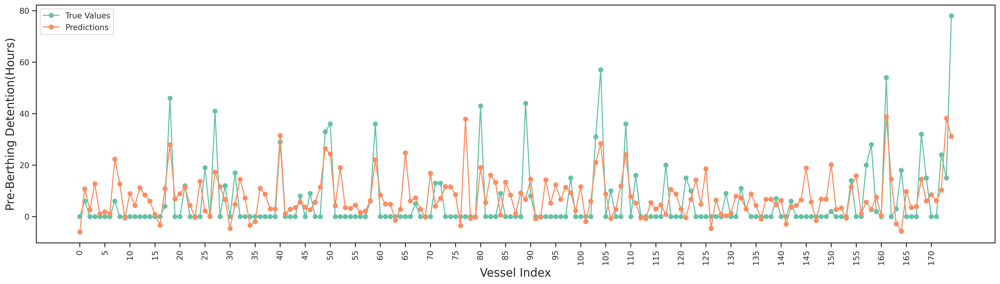

Model 2
MAE: 5.047 (1.050)
                                  Feature  Importance
16                         Quantity_Norms         542
7                               DRAFT_AFT         271
8                               DRAFT_FWD         204
9                                  DWT_MT         202
18                              month_sin         184
17                              month_cos         177
15                                 NRT_MT         137
0                              BEAM_METER         129
10                                 GRT_MT         111
14                              LOA_METER          94
24                         C/B/DB/DC/L_DC          48
37                       REQ_BERTH_CODE_3          45
1                               Berth_DWT          43
54             SHIP_OPERATION_TYPE_Export          40
5                              Congestion          35
3                       Berth_Permissible          34
2                           Berth_Draught          33
4

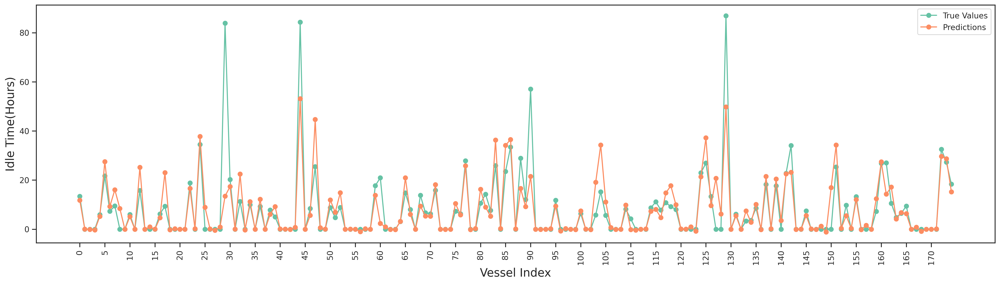

Model 3
MAE: 7.870 (1.297)
                                  Feature  Importance
16                         Quantity_Norms         776
9                                  DWT_MT         188
8                               DRAFT_FWD         173
7                               DRAFT_AFT         168
18                              month_sin         166
10                                 GRT_MT         143
17                              month_cos         139
15                                 NRT_MT         132
0                              BEAM_METER         124
14                              LOA_METER          87
1                               Berth_DWT          81
3                       Berth_Permissible          54
24                         C/B/DB/DC/L_DC          51
4                       Berth_Quay length          51
2                           Berth_Draught          35
6             Congestion_Vessels_Expected          25
54             SHIP_OPERATION_TYPE_Export          23
6

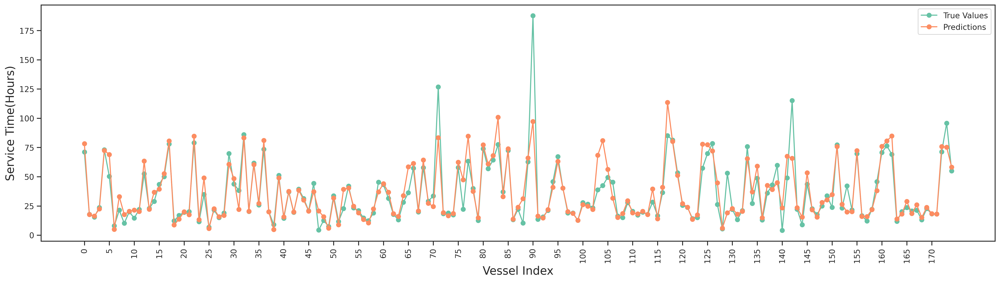

Model 4
MAE: 4.305 (0.962)
                                              Feature  Importance
12                                     Quantity_Norms         555
5                                              DWT_MT         245
4                                           DRAFT_FWD         238
3                                           DRAFT_AFT         203
13                                          month_cos         177
14                                          month_sin         153
11                                             NRT_MT         134
0                                          BEAM_METER         132
10                                          LOA_METER         120
6                                              GRT_MT         118
1                                          Congestion          79
19                                      C/B/DB/DC/L_C          57
35                         SHIP_OPERATION_TYPE_Export          41
20                                     C/B/DB/DC/

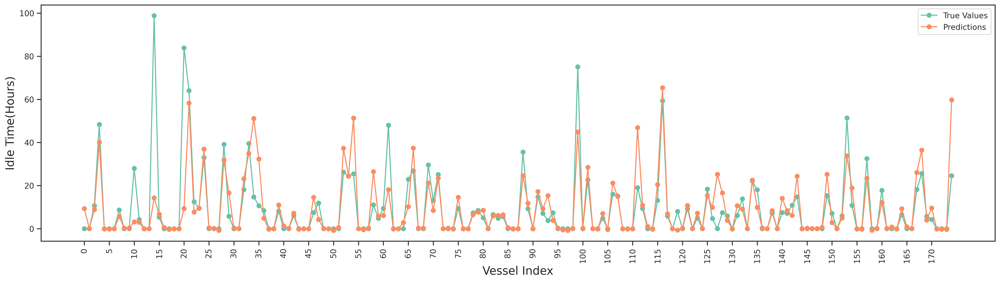

Model 5
MAE: 7.506 (1.361)
                                  Feature  Importance
12                         Quantity_Norms         694
4                               DRAFT_FWD         195
5                                  DWT_MT         183
13                              month_cos         175
11                                 NRT_MT         168
14                              month_sin         158
3                               DRAFT_AFT         155
0                              BEAM_METER         152
10                              LOA_METER         123
6                                  GRT_MT         115
20                         C/B/DB/DC/L_DC          49
19                          C/B/DB/DC/L_C          43
1                              Congestion          38
70                               16(CJII)          31
15                                Non_HMC          27
36             SHIP_OPERATION_TYPE_Import          24
47    VESSEL_TYPENM_GENERAL CARGO VESSELS          21
2

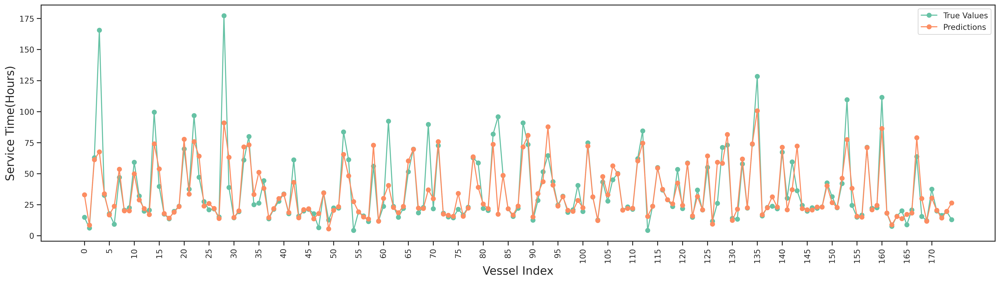

In [ ]:
for i in range(5):
  print('Model', i+1)
  LGBModel(X_matrices[i], y_matrices[i],labels[i])

Model 1
9.826061656211506 1.142433227764103
                                   Feature  Importance
5                               Congestion    0.135956
46                                MT_MV_MT    0.065226
13                                   HMC_3    0.058706
50                             ASSESSED_No    0.055298
3                        Berth_Permissible    0.050027
48                STATUS_FOREIGN_COASTAL_C    0.041073
4                        Berth_Quay length    0.036699
19                                 Non_HMC    0.035979
74                    VESSEL_TYPENM_TANKER    0.035562
11                                   HMC_1    0.033903
15                                  NRT_MT    0.031148
64     VESSEL_TYPENM_DRY BULK CARGO VESSEL    0.026994
70  VESSEL_TYPENM_LIQUID BULK CARGO VESSEL    0.025360
7                                DRAFT_AFT    0.021135
54              SHIP_OPERATION_TYPE_Export    0.020820
37                        REQ_BERTH_CODE_3    0.020399
18                   

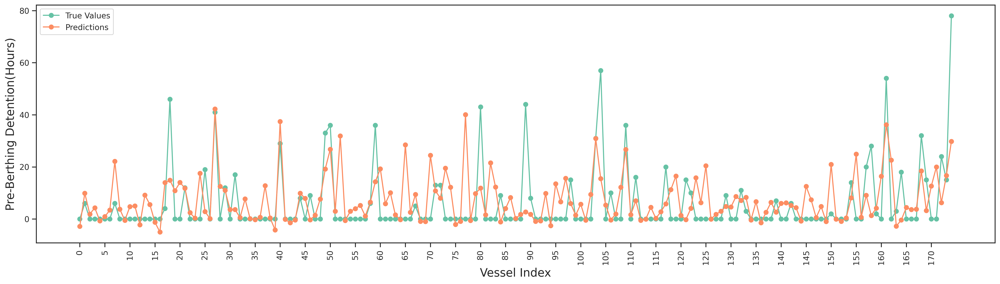

Model 2
4.655663101138159 1.2382369303060516
                       Feature  Importance
23               C/B/DB/DC/L_C    0.374805
54  SHIP_OPERATION_TYPE_Export    0.327328
27              C/B/DB/DC/L_LB    0.098132
53    SHIP_OPERATION_TYPE_Both    0.083334
24              C/B/DB/DC/L_DC    0.045918
37            REQ_BERTH_CODE_3    0.007408
13                       HMC_3    0.007114
4            Berth_Quay length    0.005593
50                 ASSESSED_No    0.004584
12                       HMC_2    0.003943
15                      NRT_MT    0.003789
39            REQ_BERTH_CODE_5    0.003228
46                    MT_MV_MT    0.002904
18                   month_sin    0.002636
21               C/B/DB/DC/L_B    0.002623
2                Berth_Draught    0.002503
16              Quantity_Norms    0.002055
9                       DWT_MT    0.001996
8                    DRAFT_FWD    0.001817
32      REQ_BERTH_CODE_14(CJI)    0.001757
19                     Non_HMC    0.001699
5        

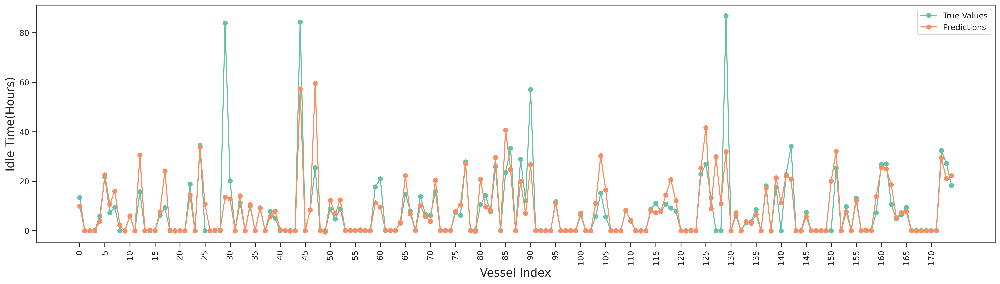

Model 3
7.818013329691428 1.1754730709417491
                                  Feature  Importance
53               SHIP_OPERATION_TYPE_Both    0.862467
26                     C/B/DB/DC/L_HYBRID    0.019929
23                          C/B/DB/DC/L_C    0.016835
29                       REQ_BERTH_CODE_1    0.013735
44                                  O/C_C    0.009607
27                         C/B/DB/DC/L_LB    0.007980
24                         C/B/DB/DC/L_DC    0.007787
19                                Non_HMC    0.007389
3                       Berth_Permissible    0.006372
4                       Berth_Quay length    0.006360
16                         Quantity_Norms    0.005480
60  VESSEL_TYPENM_BREAK BULK CARGO VESSEL    0.005102
1                               Berth_DWT    0.003099
10                                 GRT_MT    0.002836
11                                  HMC_1    0.002493
54             SHIP_OPERATION_TYPE_Export    0.002330
25                         C/B/DB/DC/

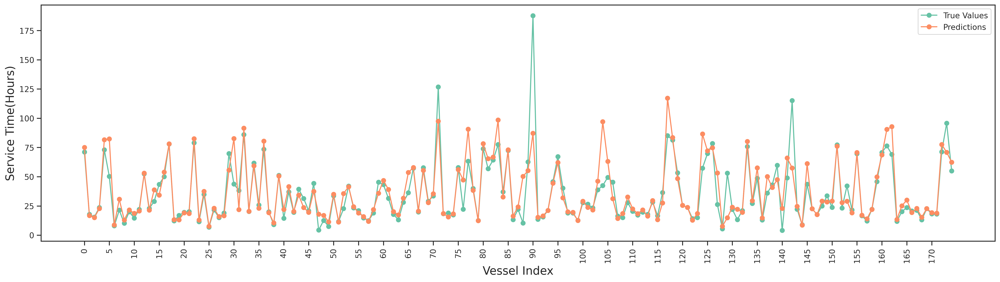

Model 4
3.9681769233419972 0.9842827423905698
                        Feature  Importance
35   SHIP_OPERATION_TYPE_Export    0.458325
19                C/B/DB/DC/L_C    0.334676
20               C/B/DB/DC/L_DC    0.031423
34     SHIP_OPERATION_TYPE_Both    0.029589
23               C/B/DB/DC/L_LB    0.028939
66                      11(CBW)    0.020522
25                        O/C_C    0.014715
57                           B1    0.014325
68                      14(CJI)    0.012656
17                C/B/DB/DC/L_B    0.010765
59                           B3    0.005538
27                     MT_MV_MT    0.005270
6                        GRT_MT    0.004637
15                      Non_HMC    0.002463
2   Congestion_Vessels_Expected    0.002229
12               Quantity_Norms    0.002164
60                           B4    0.002016
5                        DWT_MT    0.002015
11                       NRT_MT    0.001852
7                         HMC_1    0.001798
61                           B

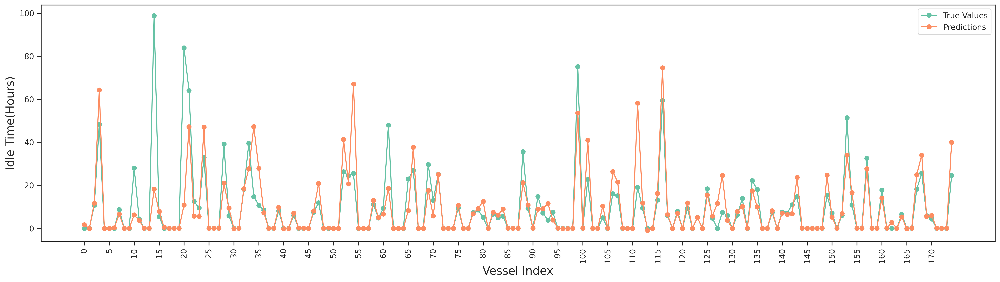

Model 5
7.273868053060925 1.4973719730288149
                                Feature  Importance
34             SHIP_OPERATION_TYPE_Both    0.769380
19                        C/B/DB/DC/L_C    0.040848
24                      C/B/DB/DC/L_LOJ    0.036251
22                   C/B/DB/DC/L_HYBRID    0.024327
23                       C/B/DB/DC/L_LB    0.013904
68                              14(CJI)    0.013775
57                                   B1    0.009989
70                             16(CJII)    0.009198
12                       Quantity_Norms    0.009099
58                                   B2    0.008059
37                          PRIORITY_No    0.007134
25                                O/C_C    0.006136
47  VESSEL_TYPENM_GENERAL CARGO VESSELS    0.004830
66                              11(CBW)    0.004606
5                                DWT_MT    0.004512
11                               NRT_MT    0.004267
6                                GRT_MT    0.003114
21                 

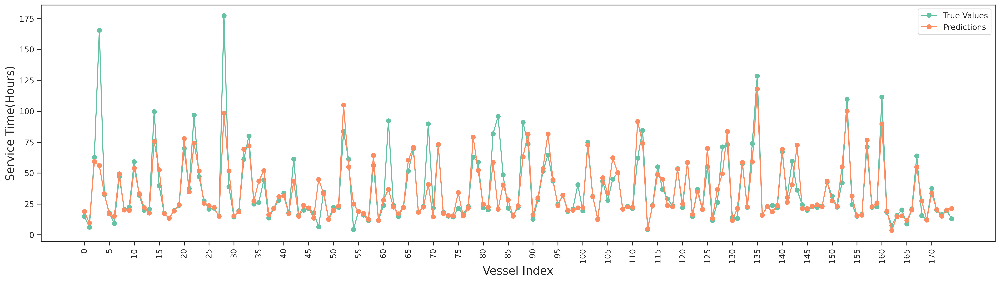

In [ ]:
for i in range(5):
  print("Model",i+1)
  XGBModel(X_matrices[i], y_matrices[i],labels[i])

Model 1
MAE: -9.078 (1.089)


<ipython-input-186-922b95e8e317>:23: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  model.fit(X_train, y_train)


                                   Feature  Importance
16                          Quantity_Norms    0.187424
5                               Congestion    0.125548
7                                DRAFT_AFT    0.085510
17                               month_cos    0.072483
8                                DRAFT_FWD    0.066601
14                               LOA_METER    0.060491
18                               month_sin    0.047326
9                                   DWT_MT    0.047181
15                                  NRT_MT    0.043413
10                                  GRT_MT    0.041212
0                               BEAM_METER    0.040920
70  VESSEL_TYPENM_LIQUID BULK CARGO VESSEL    0.015215
2                            Berth_Draught    0.012220
19                                 Non_HMC    0.010686
6              Congestion_Vessels_Expected    0.009220
3                        Berth_Permissible    0.008373
39                        REQ_BERTH_CODE_5    0.008132
37        

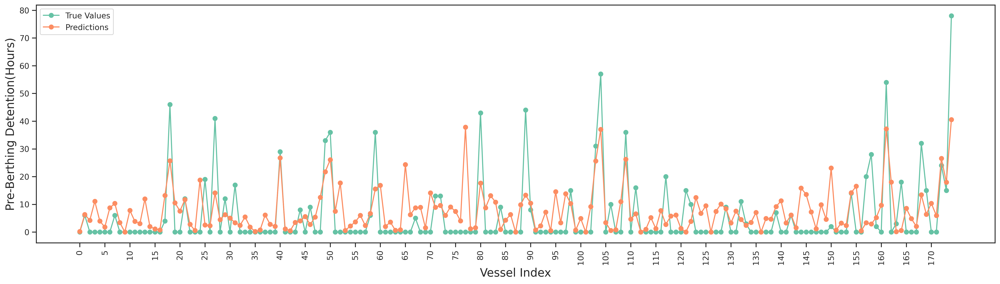

Model 2
MAE: -4.461 (1.079)


<ipython-input-186-922b95e8e317>:23: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  model.fit(X_train, y_train)


                       Feature  Importance
54  SHIP_OPERATION_TYPE_Export    0.364525
23               C/B/DB/DC/L_C    0.092812
16              Quantity_Norms    0.084962
24              C/B/DB/DC/L_DC    0.067300
8                    DRAFT_FWD    0.037647
15                      NRT_MT    0.031901
10                      GRT_MT    0.026954
9                       DWT_MT    0.026130
53    SHIP_OPERATION_TYPE_Both    0.025549
18                   month_sin    0.022610
17                   month_cos    0.021941
7                    DRAFT_AFT    0.020837
21               C/B/DB/DC/L_B    0.019083
14                   LOA_METER    0.017581
37            REQ_BERTH_CODE_3    0.012253
55  SHIP_OPERATION_TYPE_Import    0.010663
27              C/B/DB/DC/L_LB    0.010202
12                       HMC_2    0.009264
3            Berth_Permissible    0.009097
4            Berth_Quay length    0.008721
0                   BEAM_METER    0.008266
2                Berth_Draught    0.007665
46         

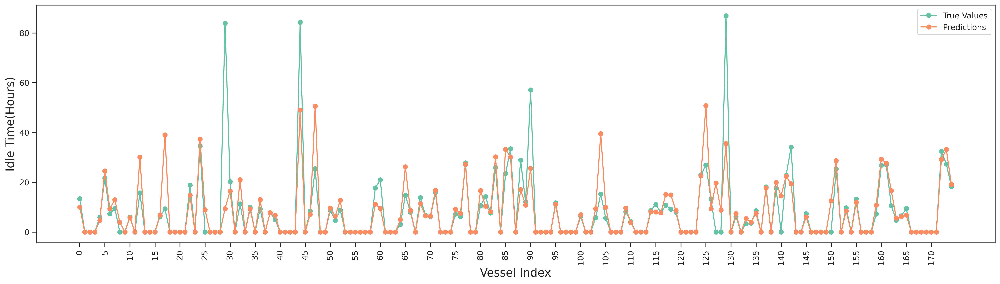

Model 3
MAE: -7.476 (1.294)


<ipython-input-186-922b95e8e317>:23: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  model.fit(X_train, y_train)


                                  Feature  Importance
16                         Quantity_Norms    0.371486
53               SHIP_OPERATION_TYPE_Both    0.276824
8                               DRAFT_FWD    0.025921
4                       Berth_Quay length    0.024218
26                     C/B/DB/DC/L_HYBRID    0.023341
10                                 GRT_MT    0.022983
7                               DRAFT_AFT    0.017574
15                                 NRT_MT    0.017010
9                                  DWT_MT    0.016949
36                       REQ_BERTH_CODE_2    0.016664
11                                  HMC_1    0.016101
3                       Berth_Permissible    0.015021
18                              month_sin    0.014411
17                              month_cos    0.014193
23                          C/B/DB/DC/L_C    0.013718
14                              LOA_METER    0.011184
29                       REQ_BERTH_CODE_1    0.010972
24                         C

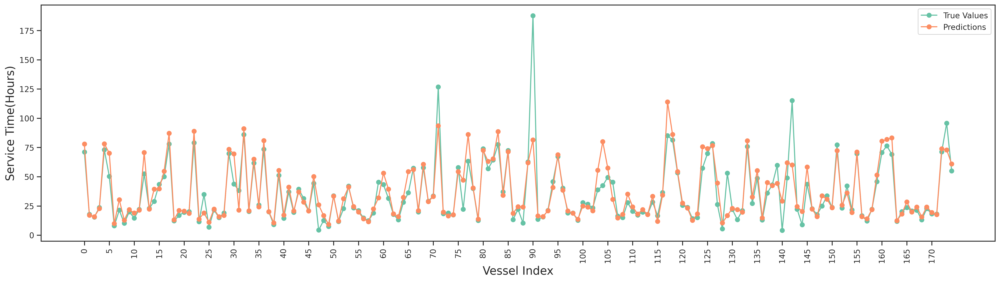

Model 4
MAE: -3.623 (0.943)


<ipython-input-186-922b95e8e317>:23: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  model.fit(X_train, y_train)


                       Feature  Importance
35  SHIP_OPERATION_TYPE_Export    0.352906
19               C/B/DB/DC/L_C    0.107969
12              Quantity_Norms    0.060446
34    SHIP_OPERATION_TYPE_Both    0.054727
11                      NRT_MT    0.040120
20              C/B/DB/DC/L_DC    0.038967
6                       GRT_MT    0.028599
68                     14(CJI)    0.027840
17               C/B/DB/DC/L_B    0.025419
4                    DRAFT_FWD    0.024845
10                   LOA_METER    0.024647
13                   month_cos    0.020554
5                       DWT_MT    0.020469
3                    DRAFT_AFT    0.019711
59                          B3    0.016325
36  SHIP_OPERATION_TYPE_Import    0.014223
0                   BEAM_METER    0.013675
1                   Congestion    0.012954
66                     11(CBW)    0.012627
57                          B1    0.012004
14                   month_sin    0.009839
15                     Non_HMC    0.006012
60         

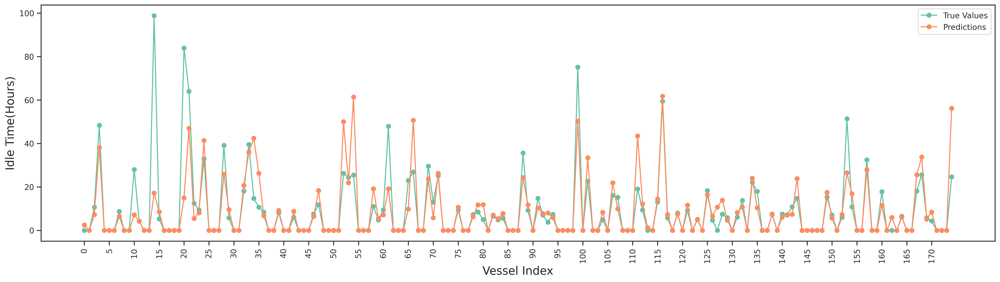

Model 5
MAE: -7.024 (1.306)


<ipython-input-186-922b95e8e317>:23: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  model.fit(X_train, y_train)


                                  Feature  Importance
12                         Quantity_Norms    0.362214
34               SHIP_OPERATION_TYPE_Both    0.284840
0                              BEAM_METER    0.032380
68                                14(CJI)    0.030900
4                               DRAFT_FWD    0.025413
6                                  GRT_MT    0.022816
22                     C/B/DB/DC/L_HYBRID    0.020985
14                              month_sin    0.020157
5                                  DWT_MT    0.019091
57                                     B1    0.019056
11                                 NRT_MT    0.017642
3                               DRAFT_AFT    0.015523
19                          C/B/DB/DC/L_C    0.011558
10                              LOA_METER    0.010894
58                                     B2    0.010422
13                              month_cos    0.009792
69                                 15(OJ)    0.009184
20                         C

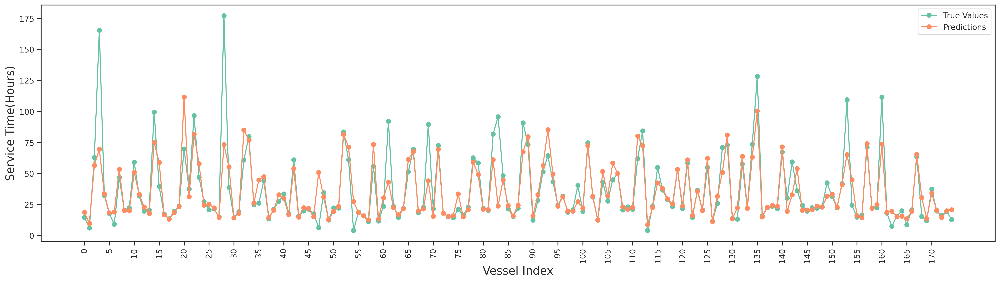

In [ ]:
for i in range(5):
  print("Model",i+1)
  RFModel(X_matrices[i], y_matrices[i],labels[i])

Model 1
Epoch 1/100
22/22 [==============================] - 1s 2ms/step - loss: 7.3591
Epoch 2/100
22/22 [==============================] - 0s 2ms/step - loss: 7.3088
Epoch 3/100
22/22 [==============================] - 0s 2ms/step - loss: 7.2852
Epoch 4/100
22/22 [==============================] - 0s 2ms/step - loss: 7.2605
Epoch 5/100
22/22 [==============================] - 0s 2ms/step - loss: 7.2335
Epoch 6/100
22/22 [==============================] - 0s 2ms/step - loss: 7.2034
Epoch 7/100
22/22 [==============================] - 0s 2ms/step - loss: 7.1451
Epoch 8/100
22/22 [==============================] - 0s 2ms/step - loss: 7.0761
Epoch 9/100
22/22 [==============================] - 0s 2ms/step - loss: 6.9988
Epoch 10/100
22/22 [==============================] - 0s 3ms/step - loss: 6.9072
Epoch 11/100
22/22 [==============================] - 0s 2ms/step - loss: 6.7958
Epoch 12/100
22/22 [==============================] - 0s 2ms/step - loss: 6.7000
Epoch 13/100
22/22 [=========

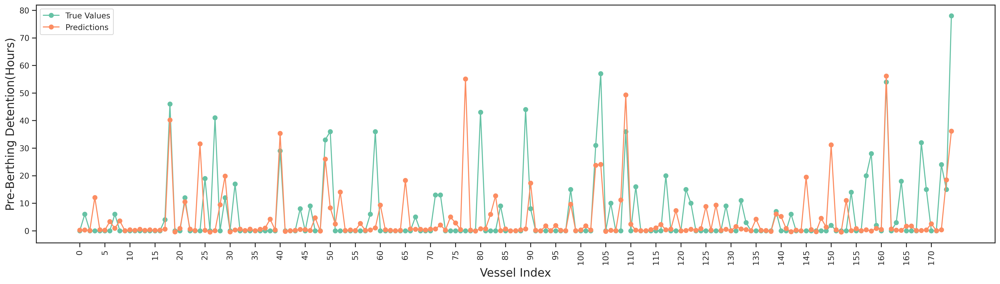

Model 2
Epoch 1/100
22/22 [==============================] - 1s 3ms/step - loss: 10.2522
Epoch 2/100
22/22 [==============================] - 0s 3ms/step - loss: 8.7075
Epoch 3/100
22/22 [==============================] - 0s 3ms/step - loss: 7.2050
Epoch 4/100
22/22 [==============================] - 0s 3ms/step - loss: 6.4681
Epoch 5/100
22/22 [==============================] - 0s 3ms/step - loss: 5.8765
Epoch 6/100
22/22 [==============================] - 0s 4ms/step - loss: 5.3937
Epoch 7/100
22/22 [==============================] - 0s 5ms/step - loss: 5.0244
Epoch 8/100
22/22 [==============================] - 0s 3ms/step - loss: 4.8008
Epoch 9/100
22/22 [==============================] - 0s 4ms/step - loss: 4.6563
Epoch 10/100
22/22 [==============================] - 0s 3ms/step - loss: 4.5539
Epoch 11/100
22/22 [==============================] - 0s 4ms/step - loss: 4.4627
Epoch 12/100
22/22 [==============================] - 0s 4ms/step - loss: 4.4120
Epoch 13/100
22/22 [========

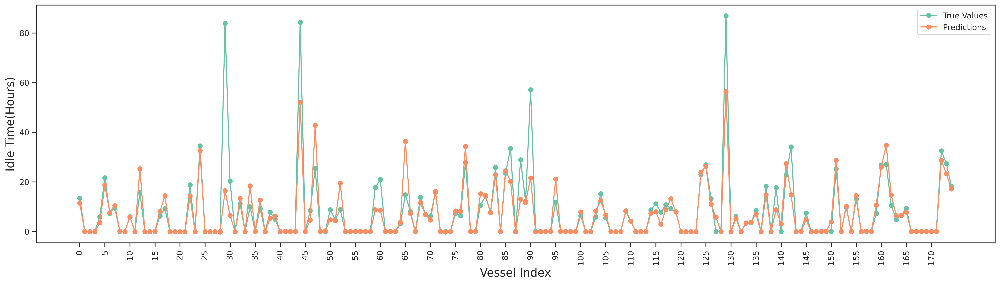

Model 3
Epoch 1/100
22/22 [==============================] - 1s 3ms/step - loss: 35.4938
Epoch 2/100
22/22 [==============================] - 0s 3ms/step - loss: 31.3136
Epoch 3/100
22/22 [==============================] - 0s 3ms/step - loss: 23.4022
Epoch 4/100
22/22 [==============================] - 0s 3ms/step - loss: 17.4877
Epoch 5/100
22/22 [==============================] - 0s 3ms/step - loss: 14.2749
Epoch 6/100
22/22 [==============================] - 0s 3ms/step - loss: 12.9898
Epoch 7/100
22/22 [==============================] - 0s 3ms/step - loss: 12.2436
Epoch 8/100
22/22 [==============================] - 0s 4ms/step - loss: 11.6595
Epoch 9/100
22/22 [==============================] - 0s 3ms/step - loss: 11.1817
Epoch 10/100
22/22 [==============================] - 0s 3ms/step - loss: 10.6915
Epoch 11/100
22/22 [==============================] - 0s 3ms/step - loss: 10.3300
Epoch 12/100
22/22 [==============================] - 0s 3ms/step - loss: 10.0360
Epoch 13/100
22/2

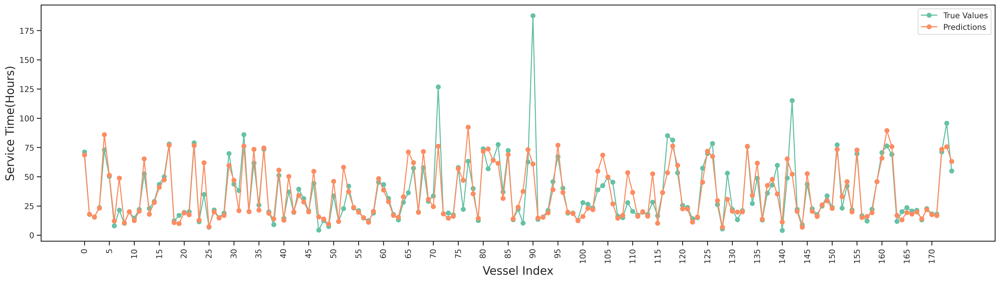

Model 4
Epoch 1/100
22/22 [==============================] - 1s 4ms/step - loss: 9.6783
Epoch 2/100
22/22 [==============================] - 0s 5ms/step - loss: 9.0105
Epoch 3/100
22/22 [==============================] - 0s 6ms/step - loss: 7.5952
Epoch 4/100
22/22 [==============================] - 0s 4ms/step - loss: 6.4636
Epoch 5/100
22/22 [==============================] - 0s 4ms/step - loss: 5.8366
Epoch 6/100
22/22 [==============================] - 0s 4ms/step - loss: 5.2022
Epoch 7/100
22/22 [==============================] - 0s 4ms/step - loss: 4.5936
Epoch 8/100
22/22 [==============================] - 0s 2ms/step - loss: 4.1927
Epoch 9/100
22/22 [==============================] - 0s 3ms/step - loss: 3.9820
Epoch 10/100
22/22 [==============================] - 0s 4ms/step - loss: 3.8105
Epoch 11/100
22/22 [==============================] - 0s 3ms/step - loss: 3.7094
Epoch 12/100
22/22 [==============================] - 0s 3ms/step - loss: 3.6124
Epoch 13/100
22/22 [=========

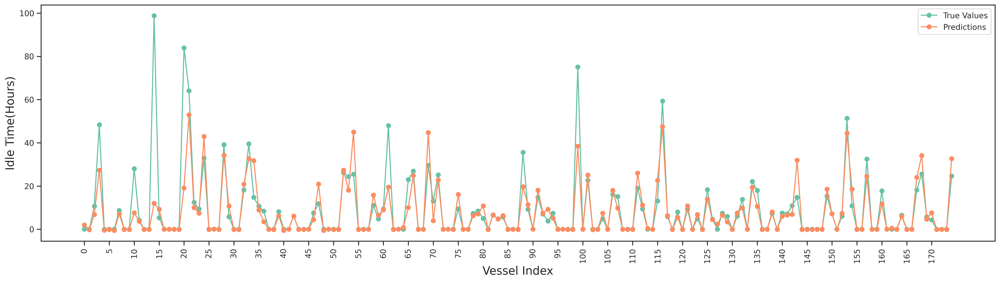

Model 5
Epoch 1/100
22/22 [==============================] - 1s 4ms/step - loss: 36.5375
Epoch 2/100
22/22 [==============================] - 0s 4ms/step - loss: 34.5813
Epoch 3/100
22/22 [==============================] - 0s 3ms/step - loss: 30.4802
Epoch 4/100
22/22 [==============================] - 0s 4ms/step - loss: 23.0457
Epoch 5/100
22/22 [==============================] - 0s 3ms/step - loss: 18.6475
Epoch 6/100
22/22 [==============================] - 0s 3ms/step - loss: 16.1742
Epoch 7/100
22/22 [==============================] - 0s 3ms/step - loss: 14.3941
Epoch 8/100
22/22 [==============================] - 0s 3ms/step - loss: 13.1342
Epoch 9/100
22/22 [==============================] - 0s 3ms/step - loss: 12.1142
Epoch 10/100
22/22 [==============================] - 0s 3ms/step - loss: 11.3862
Epoch 11/100
22/22 [==============================] - 0s 3ms/step - loss: 10.7895
Epoch 12/100
22/22 [==============================] - 0s 3ms/step - loss: 10.3073
Epoch 13/100
22/2

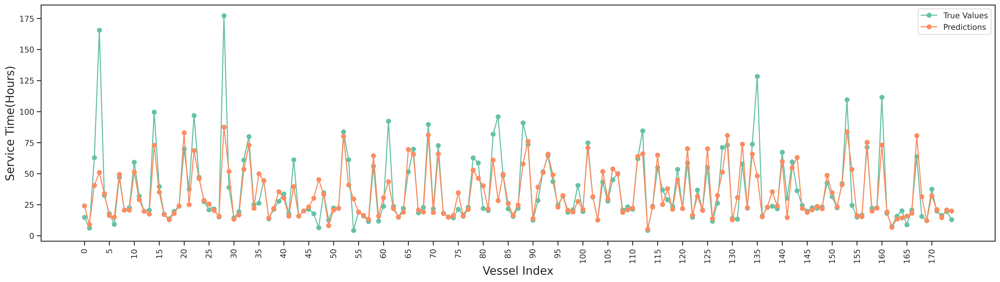

In [ ]:
for i in range(5):
  print('Model', i+1)
  ANNModel(X_matrices[i], y_matrices[i],labels[i])

#Extras

In [ ]:
X4.columns

Index([                                       'BEAM_METER',
                                              'Congestion',
                             'Congestion_Vessels_Expected',
                                               'DRAFT_AFT',
                                               'DRAFT_FWD',
                                                  'DWT_MT',
                                                  'GRT_MT',
                                                   'HMC_1',
                                                   'HMC_2',
                                                   'HMC_3',
                                               'LOA_METER',
                                                  'NRT_MT',
                                          'Quantity_Norms',
                                               'month_cos',
                                               'month_sin',
                                                 'Non_HMC',
                                  'C/B/D

MAE: -3.622 (0.941)


<ipython-input-161-678e17bd2323>:23: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  model.fit(X_train, y_train)


                       Feature  Importance
35  SHIP_OPERATION_TYPE_Export    0.332625
19               C/B/DB/DC/L_C    0.107492
12              Quantity_Norms    0.062833
34    SHIP_OPERATION_TYPE_Both    0.059753
11                      NRT_MT    0.043172
20              C/B/DB/DC/L_DC    0.040234
17               C/B/DB/DC/L_B    0.032602
6                       GRT_MT    0.031963
68                     14(CJI)    0.026568
36  SHIP_OPERATION_TYPE_Import    0.026515
4                    DRAFT_FWD    0.024509
13                   month_cos    0.022567
3                    DRAFT_AFT    0.021794
10                   LOA_METER    0.020392
5                       DWT_MT    0.018453
0                   BEAM_METER    0.015192
59                          B3    0.014867
57                          B1    0.012172
1                   Congestion    0.011838
14                   month_sin    0.009302
66                     11(CBW)    0.007245
32                ASSESSED_Yes    0.005874
28         

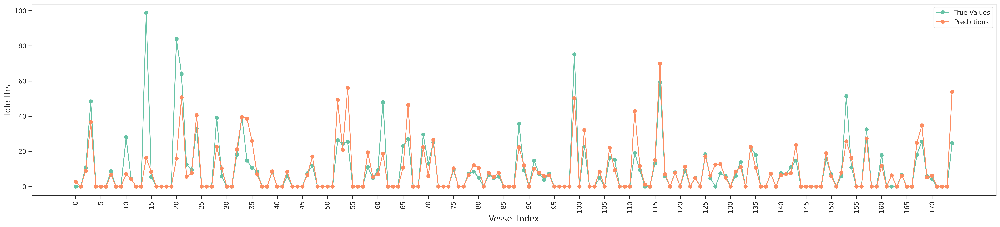

-3.622069824120083

In [ ]:
RFModel(X4,y4)

MAE: 9.083 (1.061)
                                   Feature  Importance
16                          Quantity_Norms         779
8                                DRAFT_FWD         232
17                               month_cos         222
7                                DRAFT_AFT         210
9                                   DWT_MT         180
18                               month_sin         174
15                                  NRT_MT         160
10                                  GRT_MT         147
14                               LOA_METER         139
0                               BEAM_METER          99
5                               Congestion          36
4                        Berth_Quay length          21
19                                 Non_HMC          19
2                            Berth_Draught          18
39                        REQ_BERTH_CODE_5          16
12                                   HMC_2          14
3                        Berth_Permissible    

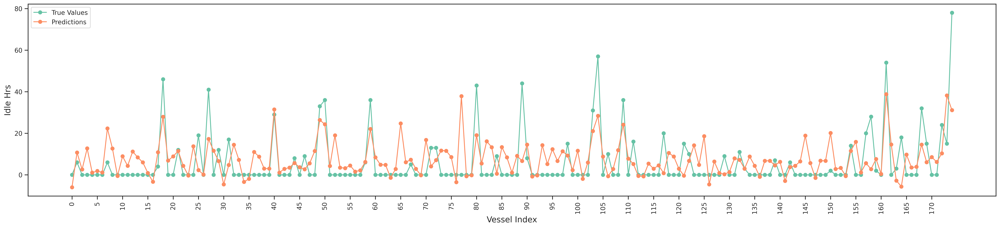

9.082573072190591

In [ ]:
LGBModel(X1,y1)

In [ ]:
# from sklearn.ensemble import RandomForestRegressor
# from sklearn.model_selection import cross_val_score
# from sklearn.model_selection import RepeatedKFold
# from numpy import mean
# from numpy import sqrt
# from numpy import std

# def RandomForestCV_model(X, y):
#     # Define the model
#     model = RandomForestRegressor()
#     X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)
#     # Use cross-validation to evaluate the model
#     cv = RepeatedKFold(n_splits=10, n_repeats=20, random_state=1)
#     mae_scores = -cross_val_score(model, X_train, y_train, scoring='neg_mean_absolute_error', cv=cv, n_jobs=-1, error_score='raise')
#     # rmse_scores = sqrt(-cross_val_score(model, X_train, y_train, scoring='neg_mean_squared_error', cv=cv, n_jobs=-1, error_score='raise'))

#     # Calculate the mean and standard deviation of the scores
#     mae = mean(mae_scores)
#     mae_std = std(mae_scores)
#     rmse = mean(rmse_scores)
#     rmse_std = std(rmse_scores)

#     # Return the error metrics
#     return mae, mae_std
#     return mae, mae_std, rmse, rmse_std

In [ ]:
# RandomForestCV_model(X3,y3)

In [ ]:
# from sklearn.ensemble import RandomForestRegressor
# from sklearn.model_selection import cross_val_score
# from sklearn.model_selection import RepeatedKFold
# from numpy import mean
# from numpy import sqrt
# from numpy import std
# from sklearn.metrics import mean_absolute_error
# from sklearn.metrics import mean_squared_error

# def prediction_plot(y_test, y_pred):

#     import matplotlib.pyplot as plt

#     plt.figure(figsize=(20, 6))

#     plt.plot(y_test, label='True Values')
#     plt.plot(y_pred, label='Predictions')

#     plt.axhline(y=0, color='black', linestyle='--')

#     x_tick_indices = np.arange(0, len(y_test), 5)
#     plt.xticks(x_tick_indices, x_tick_indices, rotation=90)

#     plt.xlabel('Index',size = 14)
#     plt.ylabel('Service Hrs',size = 14)
#     plt.legend()
#     plt.show()

# def RandomForestCV_model(X, y):
#     # Define the model
#     model = RandomForestRegressor()
#     X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)
#     # Use cross-validation to evaluate the model
#     cv = RepeatedKFold(n_splits=10, n_repeats=20, random_state=1)
#     mae_scores = -cross_val_score(model, X_train, y_train, scoring='neg_mean_absolute_error', cv=cv, n_jobs=-1, error_score='raise')
#     # rmse_scores = sqrt(-cross_val_score(model, X_train, y_train, scoring='neg_mean_squared_error', cv=cv, n_jobs=-1, error_score='raise'))


#     # Calculate the mean and standard deviation of the scores
#     mae = mean(mae_scores)
#     mae_std = std(mae_scores)

#     # rmse = mean(rmse_scores)
#     # rmse_std = std(rmse_scores)

#     model.fit(X_train, y_train)
#     y_pred = model.predict(X_test)

#     MAE=mean_absolute_error(y_test, y_pred)
#     MSE=mean_squared_error(y_test,y_pred)

#     prediction_plot(y_test, y_pred)

#     # Return the error metrics
#     return mae, mae_std, MAE, MSE

In [ ]:
# def prediction_plot(y_test, y_pred):

#     import matplotlib.pyplot as plt

#     plt.figure(figsize=(20, 6))

#     plt.plot(y_test, label='True Values')
#     plt.plot(y_pred, label='Predictions')

#     plt.axhline(y=0, color='black', linestyle='--')

#     x_tick_indices = np.arange(0, len(y_test), 5)
#     plt.xticks(x_tick_indices, x_tick_indices, rotation=90)

#     plt.xlabel('Index',size = 14)
#     plt.ylabel('Service Hrs',size = 14)
#     plt.legend()
#     plt.show()

In [ ]:
# def error_plot(y_test, y_pred):
#     import matplotlib.pyplot as plt
#     plt.figure(figsize=(20, 6))

#     plt.plot(error, label='Prediction Error')

#     plt.axhline(y=0, color='black', linestyle='--')
#     x_tick_indices = np.arange(0, len(y_test), 5)
#     plt.xticks(x_tick_indices, x_tick_indices, rotation=90)


#     # plt.xlabel('Index',size = 14)
#     plt.ylabel('Error',size = 14)
#     plt.legend()
#     plt.show()

In [ ]:
y1

,DETENTION_HRS
VESSEL_NO,
20-21/1101,0.0
20-21/1138,16.0
20-21/1147,0.0
20-21/1154,0.0
20-21/1159,0.0
...,...
21-22/1210,0.0
21-22/1212,0.0
21-22/1217,0.0


In [ ]:
# X_train, X_test, y_train, y_test = train_test_split(X1, y1, test_size=0.2, random_state=42)

In [ ]:
from numpy import mean
from numpy import std
from sklearn.datasets import make_regression
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import RepeatedKFold
from sklearn.ensemble import RandomForestRegressor
# define dataset
# X, y = make_regression(n_samples=1000, n_features=20, n_informative=15, noise=0.1, random_state=2)
# define the model

## Service Time prediction 1

In [ ]:
X_train, X_test, y_train, y_test = train_test_split(X3, y3, test_size=0.2, random_state=42)
# define dataset
# X, y = make_regression(n_samples=1000, n_features=20, n_informative=15, noise=0.1, random_state=2)
# define the model
model = RandomForestRegressor()
# evaluate the model
cv = RepeatedKFold(n_splits=10, n_repeats=20, random_state=1)
n_scores = cross_val_score(model, X_train, y_train, scoring='neg_mean_absolute_error', cv=cv, n_jobs=-1, error_score='raise')
# report performance
print('MAE: %.3f (%.3f)' % (mean(n_scores), std(n_scores)))

MAE: -7.756 (1.359)


In [ ]:
model.fit(X_train, y_train)
y_pred = model.predict(X_test)

# import matplotlib.pyplot as plt

# plt.scatter(y_test, y_pred)
# plt.xlabel('True Values',size = 10)
# plt.ylabel('Predictions',size=10)
# plt.show()

<ipython-input-162-099e096c956b>:1: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  model.fit(X_train, y_train)


In [ ]:
importances = model.feature_importances_

# create a pandas dataframe with the feature names and their importances
feature_importances = pd.DataFrame({'Feature': X_train.columns, 'Importance': importances})

# sort the dataframe by importances in descending order
feature_importances = feature_importances.sort_values('Importance', ascending=False)

# print the top 10 features
print(feature_importances.head(25))

                                Feature  Importance
15                       Quantity_Norms    0.343454
52             SHIP_OPERATION_TYPE_Both    0.284109
0                            BEAM_METER    0.029405
4                     Berth_Quay length    0.026029
7                             DRAFT_FWD    0.021634
14                               NRT_MT    0.020325
6                             DRAFT_AFT    0.019494
9                                GRT_MT    0.018495
35                     REQ_BERTH_CODE_2    0.018471
17                            month_sin    0.018411
16                            month_cos    0.017894
22                        C/B/DB/DC/L_C    0.016202
8                                DWT_MT    0.014371
10                                HMC_1    0.014255
28                     REQ_BERTH_CODE_1    0.014011
25                   C/B/DB/DC/L_HYBRID    0.012994
3                     Berth_Permissible    0.012311
23                       C/B/DB/DC/L_DC    0.011210
13          

In [ ]:
# model = RandomForestRegressor()
# # evaluate the model
# cv = RepeatedKFold(n_splits=10, n_repeats=20, random_state=1)
# n_scores = cross_val_score(model, X3, y3, scoring='neg_mean_absolute_error', cv=cv, n_jobs=-1, error_score='raise')
# # report performance
# print('MAE: %.3f (%.3f)' % (mean(n_scores), std(n_scores)))

In [ ]:
# # calculate mean absolute error (MAE)
# mae_scores = cross_val_score(model, X_train, y_train, scoring='neg_mean_absolute_error', cv=cv, n_jobs=-1, error_score='raise')
# print('MAE: %.3f (%.3f)' % (mean(mae_scores), std(mae_scores)))

# # calculate mean squared error (MSE)
# mse_scores = cross_val_score(model, X_train, y_train, scoring='neg_mean_squared_error', cv=cv, n_jobs=-1, error_score='raise')
# print('MSE: %.3f (%.3f)' % (mean(mse_scores), std(mse_scores)))

# # calculate R^2
# r2_scores = cross_val_score(model, X_train, y_train, scoring='r2', cv=cv, n_jobs=-1, error_score='raise')
# print('R^2: %.3f (%.3f)' % (mean(r2_scores), std(r2_scores)))

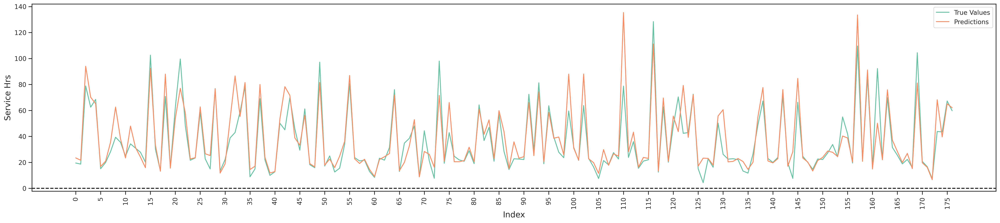

In [ ]:
import matplotlib.pyplot as plt
plt.figure(figsize=(30, 6))
plt.plot(y_test, label='True Values')
plt.plot(y_pred, label='Predictions')
# plt.plot((X_test['Quantity_Norms']*7.974324+8.175745), label = 'Quantity_Norms')
plt.axhline(y=0, color='black', linestyle='--')
x_tick_indices = np.arange(0, len(y_test), 5)
plt.xticks(x_tick_indices, x_tick_indices, rotation=90)


plt.xlabel('Index',size = 14)
plt.ylabel('Service Hrs',size = 14)
plt.legend()
plt.show()

In [ ]:
# pred = pd.DataFrame(y_pred)
# pred.index = y_test.index
# pred = pred.rename(columns={0: 'Service Hours in particular berth'})

In [ ]:
# error = y_test - pred

In [ ]:

# import matplotlib.pyplot as plt
# plt.figure(figsize=(30, 6))

# plt.plot(error, label='Prediction Error')
# # plt.plot(y_test, label='Actual Service Hrs')
# # plt.plot((46.460283+error), label='Fluctuation')
# # plt.plot((X_test['Quantity_Norms']*7.974324+8.175745), label = 'Quantity_Norms')
# plt.axhline(y=0, color='black', linestyle='--')
# x_tick_indices = np.arange(0, len(y_test), 5)
# plt.xticks(x_tick_indices, x_tick_indices, rotation=90)


# # plt.xlabel('Index',size = 14)
# plt.ylabel('Error in Service Hrs',size = 14)
# plt.legend()
# plt.show()

In [ ]:
# #Plotting the circle with x,y coordinates. Labels in red are day of year.
# plt.figure(figsize=(12, 12), dpi=80)
# plt.scatter(df1_continuous['month_cos'], df1_continuous['month_sin'])
# # for i in range(len(df1_continuous.index)):
#   plt.text(x=df1_continuous['month_cos'][i]+0.05,y=df1_continuous['month_sin']+0.05,s=df1_continuous.index[i],fontdict=dict(color="red",size=10))

## Pre-Berthing Detention

In [ ]:
X_train, X_test, y_train, y_test = train_test_split(X1, y1, test_size=0.2, random_state=42)
# define dataset
# X, y = make_regression(n_samples=1000, n_features=20, n_informative=15, noise=0.1, random_state=2)
# define the model
model = RandomForestRegressor()
# evaluate the model
cv = RepeatedKFold(n_splits=10, n_repeats=20, random_state=1)
n_scores = cross_val_score(model, X_train, y_train, scoring='neg_mean_absolute_error', cv=cv, n_jobs=-1, error_score='raise')
# report performance
print('MAE: %.3f (%.3f)' % (mean(n_scores), std(n_scores)))

MAE: -9.426 (1.151)


In [ ]:
model.fit(X_train, y_train)
y_pred = model.predict(X_test)

importances = model.feature_importances_

# create a pandas dataframe with the feature names and their importances
feature_importances = pd.DataFrame({'Feature': X_train.columns, 'Importance': importances})

# sort the dataframe by importances in descending order
feature_importances = feature_importances.sort_values('Importance', ascending=False)

# print the top 10 features
print(feature_importances.head(25))

<ipython-input-172-78b34617d813>:1: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  model.fit(X_train, y_train)


                                   Feature  Importance
15                          Quantity_Norms    0.224439
16                               month_cos    0.097850
7                                DRAFT_FWD    0.087538
6                                DRAFT_AFT    0.081369
17                               month_sin    0.065930
13                               LOA_METER    0.063424
8                                   DWT_MT    0.054660
14                                  NRT_MT    0.043770
0                               BEAM_METER    0.039569
9                                   GRT_MT    0.036337
18                                 Non_HMC    0.023421
69  VESSEL_TYPENM_LIQUID BULK CARGO VESSEL    0.017216
5              Congestion_Vessels_Expected    0.012524
2                            Berth_Draught    0.010953
10                                   HMC_1    0.009859
3                        Berth_Permissible    0.008674
11                                   HMC_2    0.008078
63     VES

In [ ]:
df1_continuous.describe()

,BEAM_METER,Berth_DWT,Berth_Draught,Berth_Permissible,Berth_Quay length,Congestion_Vessels_Expected,DETENTION_HRS,DRAFT_AFT,DRAFT_FWD,DWT_MT,GRT_MT,HMC_1,HMC_2,HMC_3,Idle Hrs,LOA_METER,NRT_MT,Quantity_Norms,Service Hours in particular berth,Total Berthed Hrs,month_cos,month_sin
count,881.000000,881.000000,881.000000,881.000000,881.000000,881.000000,881.000000,881.000000,881.000000,881.000000,881.000000,881.000000,881.000000,881.000000,881.000000,881.000000,881.000000,881.000000,881.000000,881.000000,8.810000e+02,8.810000e+02
mean,0.060706,0.000742,-0.008292,0.108894,0.068690,-0.084061,7.270148,0.025667,0.023549,-0.105018,-0.054147,-0.215692,-0.233811,-0.209263,10.583019,0.069710,-0.084743,0.025981,37.086126,48.263829,-2.617727e-02,-3.930120e-02
std,0.737997,1.004045,1.011382,1.057207,1.011858,0.798054,13.826757,0.773873,0.804412,0.772036,0.823619,0.357929,0.383765,0.447604,17.236969,0.795230,0.796030,0.896140,27.796626,42.844195,6.975169e-01,7.158031e-01
min,-2.108630,-1.913887,-2.408387,-2.176488,-1.610990,-0.418897,0.000000,-2.442745,-2.144002,-1.401075,-1.473752,-0.298782,-0.329504,-0.322512,0.000000,-2.055389,-1.355139,-1.017014,4.100000,4.100000,-1.000000e+00,-1.000000e+00
25%,-0.237978,-0.739292,-1.028880,-0.737688,-1.080390,-0.418897,0.000000,-0.328203,-0.492774,-0.610008,-0.466174,-0.298782,-0.329504,-0.322512,0.000000,-0.062037,-0.623371,-0.742957,18.950000,19.716667,-5.000000e-01,-8.660254e-01
50%,0.087353,-0.393823,-0.069224,0.071638,0.682384,-0.418897,0.000000,0.110724,0.096950,-0.404706,-0.332424,-0.298782,-0.329504,-0.322512,4.580000,0.217731,-0.278791,-0.390426,24.600000,30.616667,-1.836970e-16,-2.449294e-16
75%,0.884414,1.091695,0.930419,1.240664,0.806191,-0.418897,9.000000,0.344605,0.539243,0.591404,0.668143,-0.298782,-0.329504,-0.322512,14.770000,0.420987,0.634957,0.858186,50.670000,69.233333,5.000000e-01,5.000000e-01
max,1.502543,1.091695,0.930419,1.240664,1.100969,1.815878,84.000000,1.658184,1.630233,2.097490,1.766946,2.254786,1.586533,1.823143,114.140000,1.948694,2.000857,2.439060,187.670000,305.800000,1.000000e+00,1.000000e+00


In [ ]:
model.fit(X_train, y_train)
y_pred = model.predict(X_test)

<ipython-input-174-00d4b3251fd2>:1: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  model.fit(X_train, y_train)


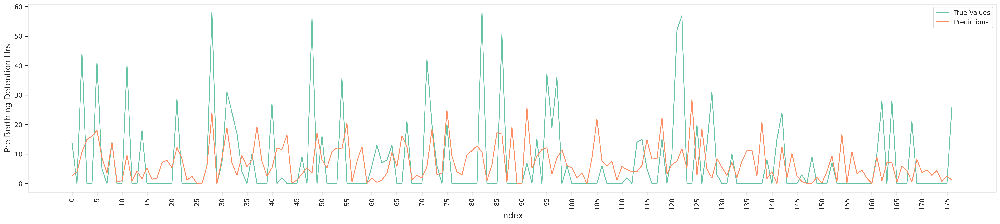

In [ ]:
import matplotlib.pyplot as plt
plt.figure(figsize=(30, 6))
plt.plot(y_test, label='True Values')
plt.plot(y_pred, label='Predictions')
# plt.plot((X_test['Quantity_Norms']*7.974324+8.175745), label = 'Quantity_Norms')

x_tick_indices = np.arange(0, len(y_test), 5)
plt.xticks(x_tick_indices, x_tick_indices, rotation=90)


plt.xlabel('Index',size = 14)
plt.ylabel('Pre-Berthing Detention Hrs',size = 14)
plt.legend()
plt.show()

In [ ]:
# pred = pd.DataFrame(y_pred)
# pred.index = y_test.index
# pred = pred.rename(columns={0: 'DETENTION_HRS'})

In [ ]:
# error = y_test - pred

In [ ]:

# import matplotlib.pyplot as plt
# plt.figure(figsize=(20, 6))

# plt.plot(error, label='Prediction Error')
# # plt.plot(y_test, label='Actual Service Hrs')
# # plt.plot((46.460283+error), label='Fluctuation')
# # plt.plot((X_test['Quantity_Norms']*7.974324+8.175745), label = 'Quantity_Norms')
# plt.axhline(y=0, color='black', linestyle='--')
# x_tick_indices = np.arange(0, len(y_test), 5)
# plt.xticks(x_tick_indices, x_tick_indices, rotation=90)


# # plt.xlabel('Index',size = 14)
# plt.ylabel('Error PB Detention',size = 14)
# plt.legend()
# plt.show()

## Idle Hrs 1

In [ ]:
X_train, X_test, y_train, y_test = train_test_split(X2, y2, test_size=0.2, random_state=42)
# define dataset
# X, y = make_regression(n_samples=1000, n_features=20, n_informative=15, noise=0.1, random_state=2)
# define the model
model = RandomForestRegressor()
# evaluate the model
cv = RepeatedKFold(n_splits=10, n_repeats=20, random_state=1)
n_scores = cross_val_score(model, X_train, y_train, scoring='neg_mean_absolute_error', cv=cv, n_jobs=-1, error_score='raise')
# report performance
print('MAE: %.3f (%.3f)' % (mean(n_scores), std(n_scores)))

MAE: -4.054 (0.916)


In [ ]:
model.fit(X_train, y_train)
y_pred = model.predict(X_test)

importances = model.feature_importances_

# create a pandas dataframe with the feature names and their importances
feature_importances = pd.DataFrame({'Feature': X_train.columns, 'Importance': importances})

# sort the dataframe by importances in descending order
feature_importances = feature_importances.sort_values('Importance', ascending=False)

# print the top 10 features
print(feature_importances.head(25))

<ipython-input-180-78b34617d813>:1: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  model.fit(X_train, y_train)


                       Feature  Importance
53  SHIP_OPERATION_TYPE_Export    0.377763
22               C/B/DB/DC/L_C    0.116915
15              Quantity_Norms    0.091092
23              C/B/DB/DC/L_DC    0.047487
20               C/B/DB/DC/L_B    0.037228
14                      NRT_MT    0.033989
6                    DRAFT_AFT    0.029729
7                    DRAFT_FWD    0.028086
8                       DWT_MT    0.026843
9                       GRT_MT    0.024266
16                   month_cos    0.019950
13                   LOA_METER    0.019911
11                       HMC_2    0.015241
17                   month_sin    0.012929
3            Berth_Permissible    0.012358
4            Berth_Quay length    0.011699
50                ASSESSED_Yes    0.010411
0                   BEAM_METER    0.010317
36            REQ_BERTH_CODE_3    0.008750
18                     Non_HMC    0.008719
39            REQ_BERTH_CODE_6    0.005723
12                       HMC_3    0.005280
52    SHIP_

In [ ]:
# def plot_error(y_true, y_pred):
#     error = y_true - y_pred
#     plt.hist(error, bins=25, edgecolor='black', alpha=0.7)
#     plt.xlabel('Prediction Error')
#     plt.ylabel('Count')
#     plt.title('Histogram of Prediction Error')
#     plt.show()

In [ ]:
# # y_test = pd.Series(y_test)
# y_pred = pd.Series(y_pred)
# plot_error(y_test, y_pred)

In [ ]:
model.fit(X_train, y_train)
y_pred = model.predict(X_test)

<ipython-input-183-00d4b3251fd2>:1: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  model.fit(X_train, y_train)


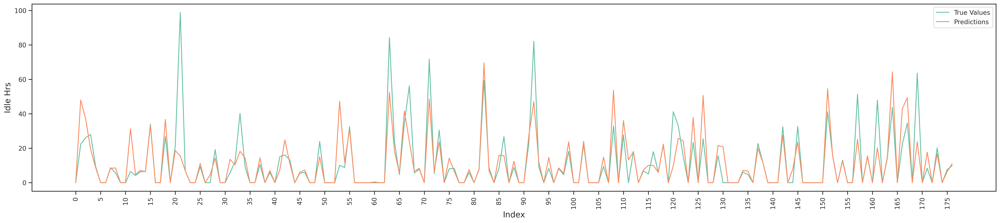

In [ ]:
import matplotlib.pyplot as plt
plt.figure(figsize=(30, 6))
plt.plot(y_test, label='True Values')
plt.plot(y_pred, label='Predictions')
# plt.plot((X_test['Quantity_Norms']*7.974324+8.175745), label = 'Quantity_Norms')

x_tick_indices = np.arange(0, len(y_test), 5)
plt.xticks(x_tick_indices, x_tick_indices, rotation=90)


plt.xlabel('Index',size = 14)
plt.ylabel('Idle Hrs',size = 14)
plt.legend()
plt.show()

In [ ]:
# pred = pd.DataFrame(y_pred)
# pred.index = y_test.index
# pred = pred.rename(columns={0: 'Idle Hrs'})

In [ ]:
# error = y_test - pred

In [ ]:

# import matplotlib.pyplot as plt
# plt.figure(figsize=(30, 6))

# plt.plot(error, label='Prediction Error')
# # plt.plot(y_test, label='Actual Service Hrs')
# # plt.plot((46.460283+error), label='Fluctuation')
# # plt.plot((X_test['Quantity_Norms']*7.974324+8.175745), label = 'Quantity_Norms')
# plt.axhline(y=0, color='black', linestyle='--')
# x_tick_indices = np.arange(0, len(y_test), 5)
# plt.xticks(x_tick_indices, x_tick_indices, rotation=90)


# # plt.xlabel('Index',size = 14)
# plt.ylabel('Error Idle',size = 14)
# plt.legend()
# plt.show()

## Service Time prediction 2

In [ ]:
X_train, X_test, y_train, y_test = train_test_split(X5, y5, test_size=0.2, random_state=42)
# define dataset
# X, y = make_regression(n_samples=1000, n_features=20, n_informative=15, noise=0.1, random_state=2)
# define the model
model = RandomForestRegressor()
# evaluate the model
cv = RepeatedKFold(n_splits=10, n_repeats=20, random_state=1)
n_scores = cross_val_score(model, X_train, y_train, scoring='neg_mean_absolute_error', cv=cv, n_jobs=-1, error_score='raise')
# report performance
print('MAE: %.3f (%.3f)' % (mean(n_scores), std(n_scores)))

MAE: -7.537 (1.345)


In [ ]:
model.fit(X_train, y_train)
y_pred = model.predict(X_test)

importances = model.feature_importances_

# create a pandas dataframe with the feature names and their importances
feature_importances = pd.DataFrame({'Feature': X_train.columns, 'Importance': importances})

# sort the dataframe by importances in descending order
feature_importances = feature_importances.sort_values('Importance', ascending=False)

# print the top 10 features
print(feature_importances.head(25))

/usr/local/lib/python3.8/dist-packages/sklearn/utils/validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['int', 'str']. An error will be raised in 1.2.
  warnings.warn(
<ipython-input-190-78b34617d813>:1: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  model.fit(X_train, y_train)


                                Feature  Importance
11                       Quantity_Norms    0.352261
33             SHIP_OPERATION_TYPE_Both    0.312020
0                            BEAM_METER    0.037415
3                             DRAFT_FWD    0.029674
5                                GRT_MT    0.025266
67                              14(CJI)    0.021994
4                                DWT_MT    0.021075
57                                    2    0.019811
21                   C/B/DB/DC/L_HYBRID    0.018736
13                            month_sin    0.014836
10                               NRT_MT    0.014799
12                            month_cos    0.013824
56                                    1    0.013059
2                             DRAFT_AFT    0.012914
9                             LOA_METER    0.011648
23                      C/B/DB/DC/L_LOJ    0.011552
68                               15(OJ)    0.010843
61                                    6    0.006853
59          

/usr/local/lib/python3.8/dist-packages/sklearn/utils/validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['int', 'str']. An error will be raised in 1.2.
  warnings.warn(


In [ ]:
model.fit(X_train, y_train)
y_pred = model.predict(X_test)

# import matplotlib.pyplot as plt

# plt.scatter(y_test, y_pred)
# plt.xlabel('True Values',size = 10)
# plt.ylabel('Predictions',size=10)
# plt.show()

/usr/local/lib/python3.8/dist-packages/sklearn/utils/validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['int', 'str']. An error will be raised in 1.2.
  warnings.warn(
<ipython-input-191-099e096c956b>:1: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  model.fit(X_train, y_train)
/usr/local/lib/python3.8/dist-packages/sklearn/utils/validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['int', 'str']. An error will be raised in 1.2.
  warnings.warn(


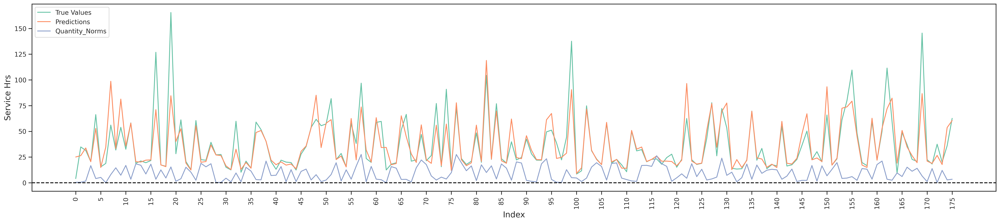

In [ ]:
import matplotlib.pyplot as plt
plt.figure(figsize=(30, 6))
plt.plot(y_test, label='True Values')
plt.plot(y_pred, label='Predictions')
# plt.plot(((X_test['Quantity_Norms']*7.974324+8.175745)), label = 'Quantity_Norms')
plt.axhline(y=0, color='black', linestyle='--')
x_tick_indices = np.arange(0, len(y_test), 5)
plt.xticks(x_tick_indices, x_tick_indices, rotation=90)


plt.xlabel('Index',size = 14)
plt.ylabel('Service Hrs',size = 14)
plt.legend()
plt.show()

In [ ]:
# pred = pd.DataFrame(y_pred)
# pred.index = y_test.index
# pred = pred.rename(columns={0: 'Service Hours in particular berth'})

In [ ]:
# error = y_test - pred

In [ ]:

# import matplotlib.pyplot as plt
# plt.figure(figsize=(30, 6))

# plt.plot(error, label='Prediction Error')
# # plt.plot(y_test, label='Actual Service Hrs')
# # plt.plot((46.460283+error), label='Fluctuation')
# # plt.plot((X_test['Quantity_Norms']*7.974324+8.175745), label = 'Quantity_Norms')
# plt.axhline(y=0, color='black', linestyle='--')
# x_tick_indices = np.arange(0, len(y_test), 5)
# plt.xticks(x_tick_indices, x_tick_indices, rotation=90)


# # plt.xlabel('Index',size = 14)
# plt.ylabel('Error in Service Hrs',size = 14)
# plt.legend()
# plt.show()

## Idle Hrs 2

In [ ]:
X_train, X_test, y_train, y_test = train_test_split(X4, y4, test_size=0.2, random_state=42)
# define dataset
# X, y = make_regression(n_samples=1000, n_features=20, n_informative=15, noise=0.1, random_state=2)
# define the model
model = RandomForestRegressor()
# evaluate the model
cv = RepeatedKFold(n_splits=10, n_repeats=20, random_state=1)
n_scores = cross_val_score(model, X_train, y_train, scoring='neg_mean_absolute_error', cv=cv, n_jobs=-1, error_score='raise')
# report performance
print('MAE: %.3f (%.3f)' % (mean(n_scores), std(n_scores)))

MAE: -4.043 (0.997)


In [ ]:
model.fit(X_train, y_train)
y_pred = model.predict(X_test)

/usr/local/lib/python3.8/dist-packages/sklearn/utils/validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['int', 'str']. An error will be raised in 1.2.
  warnings.warn(
<ipython-input-197-00d4b3251fd2>:1: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  model.fit(X_train, y_train)
/usr/local/lib/python3.8/dist-packages/sklearn/utils/validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['int', 'str']. An error will be raised in 1.2.
  warnings.warn(


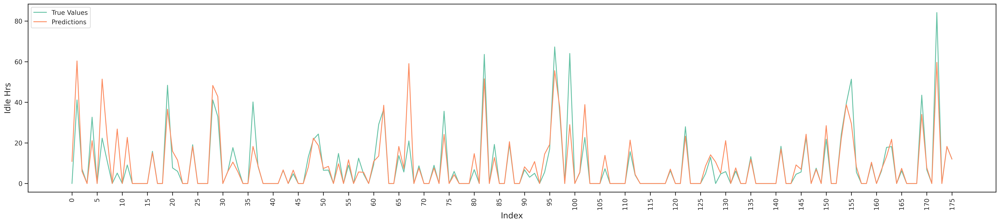

In [ ]:
import matplotlib.pyplot as plt
plt.figure(figsize=(30, 6))
plt.plot(y_test, label='True Values')
plt.plot(y_pred, label='Predictions')

# plt.plot((X_test['Quantity_Norms']*7.974324+8.175745), label = 'Quantity_Norms')
plt.plot(y_test, label='True Values', marker='o')  # Add marker='o' for circular markers
plt.plot(y_pred, label='Predictions', marker='o')  # Add marker='o' for circular markers

x_tick_indices = np.arange(0, len(y_test), 5)
plt.xticks(x_tick_indices, x_tick_indices, rotation=90)


plt.xlabel('Vessel Index',size = 14)
plt.ylabel('Idle Hrs',size = 14)
plt.legend()
plt.show()

In [ ]:
model.fit(X_train, y_train)
y_pred = model.predict(X_test)

importances = model.feature_importances_

# create a pandas dataframe with the feature names and their importances
feature_importances = pd.DataFrame({'Feature': X_train.columns, 'Importance': importances})

# sort the dataframe by importances in descending order
feature_importances = feature_importances.sort_values('Importance', ascending=False)

# print the top 10 features
print(feature_importances.head(25))

/usr/local/lib/python3.8/dist-packages/sklearn/utils/validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['int', 'str']. An error will be raised in 1.2.
  warnings.warn(
<ipython-input-199-78b34617d813>:1: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  model.fit(X_train, y_train)


                       Feature  Importance
34  SHIP_OPERATION_TYPE_Export    0.318701
18               C/B/DB/DC/L_C    0.075262
33    SHIP_OPERATION_TYPE_Both    0.071542
11              Quantity_Norms    0.069487
10                      NRT_MT    0.049770
3                    DRAFT_FWD    0.037749
35  SHIP_OPERATION_TYPE_Import    0.036497
67                     14(CJI)    0.036058
5                       GRT_MT    0.032180
9                    LOA_METER    0.029019
4                       DWT_MT    0.025082
19              C/B/DB/DC/L_DC    0.024947
12                   month_cos    0.024300
2                    DRAFT_AFT    0.021639
13                   month_sin    0.020555
58                           3    0.017923
0                   BEAM_METER    0.014451
16               C/B/DB/DC/L_B    0.014286
56                           1    0.008382
31                ASSESSED_Yes    0.007323
27                    MT_MV_MV    0.006921
22              C/B/DB/DC/L_LB    0.006136
14         

/usr/local/lib/python3.8/dist-packages/sklearn/utils/validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['int', 'str']. An error will be raised in 1.2.
  warnings.warn(


In [ ]:
# pred = pd.DataFrame(y_pred)
# pred.index = y_test.index
# pred = pred.rename(columns={0: 'Idle Hrs'})

In [ ]:
# error = y_test - pred

In [ ]:

# import matplotlib.pyplot as plt
# plt.figure(figsize=(30, 6))

# plt.plot(error, label='Prediction Error')
# # plt.plot(y_test, label='Actual Service Hrs')
# # plt.plot((46.460283+error), label='Fluctuation')
# # plt.plot((X_test['Quantity_Norms']*7.974324+8.175745), label = 'Quantity_Norms')
# plt.axhline(y=0, color='black', linestyle='--')
# x_tick_indices = np.arange(0, len(y_test), 5)
# plt.xticks(x_tick_indices, x_tick_indices, rotation=90)


# # plt.xlabel('Index',size = 14)
# plt.ylabel('Error Idle',size = 14)
# plt.legend()
# plt.show()

In [ ]:
# from sklearn.metrics import mean_absolute_error
# mean_absolute_error(y_test, y_pred)